**last update: 07/20/2024**  

This notebook is for Bayesian Gaussian process regression test.

Dataset: SOI(Pacific Southern Oscillation Index, for ENSO) 1875 -2024. Annual mean.

Design: Test different kernels with ENSO index and give evaluations. Especially for some basic kernels in sklearn.

# Package

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, Matern, RationalQuadratic, DotProduct
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from bayes_opt import BayesianOptimization, UtilityFunction
from properscoring import crps_gaussian
from tqdm import tqdm

# Data

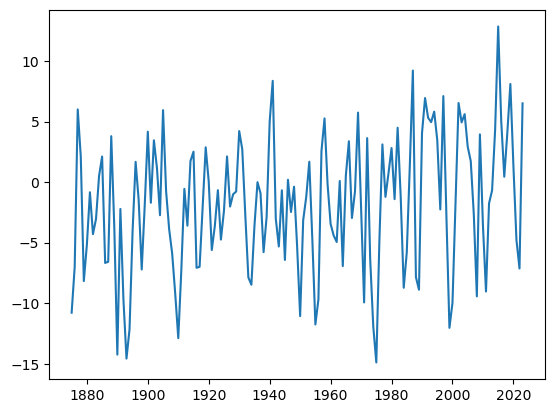

In [16]:
enso = pd.read_excel('../data/ENSO/ENSO_index_yearly.xlsx')
enso_data = pd.read_excel('../data/ENSO/ENSO_index_yearly.xlsx')
enso=enso.set_index('Year')
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values
plt.plot(enso)

# Period Analysis

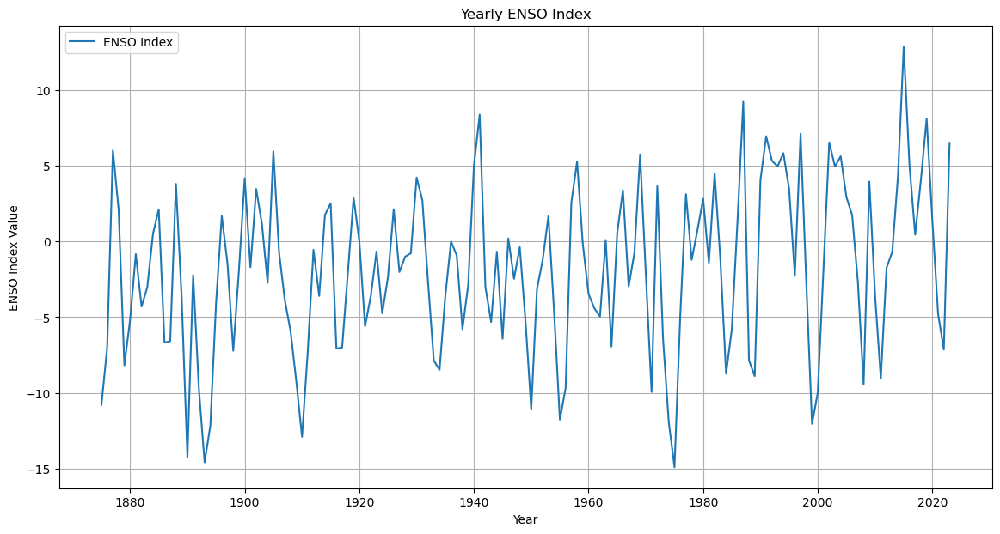

<Figure size 1400x700 with 0 Axes>

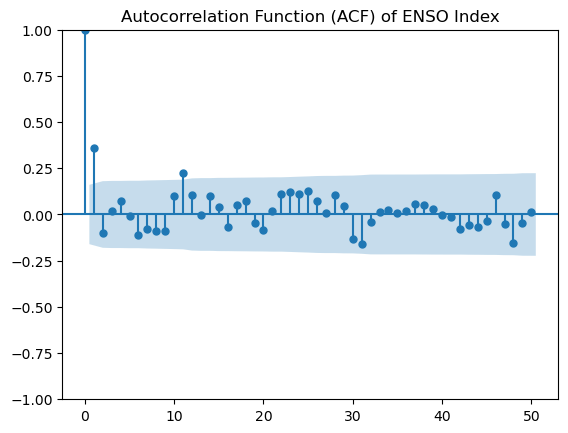

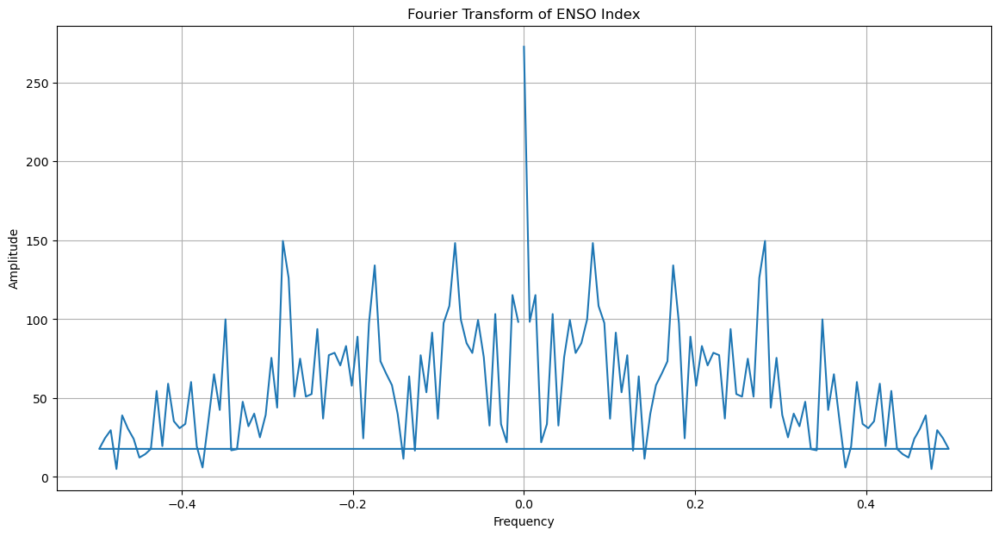

In [15]:
plt.figure(figsize=(14, 7))
plt.plot(enso_data['Year'], enso_data['Value'], label='ENSO Index')
plt.xlabel('Year')
plt.ylabel('ENSO Index Value')
plt.title('Yearly ENSO Index')
plt.legend()
plt.grid(True)
plt.show()

# Autocorrelation Function (ACF) Plot
plt.figure(figsize=(14, 7))
plt.title('Autocorrelation Function (ACF) of ENSO Index')
plt.show()

# Fourier Transform
enso_values = enso_data['Value'].values
fft_values = np.fft.fft(enso_values)
fft_freqs = np.fft.fftfreq(len(enso_values))

# Plot the Fourier Transform results
plt.figure(figsize=(14, 7))
plt.plot(fft_freqs, np.abs(fft_values))
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.title('Fourier Transform of ENSO Index')
plt.grid(True)
plt.show()


In [5]:
# Calculate ACF values
acf_values = acf(enso_values, nlags=50)
dominant_acf_lag = np.argmax(acf_values[1:]) + 1  # exclude the zero lag

# Calculate the dominant period using FFT
fft_amplitudes = np.abs(fft_values)
dominant_fft_freq = fft_freqs[np.argmax(fft_amplitudes[1:]) + 1]  # exclude the zero frequency
dominant_fft_period = 1 / dominant_fft_freq

# Calculate the dominant period using Power Spectral Density (PSD)
frequencies, psd_values = periodogram(enso_values)
dominant_psd_freq = frequencies[np.argmax(psd_values[1:]) + 1]  # exclude the zero frequency
dominant_psd_period = 1 / dominant_psd_freq

# Wavelet Transform
wavelet = 'cmor'
scales = np.arange(1, 128)
coefficients, frequencies = pywt.cwt(enso_values, scales, wavelet)
power = (abs(coefficients)) ** 2
periods = 1 / frequencies
dominant_wavelet_period = periods[np.argmax(power.mean(axis=1))]

# Display the results
results = pd.DataFrame({
    'Method': ['ACF', 'FFT', 'PSD', 'Wavelet'],
    'Dominant Period': [dominant_acf_lag, dominant_fft_period, dominant_psd_period, dominant_wavelet_period]
})

results


d:\APPsetup\anaconda\envs\rd\lib\site-packages\pywt\_cwt.py:121: FutureWarning: Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).
  wavelet = DiscreteContinuousWavelet(wavelet)


,Method,Dominant Period
0,ACF,1.000000
1,FFT,3.547619
2,PSD,3.547619
3,Wavelet,254.000000


d:\APPsetup\anaconda\envs\rd\lib\site-packages\pywt\_cwt.py:121: FutureWarning: Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).
  wavelet = DiscreteContinuousWavelet(wavelet)


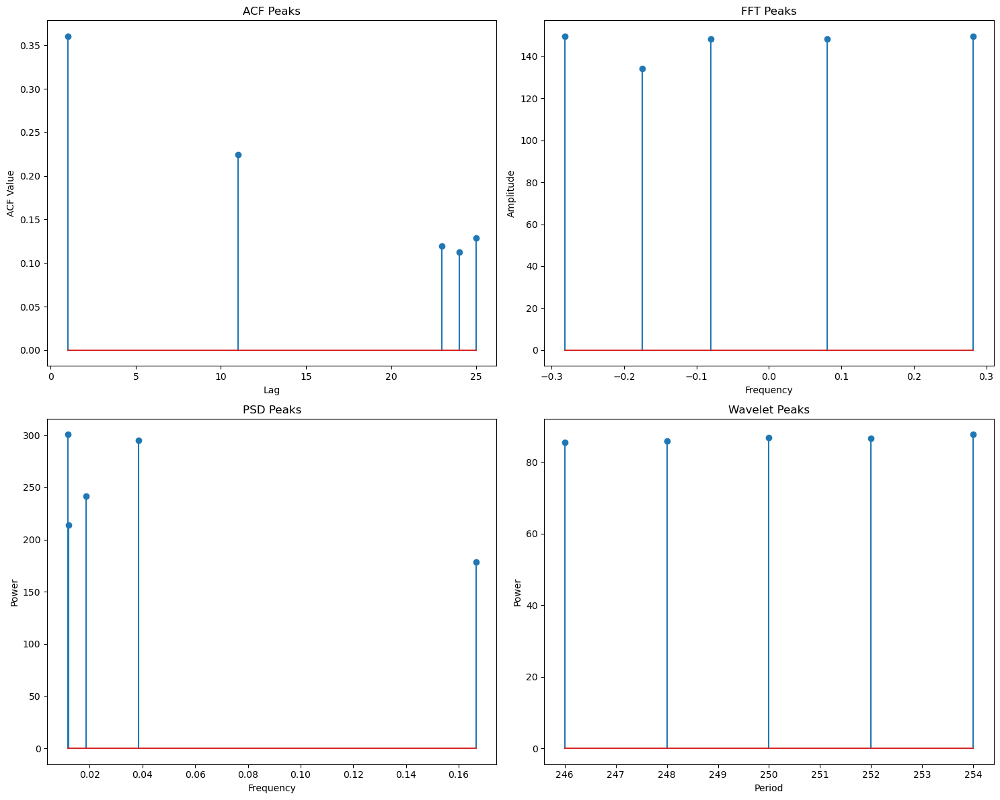

In [6]:
# Calculate multiple dominant periods using ACF
acf_values = acf(enso_values, nlags=100)
acf_peaks = np.argsort(acf_values[1:])[-5:] + 1  # top 5 peaks, exclude the zero lag

# Calculate multiple dominant periods using FFT
fft_amplitudes = np.abs(fft_values)
fft_peak_indices = np.argsort(fft_amplitudes[1:])[-5:] + 1  # top 5 peaks, exclude the zero frequency
fft_periods = 1 / fft_freqs[fft_peak_indices]

# Calculate multiple dominant periods using Power Spectral Density (PSD)
frequencies, psd_values = periodogram(enso_values)
psd_peak_indices = np.argsort(psd_values[1:])[-5:] + 1  # top 5 peaks, exclude the zero frequency
psd_periods = 1 / frequencies[psd_peak_indices]

# Wavelet Transform for multiple dominant periods
wavelet = 'cmor'
scales = np.arange(1, 128)
coefficients, frequencies = pywt.cwt(enso_values, scales, wavelet)
power = (abs(coefficients)) ** 2
mean_power = power.mean(axis=1)
wavelet_peak_indices = np.argsort(mean_power)[-5:]  # top 5 peaks
wavelet_periods = 1 / frequencies[wavelet_peak_indices]

# Display the results
periods_data = {
    'ACF Periods': acf_peaks,
    'FFT Periods': fft_periods,
    'PSD Periods': psd_periods,
    'Wavelet Periods': wavelet_periods
}
periods_df = pd.DataFrame(periods_data)


# Plotting the results
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# ACF plot
axes[0, 0].stem(acf_peaks, acf_values[acf_peaks])
axes[0, 0].set_title('ACF Peaks')
axes[0, 0].set_xlabel('Lag')
axes[0, 0].set_ylabel('ACF Value')

# FFT plot
axes[0, 1].stem(fft_freqs[fft_peak_indices], fft_amplitudes[fft_peak_indices])
axes[0, 1].set_title('FFT Peaks')
axes[0, 1].set_xlabel('Frequency')
axes[0, 1].set_ylabel('Amplitude')

# PSD plot
axes[1, 0].stem(frequencies[psd_peak_indices], psd_values[psd_peak_indices])
axes[1, 0].set_title('PSD Peaks')
axes[1, 0].set_xlabel('Frequency')
axes[1, 0].set_ylabel('Power')

# Wavelet plot
axes[1, 1].stem(wavelet_periods, mean_power[wavelet_peak_indices])
axes[1, 1].set_title('Wavelet Peaks')
axes[1, 1].set_xlabel('Period')
axes[1, 1].set_ylabel('Power')

plt.tight_layout()
plt.show()



In [7]:
periods_df

,ACF Periods,FFT Periods,PSD Periods,Wavelet Periods
0,24,-5.730769,74.500000,246.0
1,23,-12.416667,3.634146,248.0
2,25,12.416667,5.730769,252.0
3,11,-3.547619,12.416667,250.0
4,1,3.547619,3.547619,254.0


In [8]:
# Filter FFT results to only consider positive frequencies
positive_fft_freqs = fft_freqs[fft_freqs > 0]
positive_fft_amplitudes = fft_amplitudes[fft_freqs > 0]
positive_fft_peak_indices = np.argsort(positive_fft_amplitudes)[-5:]  # top 5 peaks

positive_fft_periods = 1 / positive_fft_freqs[positive_fft_peak_indices]

# Update the results DataFrame
periods_data_updated = {
    'ACF Periods': acf_peaks,
    'FFT Periods': positive_fft_periods,
    'PSD Periods': psd_periods,
    'Wavelet Periods': wavelet_periods
}
periods_df_updated = pd.DataFrame(periods_data_updated)

periods_df_updated


,ACF Periods,FFT Periods,PSD Periods,Wavelet Periods
0,24,74.500000,74.500000,246.0
1,23,3.634146,3.634146,248.0
2,25,5.730769,5.730769,252.0
3,11,12.416667,12.416667,250.0
4,1,3.547619,3.547619,254.0


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


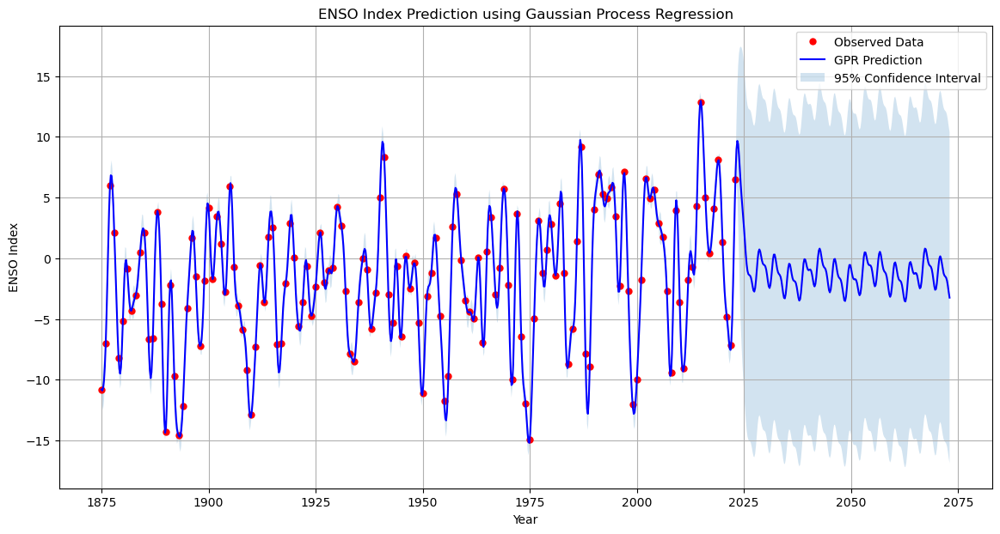

In [9]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, ExpSineSquared
import numpy as np

# Prepare the data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the kernel with periodic components (3-6 years and 10-13 years)
kernel = C(1.0, (1e-3, 1e3)) * ExpSineSquared(length_scale=1.0, periodicity=4.5, length_scale_bounds=(1.0, 10.0), periodicity_bounds=(3.0, 6.0)) \
         + C(1.0, (1e-3, 1e3)) * ExpSineSquared(length_scale=1.0, periodicity=11.5, length_scale_bounds=(1.0, 15.0), periodicity_bounds=(10.0, 13.0)) \
         + C(1.0, (1e-3, 1e3)) * RBF(length_scale=1.0, length_scale_bounds=(1.0, 10.0))

# Fit the Gaussian Process model
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10)
gp.fit(X, y)

# Make predictions over a range of years
X_pred = np.linspace(X.min(), X.max() + 50, 1000).reshape(-1, 1)
y_pred, sigma = gp.predict(X_pred, return_std=True)

# Plot the results
plt.figure(figsize=(14, 7))
plt.plot(X, y, 'r.', markersize=10, label='Observed Data')
plt.plot(X_pred, y_pred, 'b-', label='GPR Prediction')
plt.fill_between(X_pred.ravel(), y_pred - 1.96 * sigma, y_pred + 1.96 * sigma, alpha=0.2, label='95% Confidence Interval')
plt.xlabel('Year')
plt.ylabel('ENSO Index')
plt.title('ENSO Index Prediction using Gaussian Process Regression')
plt.legend()
plt.grid(True)
plt.show()


# Kernel Trial and Error (eye-bowling)

## Function

In [1]:
def plot_gpr_samples(gpr_model, n_samples, X_range, ax):
    """Plot samples drawn from the Gaussian process model and the fitted data.
    
    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    X_range : tuple
        The range of X values to use for the prediction.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """
    X_pred = np.linspace(X_range[0], X_range[1], 1000).reshape(-1, 1)
    y_mean, y_std = gpr_model.predict(X_pred, return_std=True)
    y_samples = gpr_model.sample_y(X_pred, n_samples)

    # Plot the original data points and the fitted curve
    ax.plot(X, y, 'orange', label='Observed Data')
    ax.plot(X_pred, y_mean, color="black", label="Fitted Mean")

    for idx, single_prior in enumerate(y_samples.T):
        ax.plot(
            X_pred,
            single_prior,
            linestyle="--",
            alpha=0.7,
            label=f"Sampled function #{idx + 1}",
        )
    ax.fill_between(
        X_pred.ravel(),
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("Year")
    ax.set_ylabel("ENSO Index")
    ax.legend()
    ax.set_ylim([min(y_mean - y_std) - 5, max(y_mean + y_std) + 5])


In [2]:
def plot_gpr(gpr_model, X_range, ax):
    """Plot samples drawn from the Gaussian process model and the fitted data.
    
    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    X_range : tuple
        The range of X values to use for the prediction.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """
    X_pred = np.linspace(X_range[0], X_range[1], 1000).reshape(-1, 1)
    y_mean, y_std = gpr_model.predict(X_pred, return_std=True)

    # Plot the original data points and the fitted curve
    ax.plot(X, y, 'orange', label='Observed Data')
    ax.plot(X_pred, y_mean, color="black", label="Fitted Mean")

    ax.fill_between(
        X_pred.ravel(),
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("Year")
    ax.set_ylabel("ENSO Index")
    ax.legend()
    ax.set_ylim([min(y_mean - y_std) - 5, max(y_mean + y_std) + 5])

## RBF

### without noise

Optimized kernel: 5.94**2 * RBF(length_scale=0.841)


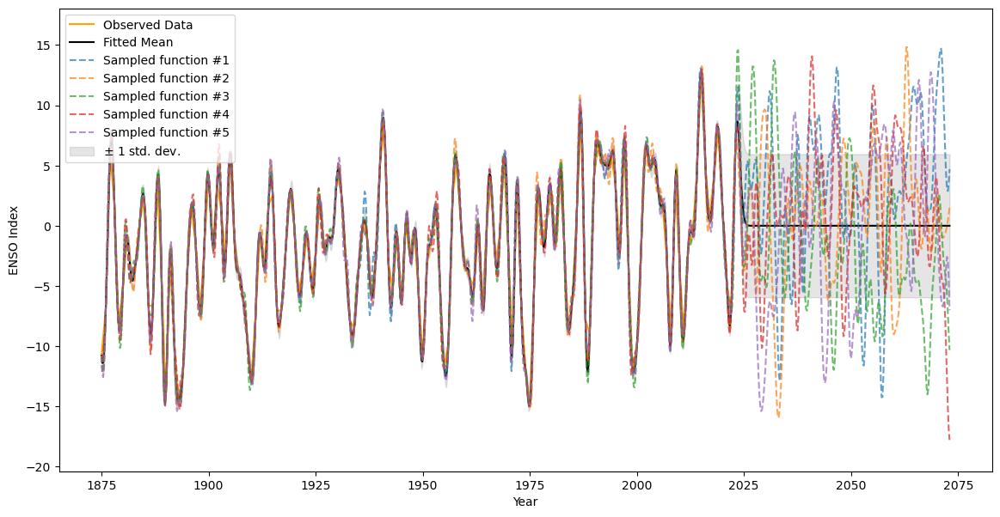

In [24]:
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the RBF kernel with initial parameters
kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))

# Fit the Gaussian Process model with parameter optimization
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e-10)
gp.fit(X, y)

# Print the optimized kernel parameters
print("Optimized kernel:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

### noise

Optimized kernel: 5.94**2 * RBF(length_scale=0.841)


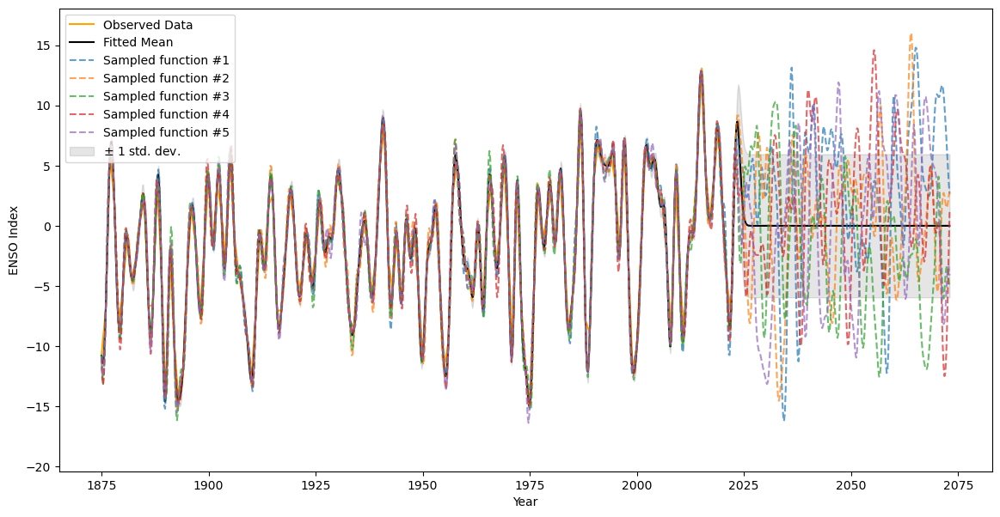

In [25]:
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the RBF kernel with adjusted initial parameters
kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=10.0, length_scale_bounds=(1e-2, 1e2))

# Fit the Gaussian Process model with parameter optimization
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e-2)
gp.fit(X, y)

# Print the optimized kernel parameters
print("Optimized kernel:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

## linear

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__constant_value is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized Linear kernel: DotProduct(sigma_0=57.7) + 31.6**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


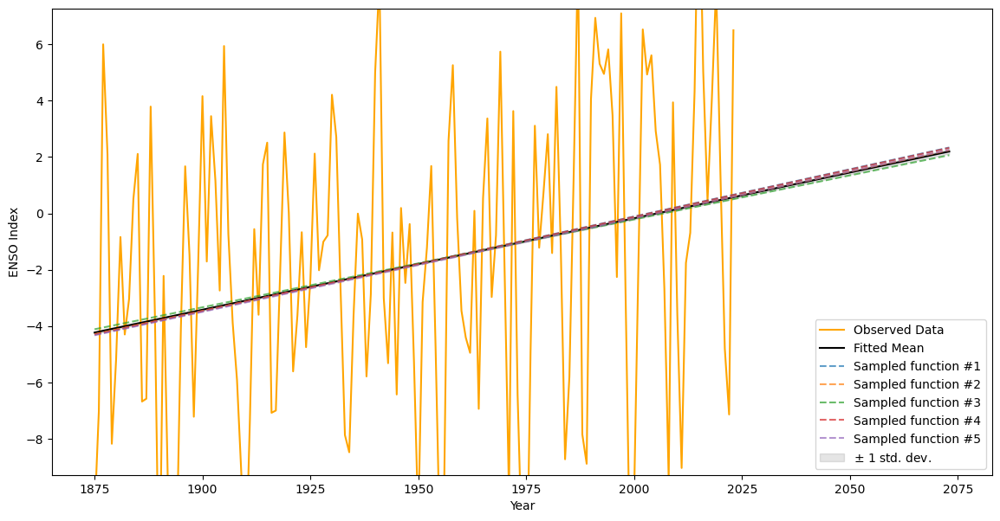

In [30]:
# Define the Linear kernel with noise term
kernel_linear = DotProduct() + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_linear = GaussianProcessRegressor(kernel=kernel_linear, n_restarts_optimizer=10, alpha=1e-1)
gp_linear.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Linear kernel:", gp_linear.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_linear, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


## Polynomial Kernel

Optimized Polynomial kernel: DotProduct(sigma_0=5.54e-05) ** 2 + 16.1**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


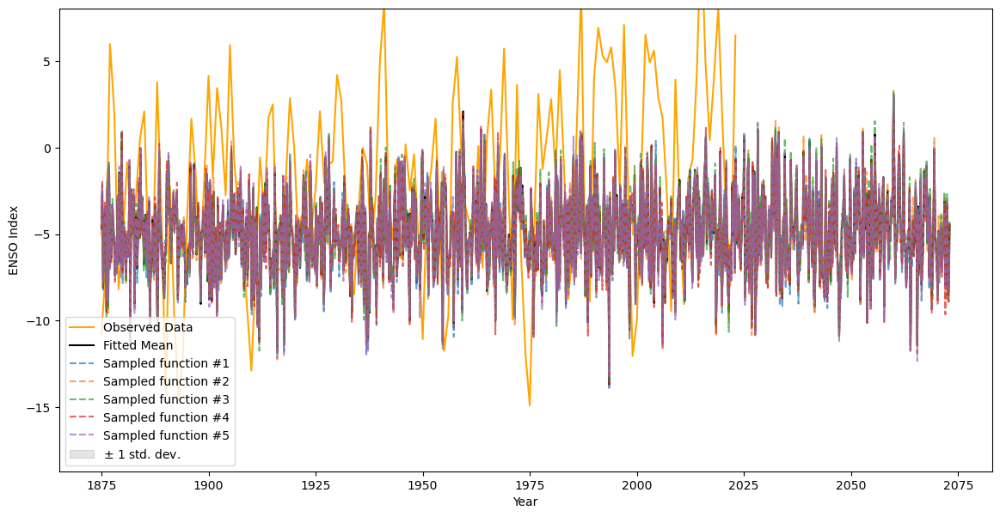

In [29]:
# Define the Polynomial kernel with noise term
kernel_poly = (DotProduct() ** 2) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_poly = GaussianProcessRegressor(kernel=kernel_poly, n_restarts_optimizer=10, alpha=1e-1)
gp_poly.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Polynomial kernel:", gp_poly.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_poly, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


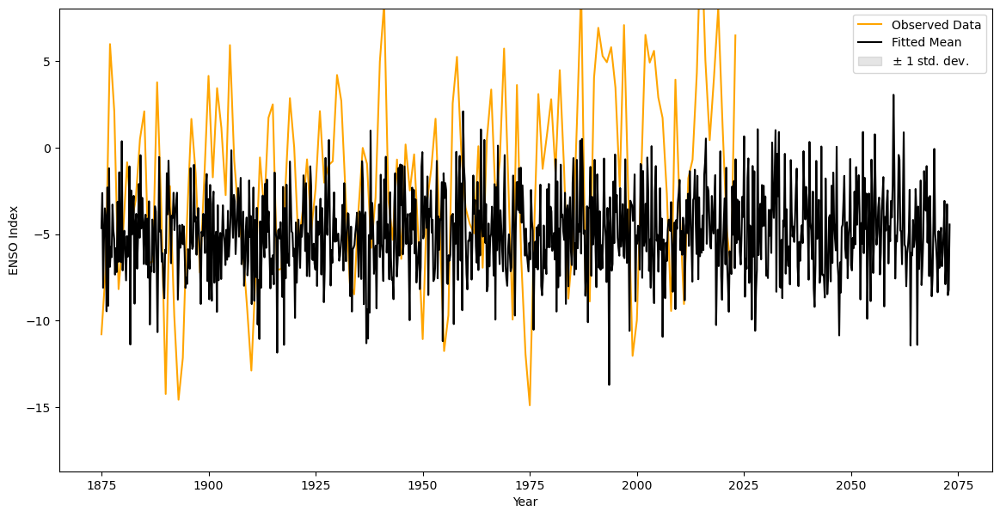

In [33]:
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr(gp_poly, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

## Matérn Kernel

Optimized Matérn kernel: Matern(length_scale=0.631, nu=1.5) + 1.83**2


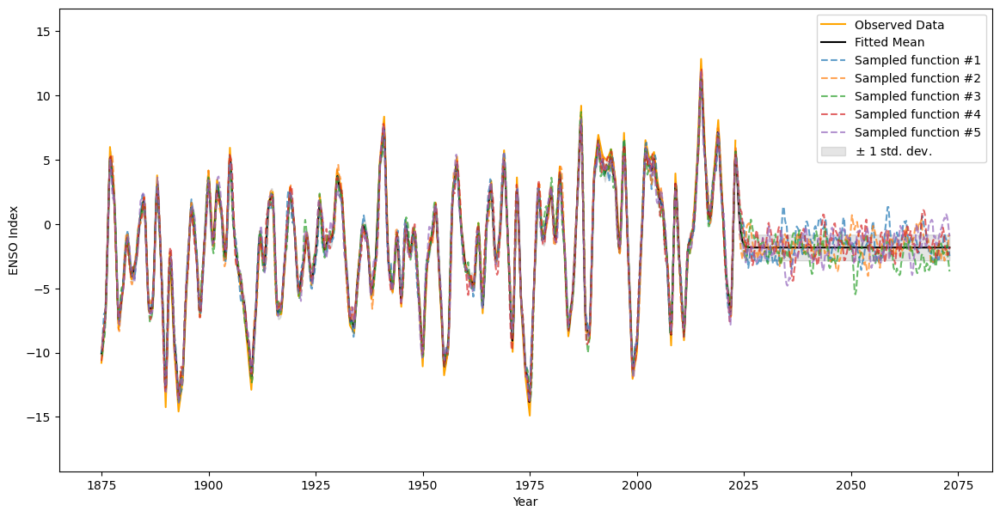

In [34]:
# Define the Matérn kernel with noise term
kernel_matern = Matern(length_scale=1.0, length_scale_bounds=(1e-2, 1e2), nu=1.5) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_matern = GaussianProcessRegressor(kernel=kernel_matern, n_restarts_optimizer=10, alpha=1e-1)
gp_matern.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Matérn kernel:", gp_matern.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_matern, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


## Exponential Kernel: 

Optimized Exponential kernel: Matern(length_scale=0.635, nu=0.5) + 1.83**2


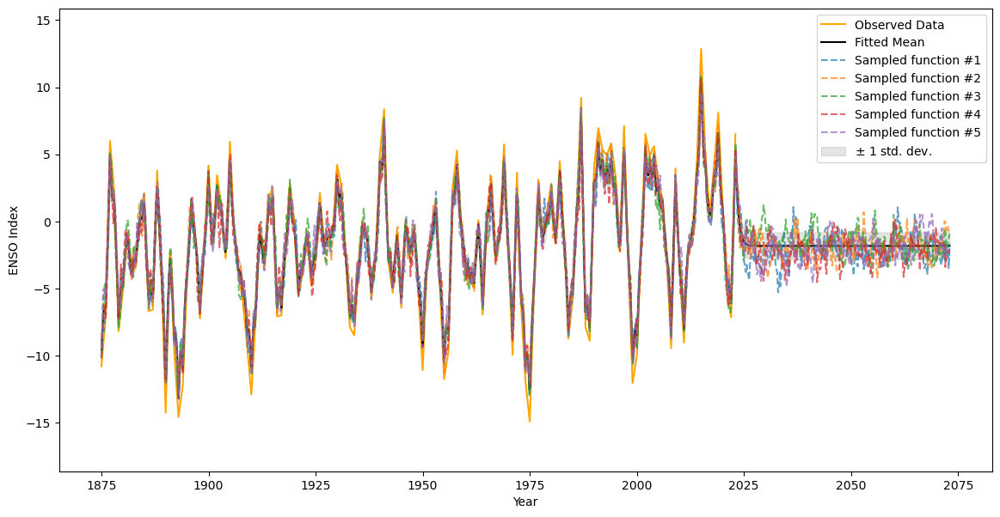

In [35]:
# Define the Exponential kernel with noise term
kernel_exp = Matern(length_scale=1.0, length_scale_bounds=(1e-2, 1e2), nu=0.5) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_exp = GaussianProcessRegressor(kernel=kernel_exp, n_restarts_optimizer=10, alpha=1e-1)
gp_exp.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Exponential kernel:", gp_exp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_exp, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


## γ-Exponential Kernel

Optimized γ-Exponential kernel: Matern(length_scale=0.628, nu=2.5) + 1.83**2


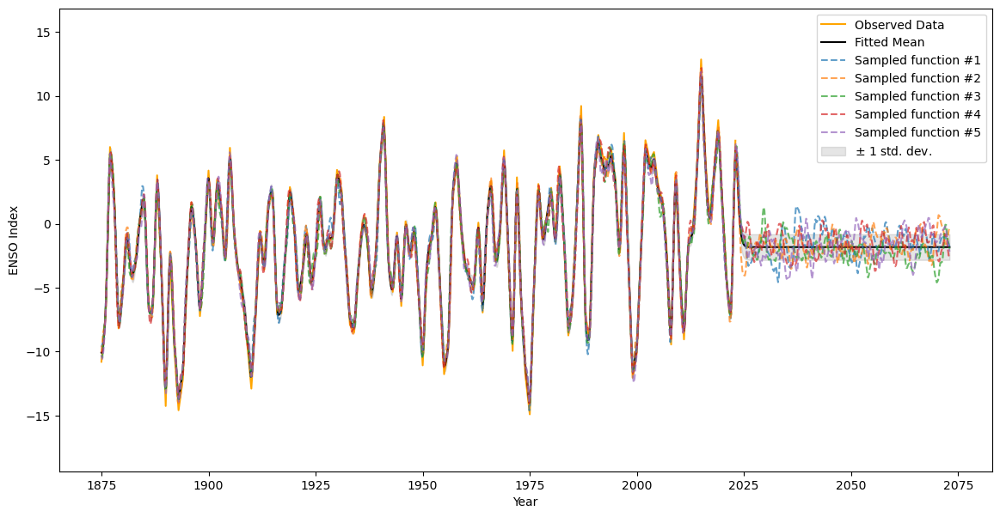

In [36]:
# Define the γ-Exponential kernel with noise term
kernel_gamma_exp = Matern(length_scale=1.0, length_scale_bounds=(1e-2, 1e2), nu=2.5) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_gamma_exp = GaussianProcessRegressor(kernel=kernel_gamma_exp, n_restarts_optimizer=10, alpha=1e-1)
gp_gamma_exp.fit(X, y)

# Print the optimized kernel parameters
print("Optimized γ-Exponential kernel:", gp_gamma_exp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_gamma_exp, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


## Rational Quadratic Kernel

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__alpha is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized Rational Quadratic kernel: RationalQuadratic(alpha=1e+05, length_scale=0.617) + 1.82**2


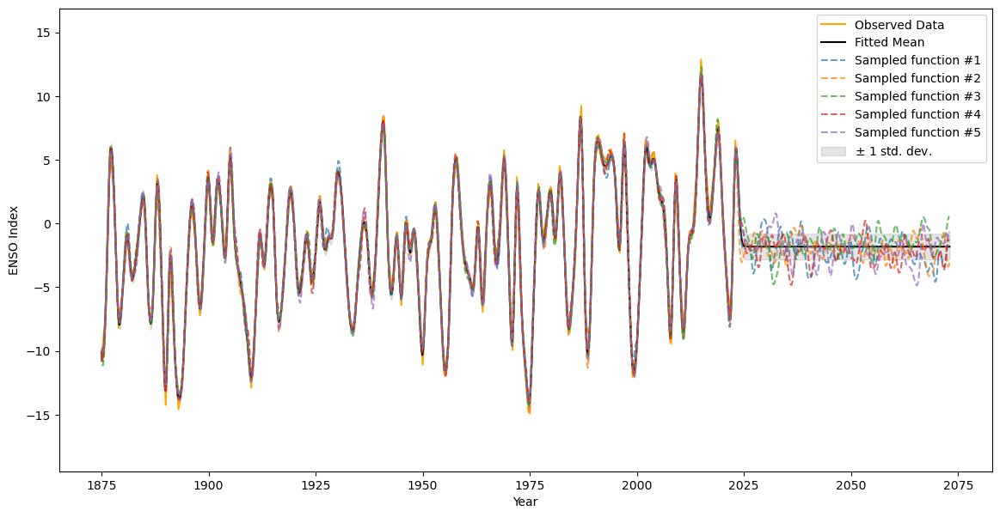

In [37]:
# Define the Rational Quadratic kernel with noise term
kernel_rq = RationalQuadratic(length_scale=1.0, alpha=0.1, length_scale_bounds=(1e-2, 1e2)) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_rq = GaussianProcessRegressor(kernel=kernel_rq, n_restarts_optimizer=10, alpha=1e-1)
gp_rq.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Rational Quadratic kernel:", gp_rq.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_rq, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

## Neural Network Kernel

Optimized Neural Network kernel: DotProduct(sigma_0=0.306) * RBF(length_scale=1.97) + 0.354**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


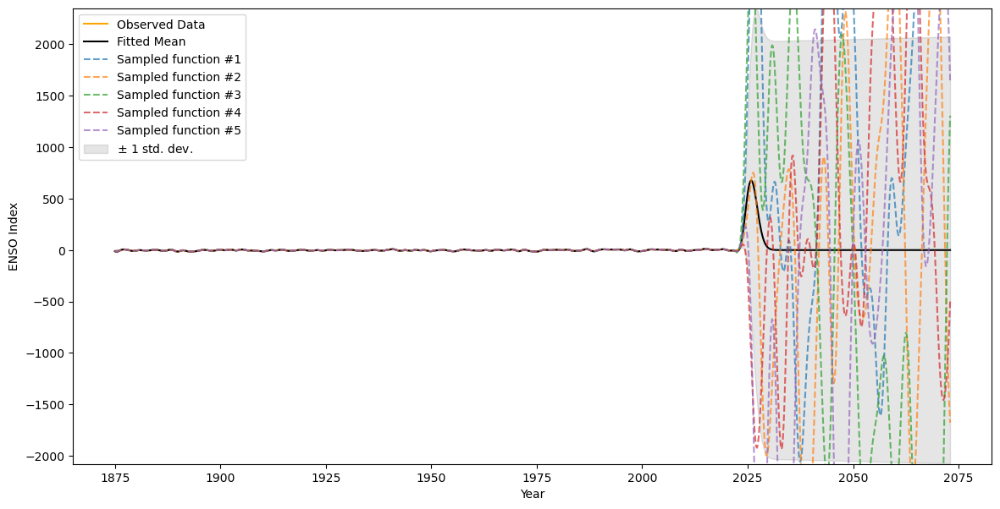

In [42]:
# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the Neural Network kernel with sigma_0 and length_scale as hyperparameters
kernel_nn = DotProduct(sigma_0=1.0, sigma_0_bounds=(1e-2, 1e2)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2)) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_nn = GaussianProcessRegressor(kernel=kernel_nn, n_restarts_optimizer=10, alpha=1e-1)
gp_nn.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Neural Network kernel:", gp_nn.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_nn, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


Optimized Neural Network kernel: DotProduct(sigma_0=0.0447) * RBF(length_scale=1.97) + 0.62**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


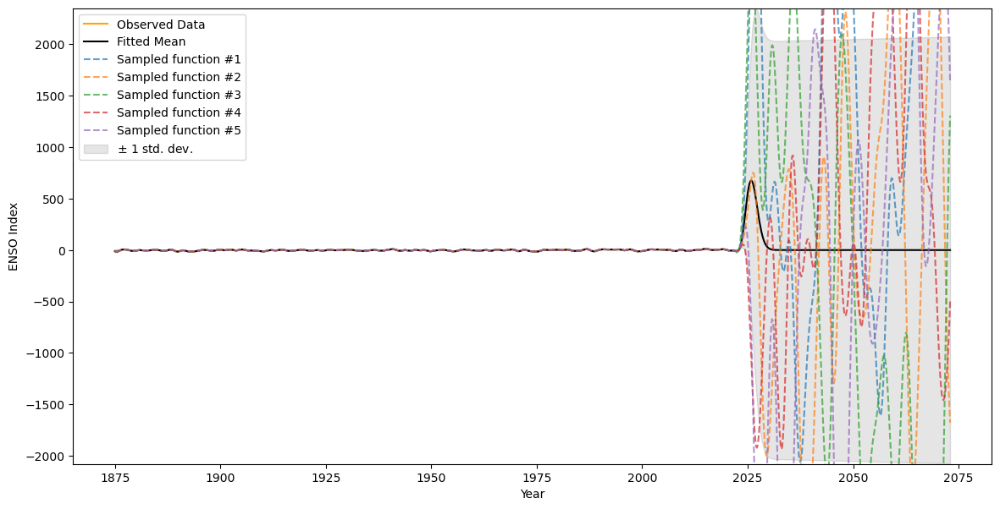

In [39]:
# Define the Neural Network kernel with noise term
kernel_nn = DotProduct(sigma_0=1.0) * RBF(length_scale=1.0) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_nn = GaussianProcessRegressor(kernel=kernel_nn, n_restarts_optimizer=10, alpha=1e-1)
gp_nn.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Neural Network kernel:", gp_nn.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_nn, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

## poly-periods(3-7,10-12)

Optimized Polynomial kernel with periodic components: DotProduct(sigma_0=0.00777) ** 2 + ExpSineSquared(length_scale=0.02, periodicity=6.42) + ExpSineSquared(length_scale=0.0104, periodicity=11.6) + 28**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


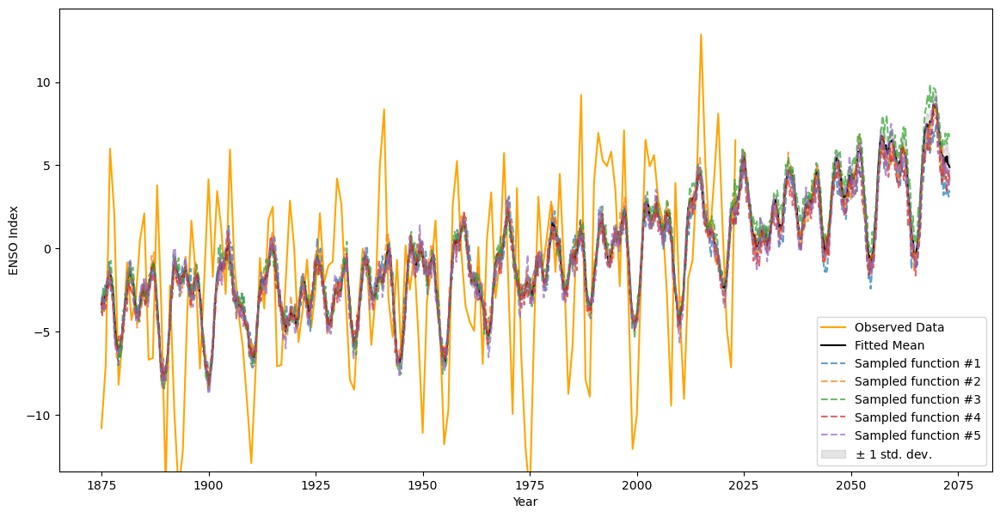

In [ ]:
kernel_poly = (DotProduct() ** 2) + \
              ExpSineSquared(length_scale=1.0, periodicity=5.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(3.0, 7.0)) + \
              ExpSineSquared(length_scale=1.0, periodicity=11.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(10.0, 12.0)) + \
              C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_poly = GaussianProcessRegressor(kernel=kernel_poly, n_restarts_optimizer=10, alpha=1e-1)
gp_poly.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Polynomial kernel with periodic components:", gp_poly.kernel_)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [period1_initial, period2_initial], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

Optimized Polynomial kernel with periodic components: DotProduct(sigma_0=0.0274) ** 2 + ExpSineSquared(length_scale=0.0243, periodicity=4.81) + ExpSineSquared(length_scale=0.0551, periodicity=11.4) + 0.0913**2


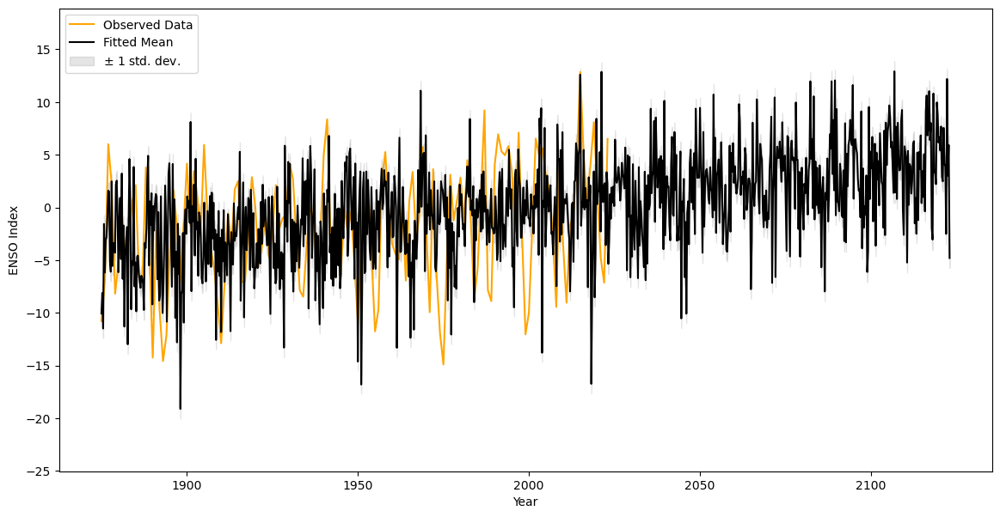

In [ ]:
kernel_poly = (DotProduct() ** 2) + \
              ExpSineSquared(length_scale=1.0, periodicity=5.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(3.0, 7.0)) + \
              ExpSineSquared(length_scale=1.0, periodicity=11.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(10.0, 12.0)) + \
              C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_poly = GaussianProcessRegressor(kernel=kernel_poly, n_restarts_optimizer=10, alpha=1e-1)
gp_poly.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Polynomial kernel with periodic components:", gp_poly.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr(gp_poly,  X_range=(X.min(), X.max() + 100), ax=ax)
plt.show()

# Periods

## poly + expsinsquared (3-7 & 10-12 yrs)

In [ ]:
def plot_gpr_samples(gpr_model, X, y, n_samples, X_range, ax):
    """Plot samples drawn from the Gaussian process model and the fitted data.
    
    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    X_range : tuple
        The range of X values to use for the prediction.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """
    X_pred = np.linspace(X_range[0], X_range[1], 1000).reshape(-1, 1)
    y_mean, y_std = gpr_model.predict(X_pred, return_std=True)
    y_samples = gpr_model.sample_y(X_pred, n_samples)

    # Plot the original data points and the fitted curve
    ax.plot(X, y, 'orange', label='Observed Data')
    ax.plot(X_pred, y_mean, color="black", label="Fitted Mean")

    for idx, single_prior in enumerate(y_samples.T):
        ax.plot(
            X_pred,
            single_prior,
            linestyle="--",
            alpha=0.7,
            label=f"Sampled function #{idx + 1}",
        )
    ax.fill_between(
        X_pred.ravel(),
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("Year")
    ax.set_ylabel("ENSO Index")
    ax.legend()
    ax.set_ylim([min(y_mean - y_std) - 5, max(y_mean + y_std) + 5])

Optimized Polynomial kernel with periodic components: DotProduct(sigma_0=0.000197) ** 2 + ExpSineSquared(length_scale=0.0223, periodicity=4.68) + ExpSineSquared(length_scale=0.0272, periodicity=10.6) + 0.511**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


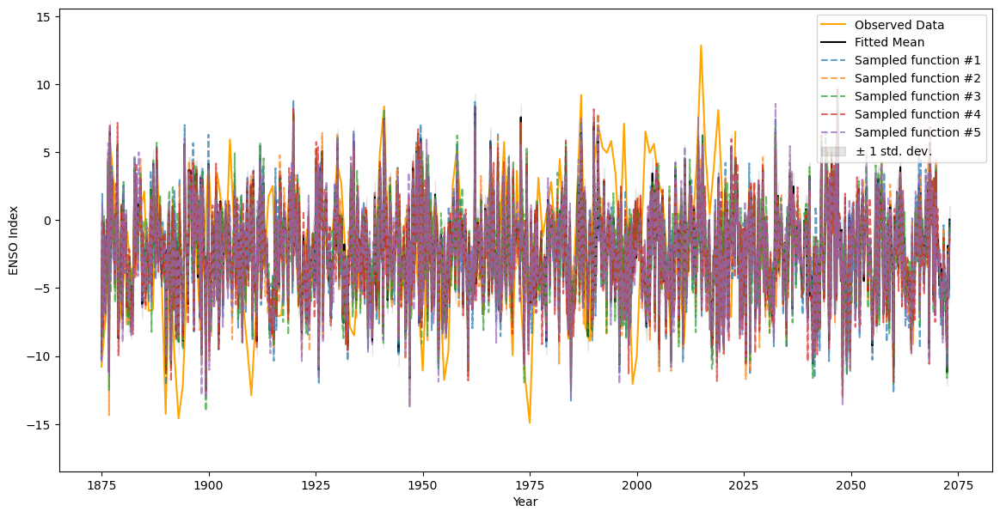

In [48]:
# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the Polynomial kernel with added periodic components
kernel_poly_periodic = (DotProduct() ** 2) + \
              ExpSineSquared(length_scale=1.0, periodicity=5.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(3.0, 7.0)) + \
              ExpSineSquared(length_scale=1.0, periodicity=11.0, length_scale_bounds=(1e-2, 1e2), periodicity_bounds=(10.0, 12.0)) + \
              C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp_poly_periodic = GaussianProcessRegressor(kernel=kernel_poly_periodic, n_restarts_optimizer=10, alpha=1e-1)
gp_poly_periodic.fit(X, y)

# Print the optimized kernel parameters
print("Optimized Polynomial kernel with periodic components:", gp_poly_periodic.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp_poly_periodic, X, y, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

## poly (3-7 & 10-12) periods

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


Optimized kernel with periodic components: DotProduct(sigma_0=2.29e+03) + 0.704**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


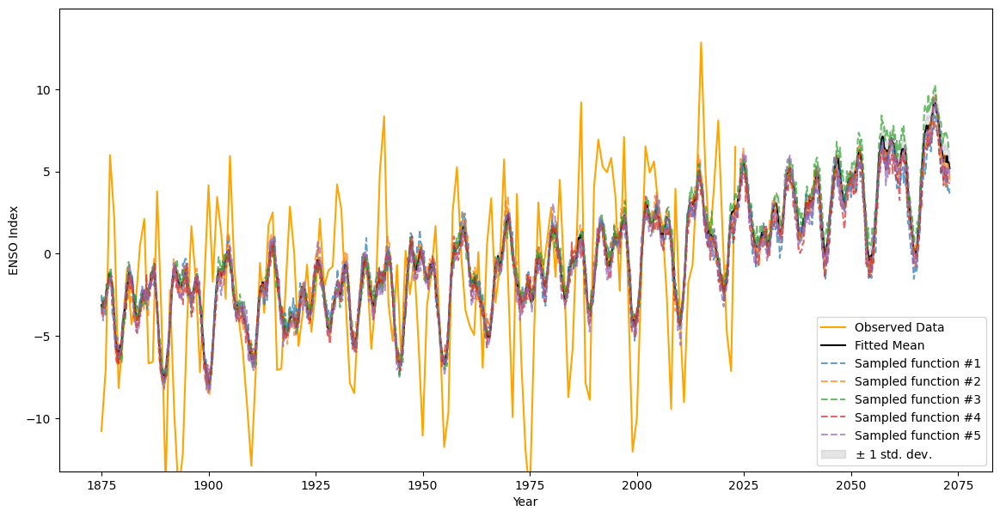

In [77]:
# Define the periods as parameters to be optimized
period1_bounds = (3.0, 7.0)
period2_bounds = (10.0, 12.0)

# Initial guesses for the periods
period1_initial = 5.0
period2_initial = 11.0

# Transform the input data to include periodic components
X_periodic = periodic_transform(X, [period1_initial, period2_initial])

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))

# Define the kernel with a noise term
kernel = DotProduct() + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability
gp.fit(X_poly, y)

# Print the optimized kernel parameters
print("Optimized kernel with periodic components:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [period1_initial, period2_initial], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


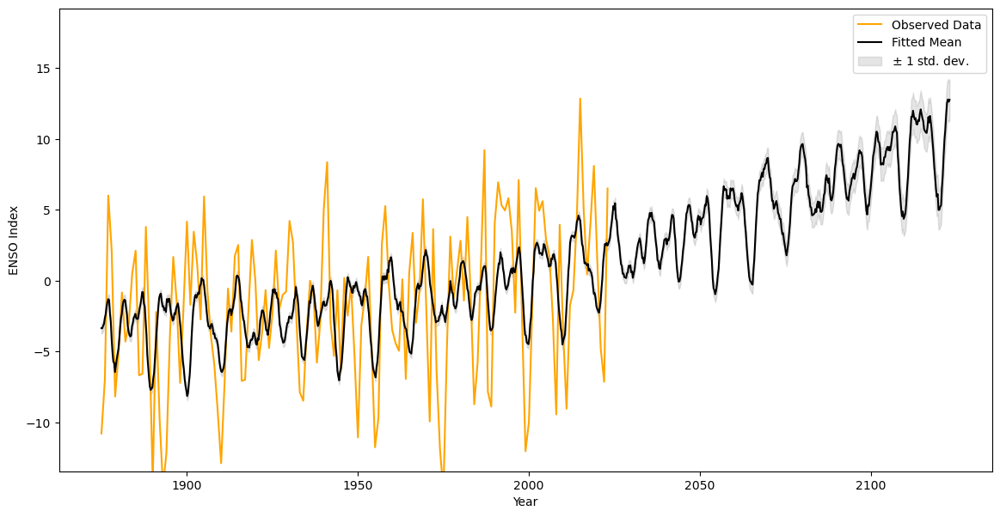

In [61]:
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [period1_initial, period2_initial], n_samples=0, X_range=(X.min(), X.max() + 100), ax=ax)
plt.show()

## poly (3-7 yrs)

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


Optimized kernel with periodic components: DotProduct(sigma_0=0.0103) + 5.42**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


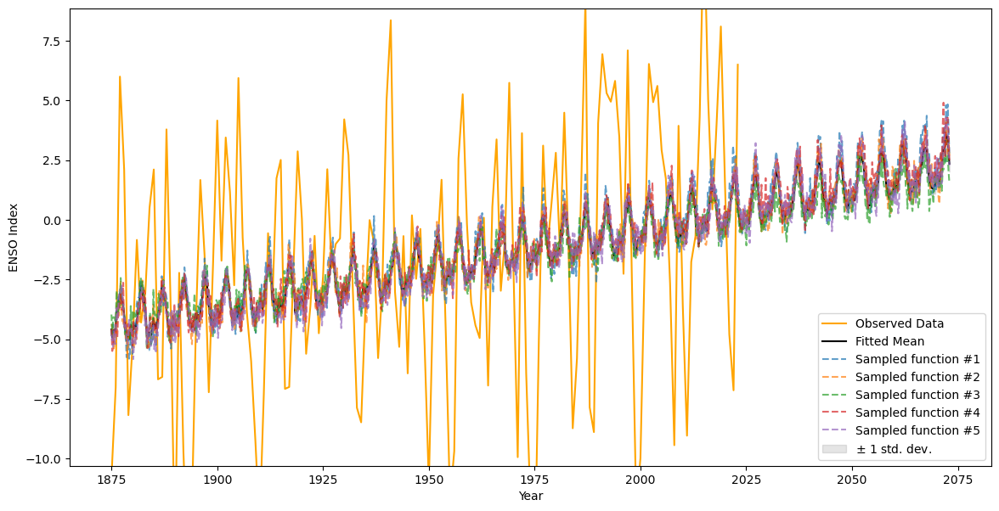

In [80]:
# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the period as a parameter to be optimized
period_bounds = (3.0, 7.0)

# Initial guess for the period
period_initial = 5.0

# Transform the input data to include periodic components
X_periodic = periodic_transform(X, period_initial)

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))

# Define the kernel with a noise term
kernel = DotProduct() + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability
gp.fit(X_poly, y)

# Print the optimized kernel parameters
print("Optimized kernel with periodic components:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, period_initial, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


### add coefficient for dot product

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel with periodic components: 0.0316**2 * DotProduct(sigma_0=0.459) + 1.03**2


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


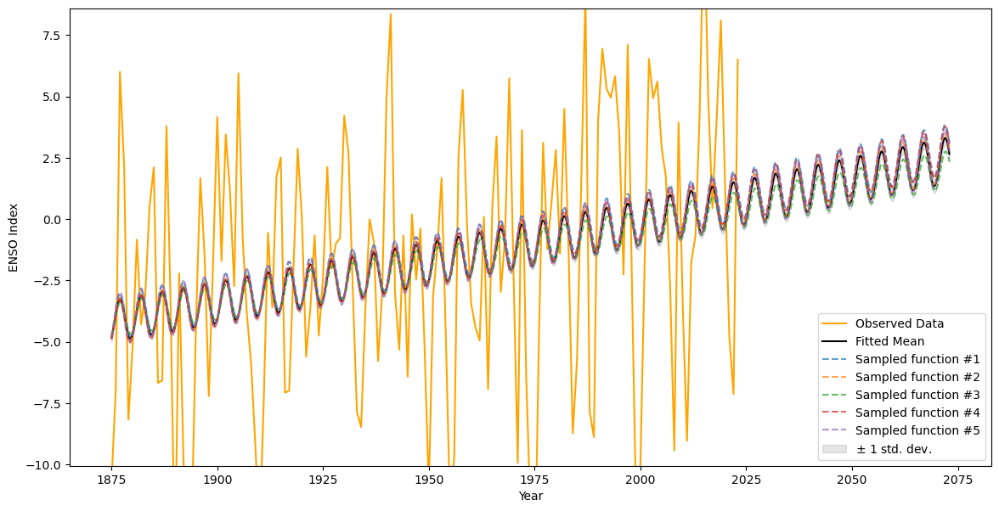

In [81]:
# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the period as a parameter to be optimized
period_bounds = (3.0, 7.0)

# Initial guess for the period
period_initial = 5.0

# Transform the input data to include periodic components
X_periodic = periodic_transform(X, period_initial)

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-3, 1e3)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability
gp.fit(X_poly, y)

# Print the optimized kernel parameters
print("Optimized kernel with periodic components:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, period_initial, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


### include RBF kernel

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel with periodic components: 0.316**2 * DotProduct(sigma_0=5.59) + 2.26**2 + RBF(length_scale=0.106)


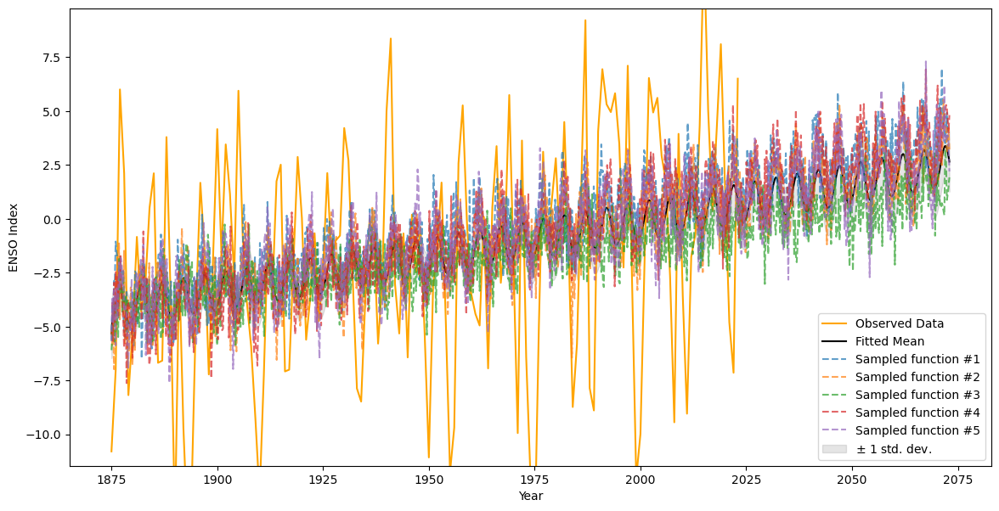

In [65]:
# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Define the period as a parameter to be optimized
period_bounds = (3.0, 7.0)

# Initial guess for the period
period_initial = 5.0

# Transform the input data to include periodic components
X_periodic = periodic_transform(X, period_initial)

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-1, 1e1)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3)) + RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))

# Fit the Gaussian Process model with parameter optimization, including noise term
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e1)  # Increase alpha for numerical stability
gp.fit(X_poly, y)

# Print the optimized kernel parameters
print("Optimized kernel with periodic components:", gp.kernel_)

# Create a plot
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, period_initial, n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


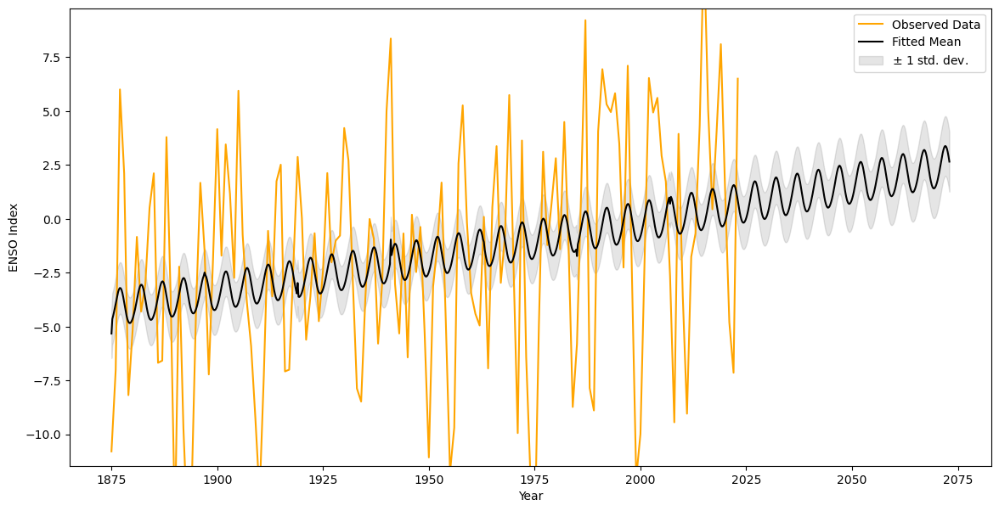

In [68]:
def plot_gpr(gpr_model, X, y, poly, period, X_range, ax):
    """Plot samples drawn from the Gaussian process model and the fitted data.
    
    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    X_range : tuple
        The range of X values to use for the prediction.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """

    X_pred = np.linspace(X_range[0], X_range[1], 1000).reshape(-1, 1)
    X_pred_periodic = periodic_transform(X_pred, period)
    X_pred_poly = poly.transform(np.hstack([X_pred, X_pred_periodic]))
    y_mean, y_std = gpr_model.predict(X_pred_poly, return_std=True)

    # Plot the original data points and the fitted curve
    ax.plot(X, y, 'orange', label='Observed Data')
    ax.plot(X_pred, y_mean, color="black", label="Fitted Mean")

    ax.fill_between(
        X_pred.ravel(),
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("Year")
    ax.set_ylabel("ENSO Index")
    ax.legend()
    ax.set_ylim([min(y_mean - y_std) - 5, max(y_mean + y_std) + 5])
    
fig, ax = plt.subplots(figsize=(14, 7)) 
plot_gpr(gp, X, y, poly, period_initial, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


# Precise Evaluation

Mean Squared Error (MSE): 22.8985431791471
Root Mean Squared Error (RMSE): 4.785242227844595
Mean Absolute Error (MAE): 3.930027041114734
R² (R-squared): 0.2389988056690191


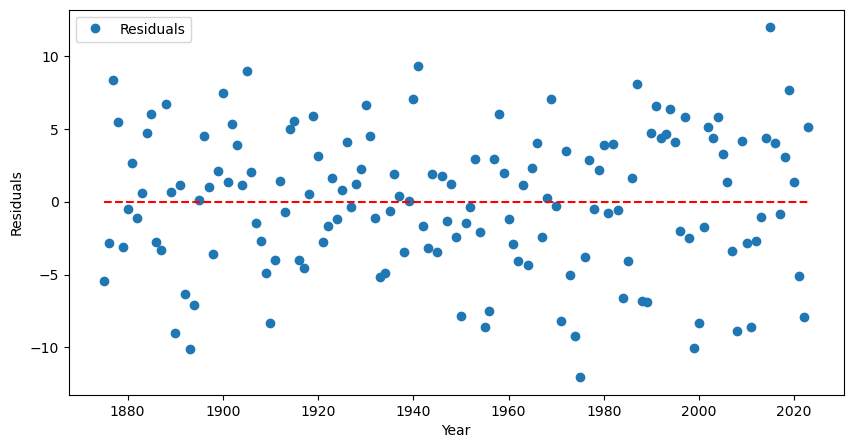

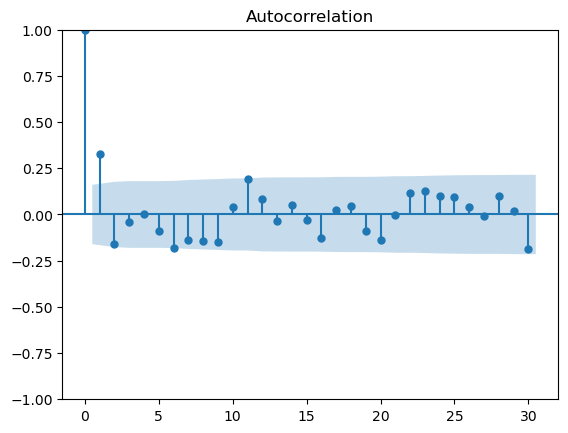

In [69]:
y_pred, y_std = gp.predict(X_poly, return_std=True)
y_true = y

mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_true, y_pred)
r2 = r2_score(y_true, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R² (R-squared): {r2}")

residuals = y_true - y_pred
    
plt.figure(figsize=(10, 5))
plt.plot(X, residuals, 'o', label='Residuals')
plt.hlines(0, X.min(), X.max(), colors='r', linestyles='dashed')
plt.xlabel('Year')
plt.ylabel('Residuals')
plt.legend()
plt.show()



plot_acf(residuals, lags=30)
plt.show()


In [10]:
np.float = np.float64 # problem from Bayesian package, use this to fix

# Load the ENSO data
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-1, 1e1)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3)) + RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability

# Define the objective function for Bayesian optimization
def objective(period1, period2):
    periods = [period1, period2]
    X_periodic = periodic_transform(X, periods)
    X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
    gp.fit(X_poly, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {'period1': (3.0, 7.0), 'period2': (10.0, 12.0)}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1,
)

# Set the utility function
utility = UtilityFunction(kind="ei", xi=0.01, kappa=2.5,)

# Define a progress bar for the optimization process
total_iterations = 100

# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    for _ in range(20):
        optimizer.probe(
            params={"period1": np.random.uniform(3.0, 7.0), "period2": np.random.uniform(10.0, 12.0)},
            lazy=True
        )
        pbar.update(1)
    
    optimizer.maximize(
        init_points=0,
        n_iter=total_iterations - 20,
        acq="ei",
        xi=0.01
    )

    def on_step(instance):
        pbar.update(1)

# Example of optimizing with progress
optimizer.maximize(
    init_points=2,
    n_iter=total_iterations,
    acq='ei',
    xi=0.01,
)

# Get the best periods
best_params = optimizer.max['params']
best_period1 = best_params['period1']
best_period2 = best_params['period2']
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}")

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_period1, best_period2])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


  0%|          | 0/100 [00:00<?, ?it/s]d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|   iter    |  target   |  period1  |  period2  |
-------------------------------------------------
|  1        | -1.142e+0 |  4.032    |  11.25    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  2        | -1.121e+0 |  6.43     |  11.17    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  3        | -1.204e+0 |  6.302    |  10.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  4        | -1.092e+0 |  6.03     |  11.46    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  5        | -1.231e+0 |  3.232    |  11.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
 20%|██        | 20/100 [00:19<01:16,  1.04it/s]


KeyboardInterrupt: 

In [92]:
best_params = optimizer.max['params']
best_period1 = best_params['period1']
best_period2 = best_params['period2']
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}")

Best Period1: 5.0994281783240965, Best Period2: 11.35578512828357


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


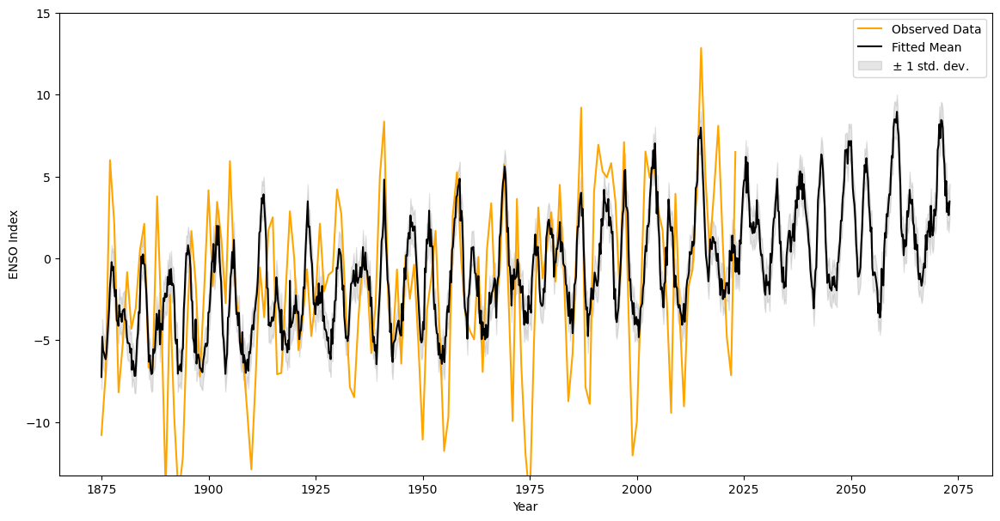

In [93]:
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

In [8]:
def evaluate_model(gp, X_poly, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X_poly, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

In [9]:
mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X_poly, y)

Mean Squared Error (MSE): 5.63386177449075
Root Mean Squared Error (RMSE): 2.3735757359921656
Mean Absolute Error (MAE): 1.8430875698087075
R² (R-squared): 0.8127664495710154
Mean CRPS: 1.5357984018830535


## BAYES other periods

  0%|          | 0/150 [00:00<?, ?it/s]

|   iter    |  target   |  period1  |  period2  |  period3  |
-------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  1        | -1.24e+03 |  2.313    |  7.809    |  10.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  2        | -1.163e+0 |  2.061    |  4.589    |  11.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  3        | -1.14e+03 |  2.722    |  5.22     |  10.44    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  4        | -1.221e+0 |  3.437    |  7.841    |  10.47    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  5        | -1.171e+0 |  3.128    |  6.807    |  9.99     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  6        | -1.128e+0 |  3.001    |  7.286    |  11.75    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  7        | -1.194e+0 |  3.465    |  7.019    |  9.792    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  8        | -1.205e+0 |  2.27     |  5.84     |  9.263    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  9        | -1.123e+0 |  3.175    |  5.008    |  11.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  10       | -1.157e+0 |  3.001    |  7.39     |  10.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  11       | -1.177e+0 |  3.765    |  6.534    |  9.008    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  12       | -1.187e+0 |  2.891    |  7.814    |  10.58    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  13       | -1.184e+0 |  3.952    |  6.367    |  9.621    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  14       | -1.157e+0 |  3.611    |  6.236    |  9.885    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  15       | -1.199e+0 |  2.549    |  4.811    |  9.858    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  16       | -1.244e+0 |  3.917    |  4.495    |  9.653    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  17       | -1.159e+0 |  2.221    |  7.748    |  11.43    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  18       | -1.204e+0 |  2.764    |  6.28     |  9.899    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  19       | -1.087e+0 |  2.066    |  5.526    |  9.677    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  20       | -1.216e+0 |  3.493    |  6.013    |  10.45    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  21       | -1.168e+0 |  2.381    |  6.478    |  10.81    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  22       | -1.169e+0 |  3.358    |  7.761    |  10.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  23       | -1.179e+0 |  3.214    |  5.231    |  9.254    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  24       | -1.155e+0 |  3.954    |  4.808    |  10.7     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  25       | -1.042e+0 |  2.49     |  5.159    |  11.41    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  26       | -1.121e+0 |  3.419    |  7.092    |  9.176    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  27       | -1.189e+0 |  2.051    |  4.564    |  9.262    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  28       | -1.215e+0 |  2.233    |  6.354    |  10.05    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  29       | -1.167e+0 |  2.024    |  4.895    |  11.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  30       | -1.234e+0 |  3.311    |  6.626    |  10.11    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  31       | -1.184e+0 |  2.897    |  5.214    |  10.18    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  32       | -1.21e+03 |  2.666    |  4.621    |  10.23    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  33       | -1.176e+0 |  2.983    |  4.69     |  10.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  34       | -1.015e+0 |  2.887    |  5.875    |  10.78    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  35       | -1.151e+0 |  2.006    |  7.841    |  11.97    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  36       | -1.234e+0 |  3.883    |  4.337    |  10.56    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  37       | -1.048e+0 |  2.398    |  5.738    |  10.28    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  38       | -1.135e+0 |  3.048    |  7.087    |  10.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  39       | -1.147e+0 |  2.008    |  5.443    |  9.232    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  40       | -1.168e+0 |  2.858    |  5.068    |  11.04    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  41       | -1.222e+0 |  2.951    |  7.558    |  9.869    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  42       | -1.123e+0 |  2.598    |  7.499    |  9.093    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  43       | -1.267e+0 |  2.02     |  7.762    |  9.813    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  44       | -1.081e+0 |  2.072    |  5.415    |  11.18    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  45       | -1.252e+0 |  3.084    |  7.74     |  9.871    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  46       | -1.193e+0 |  3.287    |  4.873    |  9.511    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  47       | -1.086e+0 |  2.168    |  4.533    |  11.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  48       | -1.139e+0 |  2.351    |  6.802    |  11.23    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  49       | -1.156e+0 |  3.941    |  5.942    |  9.034    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  50       | -1.15e+03 |  2.139    |  5.494    |  11.76    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  51       | -1.161e+0 |  2.834    |  6.881    |  9.0      |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  52       | -1.16e+03 |  2.605    |  4.587    |  9.277    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  53       | -1.153e+0 |  2.373    |  5.382    |  10.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  54       | -1.047e+0 |  3.078    |  5.677    |  11.06    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  55       | -1.085e+0 |  2.409    |  7.512    |  9.082    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  56       | -1.133e+0 |  3.341    |  5.669    |  10.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__constant_value is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  57       | -1.075e+0 |  2.281    |  4.792    |  11.4     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  58       | -1.124e+0 |  3.937    |  5.254    |  11.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  59       | -1.152e+0 |  3.753    |  7.578    |  9.255    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  60       | -1.167e+0 |  2.078    |  4.679    |  11.63    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  61       | -1.053e+0 |  2.197    |  5.684    |  11.87    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  62       | -1.134e+0 |  3.066    |  6.768    |  9.947    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  63       | -1.145e+0 |  3.373    |  7.339    |  9.055    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  64       | -1.093e+0 |  3.5      |  7.955    |  11.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  65       | -1.119e+0 |  2.561    |  7.157    |  9.31     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  66       | -1.232e+0 |  2.896    |  7.634    |  9.881    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  67       | -1.186e+0 |  2.576    |  4.52     |  9.058    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  68       | -1.192e+0 |  3.358    |  4.847    |  9.797    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


|  69       | -1.218e+0 |  2.983    |  4.213    |  10.72    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
 33%|███▎      | 50/150 [05:18<10:37,  6.38s/it]

|  70       | -1.119e+0 |  2.293    |  6.357    |  11.1     |
An error occurred during optimization: 'x0' must only have one dimension.
Best Period1: 2.8873807278384653, Best Period2: 5.875023898915525, Best Period3: 10.775377123373636
Best Period1: 2.8873807278384653, Best Period2: 5.875023898915525, Best Period3: 10.775377123373636



d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


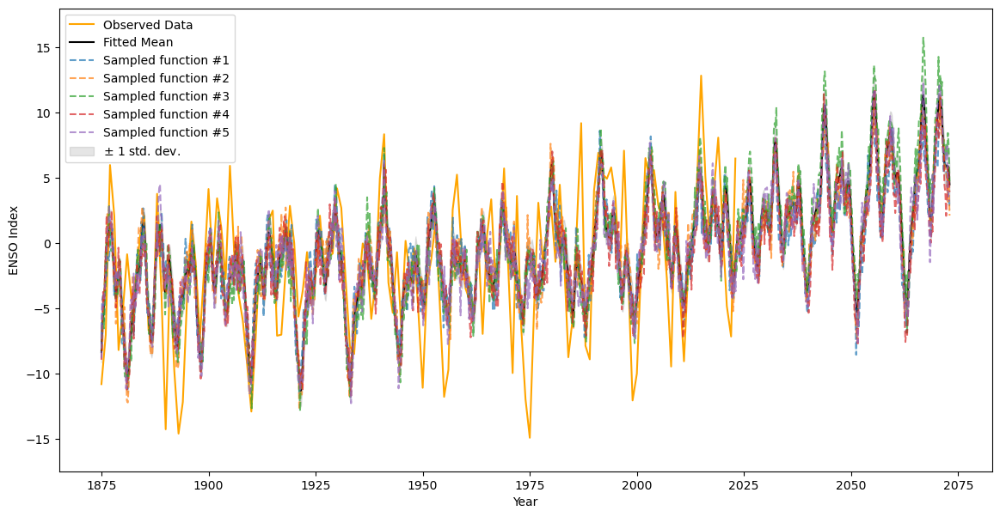

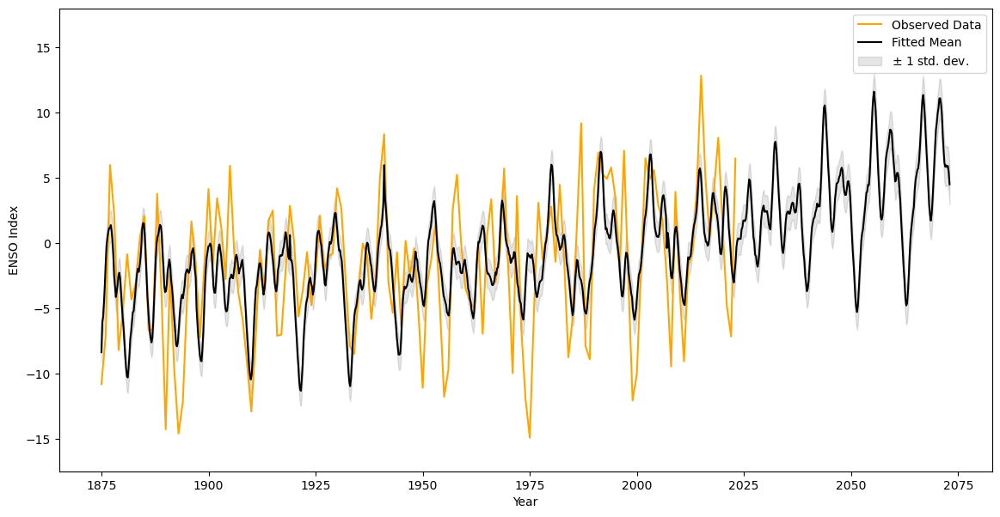

Mean Squared Error (MSE): 4.848605259039056
Root Mean Squared Error (RMSE): 2.2019548721622466
Mean Absolute Error (MAE): 1.7244254880343939
R² (R-squared): 0.8388633563235428
Mean CRPS: 1.4099576334996373


In [19]:
np.float = np.float64

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-1, 1e1)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3)) + RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3):
    periods = [period1, period2, period3]
    X_periodic = periodic_transform(X, periods)
    X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
    gp.fit(X_poly, y)
    return gp.log_marginal_likelihood()
pbounds = {'period1': (2.0, 4.0), 'period2': (4.0, 8.0), 'period3': (9.0, 12.0)}


# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1,
)

# Set the utility function
utility = UtilityFunction(kind="ei", xi=0.01, kappa=2.5)

# Define a progress bar for the optimization process
from tqdm import tqdm
total_iterations = 150  # Increased total iterations

# Define a progress bar for the optimization process
# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    try:
        for _ in range(50):  # Increased initial points to 50
            optimizer.probe(
                params={"period1": np.random.uniform(2.0, 4.0), "period2": np.random.uniform(4.0, 8.0), "period3": np.random.uniform(9.0, 12.0)},
                lazy=True
            )
            pbar.update(1)

        optimizer.maximize(
            init_points=20,  # Increased initial points in maximize
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

        def on_step(instance):
            pbar.update(1)

        # Example of optimizing with progress
        optimizer.maximize(
            init_points=20,  # Increased initial points in the example optimization
            n_iter=total_iterations,
            acq='ei',
            xi=0.01,
        )
    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best Period1: {best_params['period1']}, Best Period2: {best_params['period2']}, Best Period3: {best_params['period3']}")

# Get the best periods
best_params = optimizer.max['params']
best_period1 = best_params['period1']
best_period2 = best_params['period2']
best_period3 = best_params['period3']
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}, Best Period3: {best_period3}")

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_period1, best_period2, best_period3])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2, best_period3], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2, best_period3], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

def evaluate_model(gp, X_poly, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X_poly, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X_poly, y)


## + matern + white noise

  0%|          | 0/50 [00:00<?, ?it/s]

|   iter    |  target   |  period1  |  period2  |  period3  |
-------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  1        | -518.9    |  2.041    |  6.595    |  11.99    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  2        | -520.1    |  3.927    |  4.121    |  9.713    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  3        | -521.6    |  2.205    |  7.255    |  9.983    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  4        | -517.4    |  3.16     |  6.599    |  11.0     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  5        | -513.0    |  2.238    |  5.636    |  10.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  6        | -516.7    |  3.226    |  5.087    |  10.98    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  7        | -521.0    |  3.926    |  5.401    |  9.802    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  8        | -517.1    |  3.123    |  7.827    |  11.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  9        | -515.8    |  2.776    |  5.728    |  9.937    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  10       | -517.7    |  2.686    |  5.896    |  11.9     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  11       | -516.8    |  3.696    |  4.608    |  11.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  12       | -521.1    |  3.081    |  4.021    |  10.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  13       | -518.9    |  2.653    |  7.888    |  11.76    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  14       | -522.3    |  3.195    |  6.179    |  10.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  15       | -516.1    |  2.289    |  4.58     |  10.77    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  16       | -522.0    |  2.612    |  7.925    |  10.37    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  17       | -517.8    |  2.623    |  5.435    |  11.7     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  18       | -520.0    |  3.127    |  5.835    |  9.813    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  19       | -521.0    |  3.079    |  7.423    |  10.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  20       | -521.1    |  2.619    |  6.684    |  10.36    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  21       | -517.9    |  2.799    |  5.329    |  10.87    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  22       | -517.3    |  3.675    |  5.266    |  10.03    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  23       | -517.3    |  3.496    |  5.335    |  11.07    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  24       | -516.3    |  3.042    |  4.054    |  11.65    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  25       | -521.5    |  2.851    |  6.532    |  10.12    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  26       | -516.5    |  3.127    |  4.533    |  10.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  27       | -518.7    |  2.845    |  7.679    |  10.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  28       | -514.8    |  2.734    |  4.57     |  9.116    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  29       | -520.3    |  2.749    |  7.946    |  9.59     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  30       | -516.5    |  2.95     |  4.174    |  9.27     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  31       | -517.1    |  2.419    |  5.385    |  10.81    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  32       | -517.8    |  2.891    |  5.161    |  10.31    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  33       | -517.1    |  3.049    |  6.78     |  10.95    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  34       | -517.3    |  2.561    |  7.228    |  11.66    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  35       | -519.2    |  3.826    |  4.206    |  9.65     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  36       | -521.7    |  2.376    |  7.569    |  9.861    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  37       | -516.8    |  2.124    |  4.815    |  11.58    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  38       | -516.6    |  3.916    |  4.76     |  9.522    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  39       | -516.6    |  3.37     |  7.544    |  11.92    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  40       | -518.8    |  2.489    |  6.679    |  11.94    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  41       | -517.2    |  2.543    |  6.437    |  11.98    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  42       | -518.9    |  2.935    |  7.864    |  10.67    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  43       | -520.5    |  3.162    |  6.465    |  9.806    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  44       | -513.1    |  3.566    |  4.076    |  9.246    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  45       | -516.2    |  2.116    |  4.68     |  11.51    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  46       | -521.0    |  3.026    |  6.833    |  9.504    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  47       | -521.0    |  2.714    |  6.068    |  9.449    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  48       | -521.3    |  3.725    |  7.566    |  9.863    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  49       | -521.9    |  2.716    |  6.926    |  9.571    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  50       | -513.1    |  3.041    |  4.753    |  9.067    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  51       | -518.7    |  2.834    |  6.881    |  9.0      |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  52       | -516.5    |  2.605    |  4.587    |  9.277    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  53       | -521.7    |  2.373    |  5.382    |  10.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  54       | -510.7    |  3.078    |  5.677    |  11.06    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  55       | -515.1    |  2.409    |  7.512    |  9.082    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  56       | -512.0    |  3.341    |  5.669    |  10.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  57       | -514.7    |  2.281    |  4.792    |  11.4     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  58       | -515.4    |  3.937    |  5.254    |  11.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  59       | -515.7    |  3.753    |  7.578    |  9.255    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  60       | -516.5    |  2.078    |  4.679    |  11.63    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  61       | -511.2    |  2.197    |  5.684    |  11.87    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -520.4    |  3.066    |  6.768    |  9.947    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  63       | -515.7    |  3.373    |  7.339    |  9.055    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  64       | -515.6    |  3.5      |  7.955    |  11.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  65       | -518.4    |  2.561    |  7.157    |  9.31     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  66       | -520.5    |  2.896    |  7.634    |  9.881    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  67       | -516.3    |  2.576    |  4.52     |  9.058    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  68       | -520.5    |  3.358    |  4.847    |  9.797    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  69       | -517.8    |  2.983    |  4.213    |  10.72    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  70       | -515.8    |  2.293    |  6.357    |  11.1     |
|   iter    |  target   |  period1  |  period2  |  period3  |
-------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  71       | -510.5    |  2.205    |  5.656    |  11.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  72       | -518.1    |  2.828    |  4.2      |  10.61    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  73       | -518.5    |  3.328    |  6.06     |  11.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  74       | -519.8    |  3.173    |  7.614    |  9.412    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  75       | -522.8    |  2.279    |  7.23     |  10.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  76       | -522.7    |  2.331    |  7.71     |  10.04    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  77       | -516.7    |  3.502    |  6.904    |  11.65    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  78       | -521.9    |  3.247    |  7.004    |  10.05    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  79       | -520.5    |  2.54     |  7.584    |  10.28    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  80       | -517.3    |  3.93     |  6.654    |  10.87    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  81       | -522.6    |  2.229    |  7.798    |  10.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  82       | -513.8    |  3.157    |  5.633    |  9.711    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  83       | -515.4    |  3.807    |  6.295    |  9.009    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  84       | -519.1    |  3.234    |  5.307    |  10.58    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  85       | -513.9    |  3.772    |  5.429    |  11.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  86       | -517.8    |  3.247    |  4.063    |  11.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  87       | -519.5    |  3.382    |  7.989    |  9.517    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  88       | -518.0    |  2.274    |  7.73     |  11.09    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  89       | -517.5    |  2.132    |  7.022    |  11.26    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:

|  90       | -519.8    |  3.846    |  6.846    |  9.373    |
An error occurred during optimization: 'x0' must only have one dimension.
Best Period1: 2.2046688576556517, Best Period2: 5.656223951278273, Best Period3: 11.083200473183236
Best Period1: 2.2046688576556517, Best Period2: 5.656223951278273, Best Period3: 11.083200473183236


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel: 0.316**2 * DotProduct(sigma_0=0.00863) + 2.87**2 + RBF(length_scale=0.0453) + 3.16**2 * Matern(length_scale=41.9, nu=2.5) + WhiteKernel(noise_level=10)
Log-marginal-likelihood: -510.5234235923141


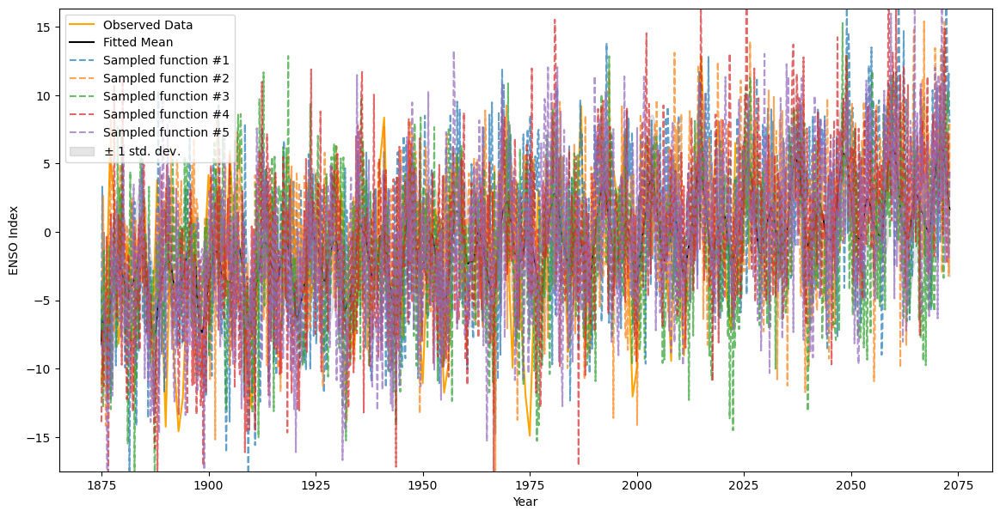

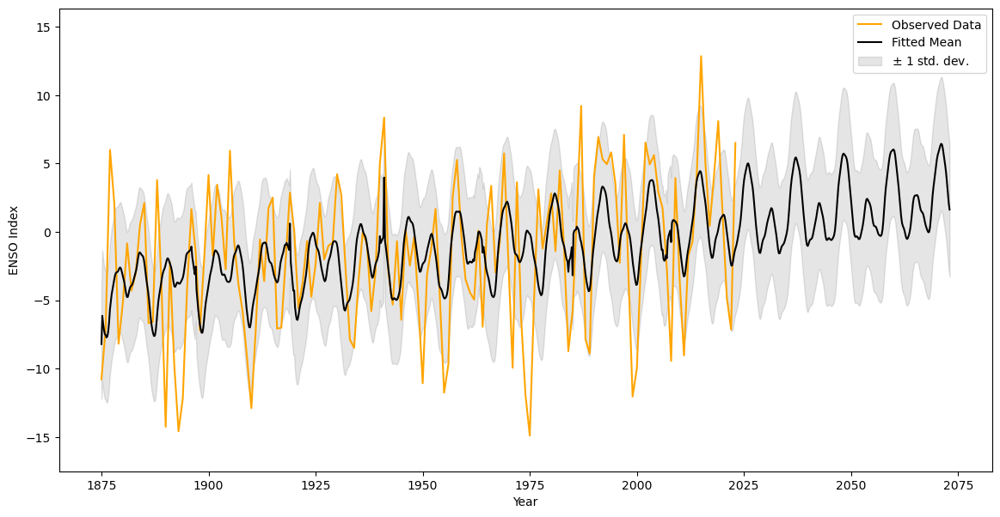

Mean Squared Error (MSE): 5.9112323434758665
Root Mean Squared Error (RMSE): 2.431302602202339
Mean Absolute Error (MAE): 1.9132389248793313
R² (R-squared): 0.8035484249736183
Mean CRPS: 1.4748763996243592


In [23]:
np.float = np.float64

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-1, 1e1)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3)) + RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2)) + C(1.0, (1e-1, 1e1)) * Matern(length_scale=10.0, length_scale_bounds=(1e0, 1e2), nu=2.5) + WhiteKernel(noise_level=1e-1, noise_level_bounds=(1e-2, 1e1))
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)  # Increase alpha for numerical stability

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3):
    periods = [period1, period2, period3]
    X_periodic = periodic_transform(X, periods)
    X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
    gp.fit(X_poly, y)
    return gp.log_marginal_likelihood()
pbounds = {'period1': (2.0, 4.0), 'period2': (4.0, 8.0), 'period3': (9.0, 12.0)}


# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1,
)

# Set the utility function
utility = UtilityFunction(kind="ei", xi=0.01, kappa=2.5)

total_iterations = 50  # Increased total iterations

# Define a progress bar for the optimization process
# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    try:
        for _ in range(50):  # Increased initial points to 50
            optimizer.probe(
                params={"period1": np.random.uniform(2.0, 4.0), "period2": np.random.uniform(4.0, 8.0), "period3": np.random.uniform(9.0, 12.0)},
                lazy=True
            )
            pbar.update(1)

        optimizer.maximize(
            init_points=20,  # Increased initial points in maximize
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

        def on_step(instance):
            pbar.update(1)

        # Example of optimizing with progress
        optimizer.maximize(
            init_points=20,  # Increased initial points in the example optimization
            n_iter=total_iterations,
            acq='ei',
            xi=0.01,
        )
    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best Period1: {best_params['period1']}, Best Period2: {best_params['period2']}, Best Period3: {best_params['period3']}")

# Get the best periods
best_params = optimizer.max['params']
best_period1 = best_params['period1']
best_period2 = best_params['period2']
best_period3 = best_params['period3']
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}, Best Period3: {best_period3}")

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_period1, best_period2, best_period3])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2, best_period3], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2, best_period3], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

def evaluate_model(gp, X_poly, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X_poly, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X_poly, y)


  0%|          | 0/50 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... |   sigma   |
-------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  1        | -277.1    |  4.12     |  673.7    |  86.99    |  3.5      |  2.2      |  3.537    |  4.577    |  9.138    |  39.94    |  5.18     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  2        | -281.2    |  1.559    |  911.9    |  19.43    |  6.141    |  2.452    |  3.428    |  7.408    |  11.22    |  15.29    |  1.024    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  3        | -284.2    |  6.314    |  287.1    |  65.53    |  0.5158   |  2.215    |  3.995    |  5.252    |  9.257    |  32.14    |  8.262    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  4        | -284.7    |  9.103    |  551.5    |  83.11    |  0.01095  |  0.9231   |  3.731    |  7.094    |  10.12    |  78.63    |  3.508    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  5        | -283.7    |  6.97     |  996.2    |  22.65    |  5.262    |  0.8123   |  3.974    |  6.697    |  10.48    |  40.3     |  5.324    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  6        | -285.0    |  0.7053   |  233.0    |  53.54    |  1.474    |  1.489    |  2.281    |  4.906    |  11.46    |  77.8     |  2.576    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  7        | -281.4    |  3.291    |  433.3    |  47.53    |  4.668    |  0.9295   |  2.708    |  6.855    |  11.45    |  47.29    |  6.019    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  8        | -283.6    |  9.655    |  784.7    |  17.88    |  1.335    |  0.8785   |  2.937    |  6.752    |  9.053    |  94.89    |  9.241    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  9        | -278.2    |  0.3617   |  7.533    |  3.094    |  3.587    |  0.5282   |  2.796    |  7.302    |  11.12    |  63.11    |  3.387    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  10       | -281.1    |  3.81     |  928.3    |  91.89    |  5.915    |  0.507    |  3.272    |  6.806    |  10.61    |  59.42    |  6.39     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  11       | -284.2    |  0.5134   |  528.2    |  1.036    |  9.322    |  0.9457   |  2.69     |  4.095    |  9.426    |  77.56    |  6.89     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  12       | -287.5    |  5.666    |  627.0    |  47.27    |  1.428    |  1.158    |  2.116    |  5.916    |  9.809    |  82.78    |  6.392    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  13       | -285.9    |  7.226    |  763.4    |  82.8     |  6.426    |  1.332    |  3.258    |  6.574    |  9.838    |  0.6894   |  6.048    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  14       | -281.0    |  5.294    |  464.3    |  18.48    |  9.516    |  1.381    |  3.125    |  4.075    |  11.15    |  1.031    |  8.838    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  15       | -284.9    |  8.84     |  886.8    |  40.26    |  9.081    |  1.164    |  3.835    |  6.118    |  10.19    |  50.14    |  5.214    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  16       | -277.6    |  4.002    |  85.52    |  96.78    |  4.174    |  1.727    |  2.825    |  5.692    |  9.309    |  8.139    |  2.054    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  17       | -284.9    |  6.102    |  420.6    |  87.16    |  5.143    |  1.026    |  2.592    |  4.064    |  10.92    |  43.15    |  4.672    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  18       | -282.6    |  0.526    |  894.7    |  14.19    |  9.914    |  1.163    |  2.45     |  5.835    |  11.62    |  27.04    |  1.952    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  19       | -278.6    |  6.255    |  781.4    |  29.86    |  7.176    |  1.804    |  2.208    |  5.706    |  10.78    |  17.61    |  5.15     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  20       | -282.7    |  5.539    |  235.0    |  53.06    |  9.113    |  1.673    |  2.657    |  7.236    |  9.032    |  87.86    |  6.717    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  21       | -285.6    |  9.095    |  273.9    |  63.25    |  6.912    |  0.8705   |  2.319    |  6.255    |  10.03    |  59.66    |  2.624    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  22       | -279.4    |  7.949    |  751.5    |  17.36    |  8.139    |  1.281    |  3.644    |  5.818    |  9.563    |  28.41    |  3.028    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  23       | -286.3    |  0.1082   |  750.4    |  12.95    |  9.593    |  2.156    |  2.183    |  6.287    |  10.2     |  86.15    |  1.863    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  24       | -283.4    |  7.197    |  282.5    |  86.93    |  0.2145   |  2.479    |  2.595    |  4.008    |  11.0     |  57.9     |  8.235    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  25       | -283.4    |  3.468    |  5.685    |  2.783    |  2.916    |  2.13     |  2.73     |  6.601    |  10.62    |  1.459    |  5.422    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  26       | -276.5    |  6.283    |  571.2    |  41.71    |  1.037    |  1.143    |  3.594    |  5.942    |  11.34    |  67.28    |  1.907    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  27       | -285.0    |  6.501    |  988.4    |  7.041    |  5.569    |  2.21     |  3.832    |  5.371    |  9.918    |  10.04    |  0.6192   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  28       | -284.6    |  4.191    |  519.1    |  69.05    |  9.975    |  2.376    |  3.446    |  5.912    |  10.37    |  74.78    |  3.607    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  29       | -284.3    |  7.928    |  772.7    |  62.96    |  2.633    |  1.788    |  2.843    |  6.76     |  10.62    |  8.886    |  3.173    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  30       | -281.9    |  6.396    |  522.8    |  33.78    |  1.239    |  1.805    |  2.91     |  6.337    |  11.44    |  25.72    |  4.778    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k2__sigma_0 is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  31       | -280.6    |  5.838    |  944.8    |  20.0     |  1.465    |  0.8408   |  3.277    |  6.3      |  9.325    |  77.57    |  9.177    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  32       | -281.1    |  3.456    |  652.3    |  26.98    |  6.33     |  1.972    |  3.749    |  5.086    |  9.076    |  10.6     |  0.02489  |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  33       | -287.2    |  5.776    |  39.04    |  95.51    |  8.523    |  1.702    |  2.346    |  4.519    |  10.48    |  63.44    |  3.69     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  34       | -285.8    |  4.018    |  780.9    |  72.03    |  4.579    |  2.443    |  2.217    |  5.01     |  10.72    |  41.98    |  9.802    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  35       | -283.7    |  3.313    |  40.66    |  89.14    |  0.3437   |  0.77     |  2.543    |  6.567    |  11.75    |  33.6     |  0.4507   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  36       | -279.5    |  0.8755   |  641.2    |  37.74    |  7.584    |  1.356    |  2.788    |  5.811    |  11.16    |  47.17    |  0.1336   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  37       | -286.5    |  8.893    |  66.09    |  69.83    |  5.038    |  2.221    |  2.124    |  6.71     |  11.92    |  37.72    |  8.532    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  38       | -284.3    |  8.338    |  554.9    |  48.43    |  7.67     |  1.039    |  3.429    |  7.825    |  11.44    |  21.7     |  3.802    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  39       | -285.9    |  5.048    |  394.4    |  12.13    |  9.421    |  1.105    |  2.672    |  5.814    |  9.556    |  27.84    |  9.094    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  40       | -278.1    |  1.241    |  282.5    |  28.56    |  1.727    |  0.5712   |  3.855    |  7.303    |  11.44    |  13.86    |  9.966    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  41       | -284.1    |  9.805    |  561.0    |  91.9     |  2.803    |  1.056    |  2.076    |  6.831    |  11.57    |  38.26    |  1.108    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  42       | -281.7    |  8.793    |  146.2    |  25.37    |  7.45     |  0.9801   |  3.189    |  6.305    |  11.36    |  78.03    |  2.416    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  43       | -286.3    |  7.073    |  728.5    |  32.31    |  1.396    |  1.456    |  3.423    |  7.018    |  9.669    |  75.44    |  1.527    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  44       | -281.8    |  9.978    |  704.4    |  32.84    |  9.922    |  2.49     |  3.945    |  4.596    |  9.212    |  96.36    |  0.6643   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  45       | -281.6    |  4.008    |  583.1    |  2.259    |  0.4952   |  2.225    |  2.181    |  4.477    |  9.035    |  26.34    |  7.388    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  46       | -285.1    |  2.693    |  41.84    |  30.11    |  2.357    |  0.6744   |  3.69     |  6.679    |  9.017    |  59.41    |  7.249    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  47       | -278.9    |  4.207    |  61.33    |  28.44    |  6.991    |  1.102    |  3.835    |  4.81     |  11.83    |  46.82    |  8.328    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  48       | -283.1    |  9.277    |  836.3    |  56.98    |  2.226    |  0.7029   |  2.28     |  4.92     |  11.13    |  5.602    |  1.173    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  49       | -283.6    |  8.253    |  935.8    |  35.57    |  8.55     |  1.675    |  2.583    |  4.104    |  9.066    |  85.1     |  1.475    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  50       | -286.6    |  9.939    |  833.5    |  4.658    |  1.134    |  1.828    |  2.812    |  5.982    |  10.31    |  80.28    |  2.6      |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  51       | -283.2    |  4.229    |  720.3    |  1.011    |  3.03     |  0.7935   |  2.185    |  4.745    |  10.04    |  39.68    |  5.393    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  52       | -281.6    |  4.25     |  685.2    |  21.24    |  8.782    |  0.5548   |  3.341    |  5.669    |  10.68    |  14.05    |  1.989    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  53       | -282.7    |  8.027    |  968.3    |  32.03    |  6.926    |  2.253    |  3.789    |  4.34     |  9.117    |  16.99    |  8.783    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  54       | -282.3    |  1.074    |  421.1    |  95.83    |  5.336    |  1.884    |  2.631    |  6.746    |  11.5     |  1.839    |  7.504    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  55       | -287.4    |  9.89     |  748.2    |  28.76    |  7.895    |  0.7065   |  2.896    |  7.634    |  9.881    |  28.78    |  1.309    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  56       | -281.1    |  0.2917   |  678.8    |  21.95    |  2.663    |  1.483    |  2.107    |  6.296    |  9.44     |  58.93    |  7.001    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  57       | -282.6    |  1.113    |  414.1    |  69.75    |  4.148    |  0.5999   |  3.072    |  6.655    |  10.54    |  94.46    |  5.87     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  58       | -289.0    |  9.044    |  137.5    |  14.79    |  8.076    |  1.295    |  2.331    |  7.71     |  10.04    |  75.08    |  7.263    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  59       | -275.3    |  8.845    |  623.7    |  75.34    |  3.495    |  1.04     |  3.792    |  5.712    |  11.89    |  66.35    |  6.221    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  60       | -283.5    |  1.236    |  949.5    |  45.54    |  5.788    |  1.316    |  2.474    |  7.614    |  10.72    |  0.297    |  6.175    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  61       | -285.5    |  3.334    |  527.1    |  88.71    |  3.579    |  2.317    |  3.247    |  4.063    |  11.79    |  69.09    |  9.973    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -281.4    |  1.806    |  137.1    |  93.33    |  6.971    |  0.632    |  3.511    |  7.016    |  11.77    |  71.16    |  1.251    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  63       | -280.4    |  0.2968   |  26.21    |  3.802    |  2.47     |  2.22     |  3.078    |  6.211    |  11.53    |  12.43    |  2.799    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  64       | -287.4    |  5.899    |  969.6    |  56.54    |  0.1963   |  2.101    |  2.466    |  7.228    |  10.16    |  86.36    |  7.474    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  65       | -283.7    |  5.607    |  136.5    |  6.932    |  1.222    |  0.5891   |  2.215    |  4.903    |  11.14    |  55.98    |  0.1354   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  66       | -279.4    |  0.8125   |  967.3    |  57.24    |  2.041    |  1.005    |  3.488    |  4.782    |  10.74    |  97.0     |  8.47     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  67       | -285.5    |  2.474    |  493.8    |  62.38    |  8.292    |  0.8136   |  2.037    |  4.28     |  10.46    |  60.64    |  5.693    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  68       | -287.4    |  3.242    |  988.6    |  58.39    |  3.808    |  1.602    |  3.491    |  6.677    |  9.795    |  6.643    |  3.707    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  69       | -282.3    |  6.334    |  210.2    |  75.52    |  0.6747   |  1.021    |  3.61     |  4.774    |  10.92    |  52.47    |  9.249    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  70       | -285.4    |  2.707    |  65.96    |  73.77    |  7.724    |  2.316    |  3.864    |  4.056    |  9.703    |  61.68    |  9.491    |
|   iter    |  target   | constant1 | constant2 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... |   sigma   |
-------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  71       | -284.0    |  9.507    |  556.7    |  91.65    |  6.419    |  1.28     |  2.972    |  6.417    |  10.65    |  92.62    |  9.188    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  72       | -281.2    |  4.009    |  963.3    |  18.22    |  1.272    |  0.7702   |  3.011    |  4.086    |  11.84    |  82.71    |  0.16     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  73       | -283.4    |  1.844    |  332.1    |  13.97    |  8.097    |  1.189    |  3.88     |  6.328    |  11.64    |  84.47    |  9.055    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  74       | -284.9    |  4.653    |  546.3    |  80.06    |  2.864    |  1.481    |  3.198    |  4.062    |  10.78    |  43.37    |  8.076    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  75       | -286.3    |  3.221    |  892.9    |  58.21    |  1.848    |  2.076    |  3.224    |  4.216    |  10.26    |  67.91    |  9.187    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  76       | -279.8    |  0.104    |  976.8    |  38.28    |  9.738    |  1.709    |  3.658    |  6.299    |  10.88    |  28.56    |  5.872    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  77       | -282.0    |  7.525    |  858.3    |  75.75    |  6.984    |  2.229    |  2.645    |  6.683    |  10.35    |  38.22    |  4.114    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  78       | -282.8    |  4.075    |  317.4    |  62.57    |  4.308    |  2.448    |  3.356    |  4.794    |  10.28    |  34.34    |  7.978    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  79       | -280.6    |  8.812    |  903.8    |  66.61    |  2.709    |  1.005    |  3.71     |  6.111    |  11.41    |  57.25    |  7.334    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  80       | -282.3    |  5.238    |  770.9    |  57.32    |  4.662    |  1.185    |  2.136    |  5.512    |  9.239    |  98.28    |  1.824    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  81       | -286.4    |  8.137    |  875.0    |  69.15    |  5.699    |  0.8219   |  2.934    |  5.381    |  9.675    |  59.26    |  3.13     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  82       | -287.6    |  9.171    |  909.6    |  26.45    |  1.118    |  0.8859   |  2.999    |  6.914    |  9.625    |  24.81    |  8.518    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  83       | -283.9    |  4.217    |  616.7    |  24.13    |  1.029    |  1.532    |  2.954    |  4.611    |  10.87    |  54.41    |  6.545    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  84       | -285.2    |  1.531    |  751.5    |  22.98    |  5.198    |  2.071    |  2.045    |  5.297    |  11.62    |  84.47    |  5.389    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  85       | -280.9    |  8.679    |  949.8    |  82.81    |  8.543    |  0.6975   |  3.303    |  6.814    |  10.83    |  79.96    |  0.3554   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  86       | -284.2    |  7.725    |  731.7    |  26.71    |  2.578    |  1.765    |  2.691    |  7.186    |  10.34    |  78.28    |  9.905    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  87       | -281.1    |  3.072    |  143.0    |  90.23    |  5.42     |  2.449    |  3.273    |  7.976    |  10.64    |  52.65    |  1.363    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  88       | -280.8    |  3.621    |  26.22    |  16.88    |  7.459    |  0.5608   |  2.733    |  7.449    |  11.08    |  69.1     |  1.894    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  89       | -284.8    |  4.475    |  581.6    |  98.99    |  2.047    |  0.9955   |  2.524    |  7.001    |  10.37    |  5.702    |  5.09     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  90       | -275.1    |  2.198    |  798.6    |  30.44    |  0.2858   |  1.687    |  3.688    |  5.524    |  11.25    |  51.12    |  5.414    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant1': 2.198405629972392, 'constant2': 798.6044461559654, 'matern_length': 30.43580676921995, 'noise_level': 0.2857840594254913, 'nu': 1.686864898929242, 'period1': 3.687680857862378, 'period2': 5.524064496248856, 'period3': 11.24957493217843, 'rbf_length': 51.119036414929845, 'sigma': 5.414108531572264}
Best parameters: {'constant1': 2.198405629972392, 'constant2': 798.6044461559654, 'matern_length': 30.43580676921995, 'noise_level': 0.2857840594254913, 'nu': 1.686864898929242, 'period1': 3.687680857862378, 'period2': 5.524064496248856, 'period3': 11.24957493217843, 'rbf_length': 51.119036414929845, 'sigma': 5.414108531572264}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel: 0.316**2 * DotProduct(sigma_0=97.5) + 0.0511**2 + RBF(length_scale=0.81) + 0.316**2 * Matern(length_scale=9.4, nu=1.69) + WhiteKernel(noise_level=0.01)
Log-marginal-likelihood: -275.1401372192766


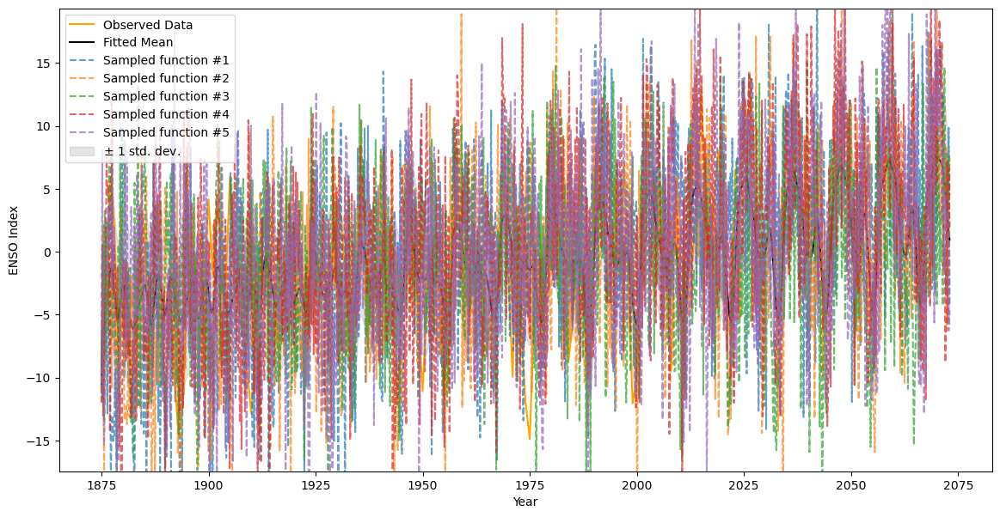

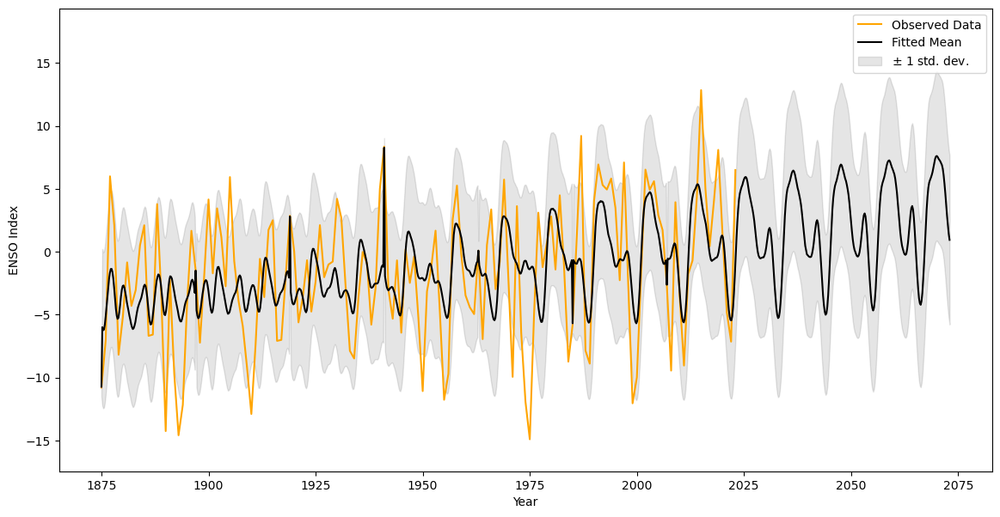

Mean Squared Error (MSE): 0.002928658284566075
Root Mean Squared Error (RMSE): 0.0541170794164474
Mean Absolute Error (MAE): 0.043826286452861164
R² (R-squared): 0.9999026701203257
Mean CRPS: 0.18218136397403442


In [24]:
from sklearn.gaussian_process.kernels import DotProduct, ConstantKernel as C, RBF, Matern, WhiteKernel

# Initialize polynomial features (adjust degree as needed)
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the kernel function with initial parameters
def create_kernel(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu):
    kernel = (
        C(constant1, (1e-1, 1e1)) * DotProduct(sigma_0=sigma) +
        C(constant2, (1e-3, 1e3)) +
        RBF(length_scale=rbf_length, length_scale_bounds=(1e-2, 1e2)) +
        C(1.0, (1e-1, 1e1)) * Matern(length_scale=matern_length, length_scale_bounds=(1e0, 1e2), nu=nu) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu):
    kernel = create_kernel(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu)
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    periods = [period1, period2, period3]
    X_periodic = periodic_transform(X, periods)
    X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
    gp.fit(X_poly, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rbf_length': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-1, 1e1),
    'constant2': (1e-3, 1e3),
    'sigma': (1e-2, 1e1),
    'nu': (0.5, 2.5)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 50

# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    try:
        for _ in range(50):  # Initial points for Bayesian optimization
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rbf_length": np.random.uniform(1e-2, 1e2),
                    "matern_length": np.random.uniform(1e0, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant1": np.random.uniform(1e-1, 1e1),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "sigma": np.random.uniform(1e-2, 1e1),
                    "nu": np.random.uniform(0.5, 2.5)
                },
                lazy=True
            )
            pbar.update(1)

        optimizer.maximize(
            init_points=20,  # Initial points in maximize
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

        def on_step(instance):
            pbar.update(1)

        # Example of optimizing with progress
        optimizer.maximize(
            init_points=20,  # Initial points in the example optimization
            n_iter=total_iterations,
            acq='ei',
            xi=0.01,
        )
    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
best_kernel = create_kernel(
    best_params['period1'], best_params['period2'], best_params['period3'],
    best_params['rbf_length'], best_params['matern_length'], best_params['noise_level'],
    best_params['constant1'], best_params['constant2'], best_params['sigma'], best_params['nu']
)
gp = GaussianProcessRegressor(kernel=best_kernel, n_restarts_optimizer=10, normalize_y=True)

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_params['period1'], best_params['period2'], best_params['period3']])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

def evaluate_model(gp, X_poly, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X_poly, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X_poly, y)


## periods only for poly, other kernels with origin x(year)

  0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... |   sigma   |
-------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  1        | -279.5    |  9.873    |  754.4    |  91.57    |  3.719    |  0.7424   |  2.437    |  5.144    |  9.399    |  93.18    |  4.286    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  2        | -285.5    |  2.97     |  350.0    |  6.934    |  9.932    |  0.965    |  2.839    |  6.125    |  10.71    |  63.3     |  8.883    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  3        | -276.5    |  2.448    |  436.7    |  60.85    |  0.6856   |  2.368    |  3.516    |  5.135    |  9.451    |  44.77    |  5.977    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  4        | -283.4    |  2.607    |  408.7    |  72.99    |  0.879    |  2.008    |  3.455    |  4.234    |  11.0     |  11.69    |  9.822    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k2__sigma_0 is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  5        | -279.6    |  1.274    |  750.4    |  63.45    |  1.734    |  0.9939   |  2.092    |  5.767    |  10.36    |  56.66    |  8.818    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  6        | -282.4    |  5.511    |  908.2    |  34.7     |  6.144    |  0.638    |  2.196    |  4.648    |  10.74    |  33.5     |  3.668    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  7        | -289.0    |  5.571    |  263.7    |  26.71    |  6.903    |  1.085    |  2.821    |  7.643    |  10.0     |  20.85    |  4.237    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  8        | -278.9    |  6.641    |  88.75    |  49.63    |  3.077    |  1.268    |  3.064    |  4.203    |  9.116    |  47.37    |  9.58     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  9        | -277.6    |  7.305    |  207.6    |  77.51    |  8.013    |  1.818    |  3.92     |  5.6      |  9.042    |  18.04    |  5.638    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  10       | -285.0    |  4.507    |  961.7    |  4.926    |  2.554    |  2.22     |  2.18     |  4.508    |  10.2     |  30.05    |  7.522    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  11       | -284.4    |  4.412    |  431.8    |  25.86    |  2.865    |  1.62     |  2.362    |  6.711    |  9.62     |  46.88    |  6.972    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  12       | -283.5    |  9.141    |  141.4    |  50.7     |  5.877    |  2.431    |  3.96     |  4.14     |  10.99    |  93.01    |  7.099    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  13       | -286.6    |  6.479    |  977.8    |  59.76    |  0.6636   |  1.791    |  2.4      |  6.248    |  9.873    |  98.94    |  1.061    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  14       | -285.7    |  5.169    |  233.0    |  41.08    |  4.072    |  0.6      |  2.764    |  4.296    |  10.3     |  36.48    |  7.671    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  15       | -285.3    |  3.871    |  347.1    |  36.05    |  7.968    |  0.6264   |  3.777    |  4.61     |  9.899    |  99.17    |  0.02396  |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  16       | -285.2    |  0.3119   |  108.4    |  99.01    |  3.793    |  0.9449   |  2.13     |  7.378    |  9.559    |  79.05    |  1.753    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  17       | -283.9    |  7.467    |  882.7    |  53.73    |  4.379    |  1.521    |  3.408    |  6.276    |  10.54    |  18.03    |  5.544    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  18       | -284.1    |  6.94     |  321.5    |  33.64    |  5.727    |  0.7004   |  3.158    |  4.973    |  9.061    |  44.54    |  5.286    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  19       | -280.5    |  4.186    |  76.22    |  89.28    |  0.6523   |  2.458    |  3.654    |  6.455    |  10.4     |  0.2843   |  8.391    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  20       | -279.9    |  5.567    |  108.7    |  33.84    |  8.208    |  0.7221   |  3.573    |  4.917    |  11.75    |  24.2     |  9.581    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  21       | -284.3    |  8.064    |  727.4    |  40.0     |  7.44     |  2.151    |  3.684    |  7.476    |  9.977    |  85.39    |  8.721    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  22       | -276.7    |  4.765    |  616.1    |  55.32    |  2.871    |  1.564    |  2.876    |  5.576    |  9.592    |  83.72    |  9.112    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  23       | -283.0    |  3.491    |  558.7    |  38.26    |  8.408    |  0.917    |  3.136    |  4.887    |  9.179    |  95.44    |  4.313    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  24       | -282.4    |  1.751    |  309.4    |  99.82    |  8.398    |  1.595    |  2.839    |  4.189    |  11.1     |  65.2     |  1.53     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  25       | -281.9    |  3.142    |  556.4    |  59.69    |  0.7138   |  0.5106   |  2.799    |  5.431    |  10.1     |  54.25    |  0.4598   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  26       | -286.6    |  7.547    |  664.9    |  86.67    |  5.025    |  2.003    |  2.22     |  4.249    |  11.81    |  83.3     |  5.307    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  27       | -282.6    |  3.227    |  693.0    |  78.11    |  2.148    |  0.6309   |  3.214    |  4.054    |  11.15    |  88.67    |  4.48     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  28       | -282.7    |  5.194    |  234.9    |  41.52    |  4.878    |  0.8598   |  3.787    |  4.873    |  9.177    |  18.53    |  1.274    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  29       | -284.9    |  5.727    |  363.2    |  92.67    |  9.999    |  2.167    |  3.269    |  7.486    |  9.596    |  89.69    |  0.09254  |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  30       | -285.7    |  5.985    |  998.3    |  90.38    |  1.543    |  0.7354   |  2.04     |  4.695    |  10.25    |  96.03    |  3.674    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  31       | -282.2    |  0.7163   |  911.0    |  55.03    |  2.033    |  0.9195   |  3.447    |  6.896    |  10.95    |  19.92    |  4.602    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  32       | -287.5    |  7.519    |  812.8    |  2.932    |  8.167    |  2.009    |  3.164    |  4.323    |  9.95     |  47.81    |  9.871    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  33       | -280.7    |  3.618    |  617.4    |  31.82    |  0.6324   |  2.33     |  2.413    |  6.611    |  11.26    |  1.564    |  6.548    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  34       | -285.9    |  3.576    |  763.0    |  28.69    |  1.272    |  2.37     |  3.583    |  6.532    |  10.31    |  85.51    |  2.634    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  35       | -282.1    |  8.987    |  976.8    |  99.69    |  4.813    |  2.309    |  2.73     |  6.248    |  10.88    |  88.95    |  1.393    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  36       | -283.7    |  8.374    |  846.9    |  73.98    |  9.991    |  0.5273   |  3.679    |  5.315    |  9.813    |  31.4     |  7.499    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  37       | -286.5    |  1.487    |  503.3    |  8.954    |  6.076    |  0.8311   |  3.44     |  6.625    |  9.963    |  46.44    |  8.232    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  38       | -283.7    |  0.1986   |  339.1    |  68.17    |  2.659    |  2.296    |  2.295    |  7.436    |  11.88    |  26.64    |  6.975    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  39       | -283.0    |  9.876    |  671.9    |  93.65    |  4.862    |  2.071    |  3.23     |  4.637    |  10.64    |  96.12    |  4.129    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  40       | -283.2    |  0.7481   |  421.9    |  94.25    |  7.836    |  1.341    |  3.805    |  6.024    |  10.23    |  44.64    |  7.12     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  41       | -281.6    |  4.06     |  677.6    |  35.49    |  7.502    |  0.6132   |  2.426    |  6.737    |  11.63    |  77.24    |  0.2175   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  42       | -284.3    |  5.3      |  189.5    |  96.29    |  8.732    |  1.171    |  2.162    |  6.776    |  9.57     |  21.12    |  6.571    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  43       | -281.8    |  4.965    |  257.3    |  69.45    |  3.241    |  1.284    |  3.226    |  6.288    |  11.24    |  39.1     |  3.828    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  44       | -282.9    |  4.331    |  66.02    |  8.03     |  5.293    |  1.922    |  2.675    |  5.695    |  9.759    |  21.88    |  2.682    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  45       | -282.1    |  8.829    |  649.5    |  3.987    |  8.3      |  0.8265   |  3.377    |  4.647    |  11.0     |  56.51    |  3.044    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  46       | -284.0    |  2.822    |  480.2    |  74.83    |  8.771    |  1.88     |  3.15     |  7.469    |  10.26    |  79.85    |  7.485    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  47       | -279.3    |  7.22     |  79.61    |  37.08    |  1.879    |  2.238    |  2.837    |  5.475    |  11.28    |  82.64    |  7.781    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  48       | -286.5    |  6.34     |  243.2    |  37.36    |  4.321    |  1.968    |  3.376    |  6.045    |  10.62    |  94.92    |  2.253    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  49       | -283.0    |  2.098    |  731.9    |  82.34    |  5.087    |  1.551    |  3.423    |  5.798    |  9.298    |  91.57    |  5.717    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  50       | -280.3    |  0.5189   |  74.37    |  63.18    |  6.729    |  0.9071   |  3.674    |  6.202    |  10.84    |  20.22    |  0.09128  |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  51       | -283.2    |  4.229    |  720.3    |  1.011    |  3.03     |  0.7935   |  2.185    |  4.745    |  10.04    |  39.68    |  5.393    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  52       | -281.5    |  4.25     |  685.2    |  21.24    |  8.782    |  0.5548   |  3.341    |  5.669    |  10.68    |  14.05    |  1.989    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  53       | -282.7    |  8.027    |  968.3    |  32.03    |  6.926    |  2.253    |  3.789    |  4.34     |  9.117    |  16.99    |  8.783    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  54       | -282.3    |  1.074    |  421.1    |  95.83    |  5.336    |  1.884    |  2.631    |  6.746    |  11.5     |  1.839    |  7.504    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  55       | -287.4    |  9.89     |  748.2    |  28.76    |  7.895    |  0.7065   |  2.896    |  7.634    |  9.881    |  28.78    |  1.309    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  56       | -281.1    |  0.2917   |  678.8    |  21.95    |  2.663    |  1.483    |  2.107    |  6.296    |  9.44     |  58.93    |  7.001    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  57       | -282.6    |  1.113    |  414.1    |  69.75    |  4.148    |  0.5999   |  3.072    |  6.655    |  10.54    |  94.46    |  5.87     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  58       | -289.0    |  9.044    |  137.5    |  14.79    |  8.076    |  1.295    |  2.331    |  7.71     |  10.04    |  75.08    |  7.263    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  59       | -275.3    |  8.845    |  623.7    |  75.34    |  3.495    |  1.04     |  3.792    |  5.712    |  11.89    |  66.35    |  6.221    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  60       | -283.5    |  1.236    |  949.5    |  45.54    |  5.788    |  1.316    |  2.474    |  7.614    |  10.72    |  0.297    |  6.175    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  61       | -285.5    |  3.334    |  527.1    |  88.71    |  3.579    |  2.317    |  3.247    |  4.063    |  11.79    |  69.09    |  9.973    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  62       | -281.4    |  1.806    |  137.1    |  93.33    |  6.971    |  0.632    |  3.511    |  7.016    |  11.77    |  71.16    |  1.251    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  63       | -280.4    |  0.2968   |  26.21    |  3.802    |  2.47     |  2.22     |  3.078    |  6.211    |  11.53    |  12.43    |  2.799    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  64       | -287.5    |  5.899    |  969.6    |  56.54    |  0.1963   |  2.101    |  2.466    |  7.228    |  10.16    |  86.36    |  7.474    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  65       | -283.7    |  5.607    |  136.5    |  6.932    |  1.222    |  0.5891   |  2.215    |  4.903    |  11.14    |  55.98    |  0.1354   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  66       | -279.4    |  0.8125   |  967.3    |  57.24    |  2.041    |  1.005    |  3.488    |  4.782    |  10.74    |  97.0     |  8.47     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  67       | -285.5    |  2.474    |  493.8    |  62.38    |  8.292    |  0.8136   |  2.037    |  4.28     |  10.46    |  60.64    |  5.693    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  68       | -287.4    |  3.242    |  988.6    |  58.39    |  3.808    |  1.602    |  3.491    |  6.677    |  9.795    |  6.643    |  3.707    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  69       | -282.3    |  6.334    |  210.2    |  75.52    |  0.6747   |  1.021    |  3.61     |  4.774    |  10.92    |  52.47    |  9.249    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

|  70       | -285.4    |  2.707    |  65.96    |  73.77    |  7.724    |  2.316    |  3.864    |  4.056    |  9.703    |  61.68    |  9.491    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant1': 8.844730302937517, 'constant2': 623.6725833834018, 'matern_length': 75.34330096870639, 'noise_level': 3.495494436358647, 'nu': 1.0398557835300521, 'period1': 3.791772436392134, 'period2': 5.71236475948518, 'period3': 11.894520141445156, 'rbf_length': 66.34751536686663, 'sigma': 6.220740244889127}
Best parameters: {'constant1': 8.844730302937517, 'constant2': 623.6725833834018, 'matern_length': 75.34330096870639, 'noise_level': 3.495494436358647, 'nu': 1.0398557835300521, 'period1': 3.791772436392134, 'period2': 5.71236475948518, 'period3': 11.894520141445156, 'rbf_length': 66.34751536686663, 'sigma': 6.220740244889127}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\

Optimized kernel: 0.316**2 * DotProduct(sigma_0=0.000843) + 8.59**2 + RBF(length_scale=3.22) + 0.316**2 * Matern(length_scale=31.1, nu=1.04) + WhiteKernel(noise_level=0.01)
Log-marginal-likelihood: -275.3050365977815


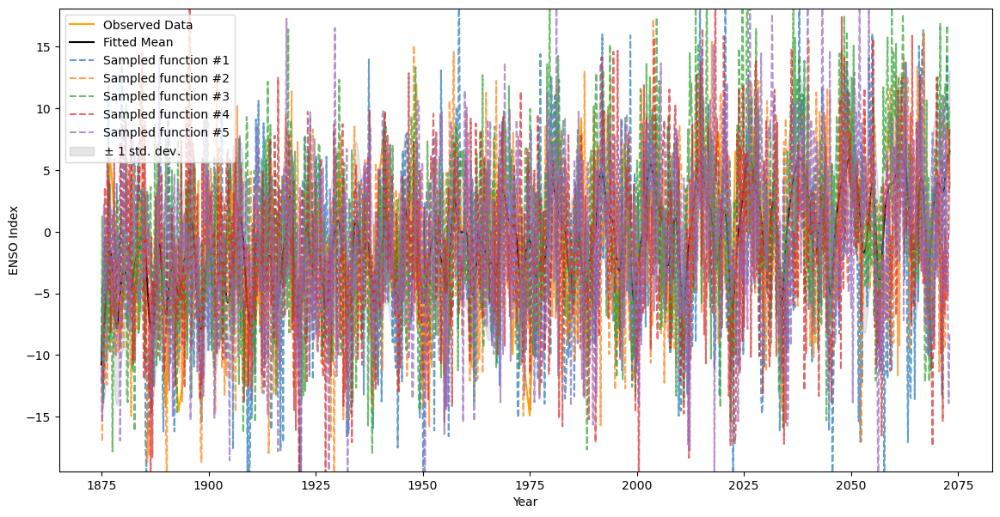

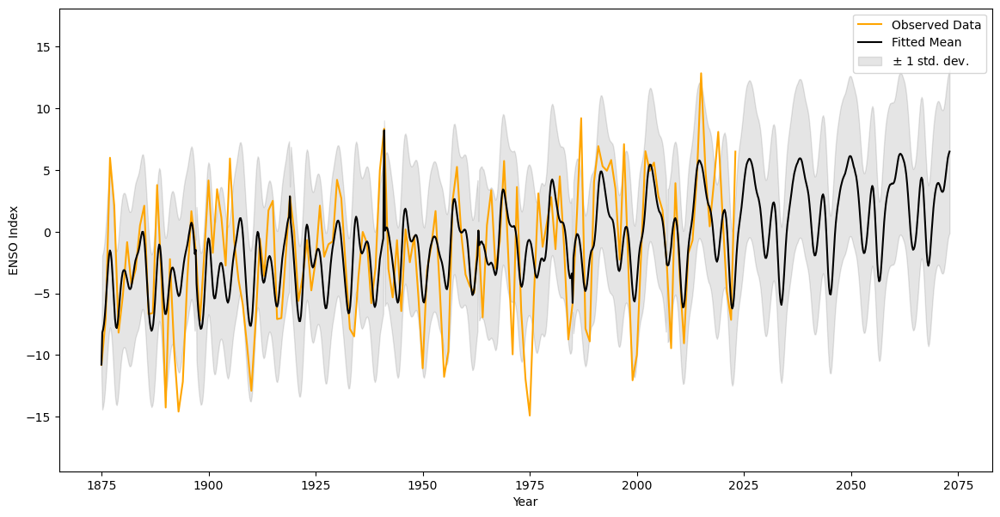

Mean Squared Error (MSE): 0.002470102048049104
Root Mean Squared Error (RMSE): 0.04970012120758966
Mean Absolute Error (MAE): 0.038359665097736015
R² (R-squared): 0.9999179095982667
Mean CRPS: 0.18192170449952735


In [25]:
from sklearn.gaussian_process.kernels import DotProduct, ConstantKernel as C, RBF, Matern, WhiteKernel

# Initialize polynomial features (adjust degree as needed)
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the kernel function with initial parameters
def create_kernel(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu):
    kernel = (
        C(constant1, (1e-1, 1e1)) * DotProduct(sigma_0=sigma) +
        C(constant2, (1e-3, 1e3)) +
        RBF(length_scale=rbf_length, length_scale_bounds=(1e-2, 1e2)) +
        C(1.0, (1e-1, 1e1)) * Matern(length_scale=matern_length, length_scale_bounds=(1e0, 1e2), nu=nu) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu):
    kernel = create_kernel(period1, period2, period3, rbf_length, matern_length, noise_level, constant1, constant2, sigma, nu)
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    periods = [period1, period2, period3]
    X_periodic = periodic_transform(X, periods)
    X_combined = np.hstack([X, X_periodic])  # Combine original X and periodic X for DotProduct
    X_poly = poly.fit_transform(X_combined)
    gp.fit(X_poly, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rbf_length': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-1, 1e1),
    'constant2': (1e-3, 1e3),
    'sigma': (1e-2, 1e1),
    'nu': (0.5, 2.5)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 100

# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    try:
        for _ in range(50):  # Initial points for Bayesian optimization
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rbf_length": np.random.uniform(1e-2, 1e2),
                    "matern_length": np.random.uniform(1e0, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant1": np.random.uniform(1e-1, 1e1),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "sigma": np.random.uniform(1e-2, 1e1),
                    "nu": np.random.uniform(0.5, 2.5)
                },
                lazy=True
            )
            pbar.update(1)

        optimizer.maximize(
            init_points=20,  # Initial points in maximize
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

        def on_step(instance):
            pbar.update(1)

        # Example of optimizing with progress
        optimizer.maximize(
            init_points=20,  # Initial points in the example optimization
            n_iter=total_iterations,
            acq='ei',
            xi=0.01,
        )
    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
best_kernel = create_kernel(
    best_params['period1'], best_params['period2'], best_params['period3'],
    best_params['rbf_length'], best_params['matern_length'], best_params['noise_level'],
    best_params['constant1'], best_params['constant2'], best_params['sigma'], best_params['nu']
)
gp = GaussianProcessRegressor(kernel=best_kernel, n_restarts_optimizer=10, normalize_y=True)

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_params['period1'], best_params['period2'], best_params['period3']])
X_combined = np.hstack([X, X_periodic])  # Combine original X and periodic X for DotProduct
X_poly = poly.fit_transform(X_combined)
gp.fit(X_poly, y)

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

def evaluate_model(gp, X_poly, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X_poly, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X_poly, y)


  0%|          | 0/150 [00:00<?, ?it/s]

|   iter    |  target   | constant2 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... |
-------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  1        | -230.7    |  833.6    |  2.832    |  7.596    |  1.577    |  3.332    |  5.925    |  11.38    |  32.71    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  2        | -230.9    |  805.5    |  88.8     |  5.898    |  2.043    |  3.58     |  4.862    |  10.07    |  71.45    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  3        | -235.8    |  645.5    |  96.65    |  6.209    |  0.7408   |  3.333    |  6.523    |  10.2     |  93.17    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  4        | -224.4    |  100.6    |  99.41    |  8.202    |  2.125    |  2.195    |  7.069    |  9.061    |  11.72    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  5        | -234.2    |  29.71    |  92.1     |  9.554    |  1.6      |  2.405    |  7.968    |  10.32    |  87.62    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  6        | -222.7    |  169.1    |  49.24    |  0.4571   |  1.227    |  2.617    |  4.85     |  9.11     |  26.04    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  7        | -223.1    |  604.6    |  96.36    |  7.254    |  0.7519   |  3.697    |  7.119    |  11.32    |  18.09    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d

|  8        | -230.0    |  828.9    |  15.91    |  0.1261   |  1.973    |  2.169    |  7.796    |  10.43    |  11.6     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  9        | -229.3    |  597.9    |  40.88    |  1.226    |  1.813    |  3.212    |  5.217    |  9.96     |  34.51    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  10       | -230.5    |  554.0    |  35.97    |  6.101    |  1.51     |  2.328    |  5.091    |  10.28    |  93.97    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  11       | -231.1    |  759.7    |  44.32    |  4.623    |  2.324    |  2.23     |  5.852    |  11.02    |  27.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d

|  12       | -235.8    |  296.8    |  33.62    |  0.7381   |  1.262    |  2.697    |  4.412    |  9.949    |  90.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  13       | -229.6    |  286.7    |  67.5     |  8.952    |  1.751    |  3.54     |  4.105    |  9.038    |  9.774    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  14       | -224.1    |  302.6    |  18.09    |  3.66     |  1.768    |  3.567    |  6.266    |  11.53    |  64.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  15       | -223.1    |  621.2    |  92.06    |  2.139    |  2.482    |  2.422    |  7.126    |  11.02    |  0.02628  |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  16       | -234.7    |  833.4    |  60.7     |  6.36     |  2.303    |  3.104    |  6.012    |  10.12    |  90.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  17       | -222.2    |  47.83    |  62.77    |  4.587    |  1.712    |  3.602    |  5.276    |  11.64    |  82.09    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  18       | -233.8    |  271.7    |  49.18    |  6.2      |  1.131    |  3.187    |  4.286    |  9.142    |  31.27    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pa

|  19       | -236.8    |  413.7    |  63.12    |  3.527    |  0.9958   |  2.011    |  6.941    |  9.753    |  9.66     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  20       | -227.7    |  9.052    |  31.96    |  5.089    |  2.395    |  3.328    |  5.719    |  11.85    |  40.56    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  21       | -228.0    |  634.7    |  37.73    |  7.441    |  1.192    |  3.308    |  4.871    |  9.438    |  85.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  22       | -232.5    |  199.7    |  30.15    |  0.9362   |  0.7394   |  2.057    |  6.099    |  10.97    |  32.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  23       | -234.3    |  83.6     |  3.74     |  9.895    |  1.062    |  3.74     |  4.269    |  9.361    |  34.76    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  24       | -228.6    |  646.4    |  54.92    |  4.275    |  1.59     |  3.257    |  6.176    |  11.39    |  62.41    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  25       | -232.4    |  789.9    |  41.15    |  5.757    |  2.266    |  3.457    |  6.593    |  11.06    |  27.3     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  26       | -221.6    |  745.6    |  19.08    |  1.822    |  1.096    |  3.544    |  7.519    |  10.66    |  27.42    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  27       | -234.0    |  621.7    |  35.91    |  5.564    |  2.356    |  2.519    |  7.733    |  11.63    |  98.51    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  28       | -228.6    |  326.7    |  85.95    |  8.642    |  1.751    |  3.449    |  7.487    |  9.001    |  77.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  29       | -219.9    |  408.8    |  44.97    |  3.658    |  0.8046   |  3.712    |  5.708    |  10.87    |  57.9     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  30       | -229.3    |  478.0    |  40.04    |  4.714    |  1.58     |  2.122    |  6.04     |  10.13    |  30.23    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  31       | -219.9    |  415.2    |  58.3     |  5.847    |  1.408    |  3.541    |  5.082    |  11.4     |  76.46    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d

|  32       | -224.1    |  391.1    |  6.804    |  7.977    |  2.426    |  3.186    |  5.739    |  9.847    |  43.1     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  33       | -231.3    |  792.5    |  64.25    |  8.223    |  1.132    |  3.853    |  7.215    |  9.956    |  58.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  34       | -226.7    |  731.6    |  38.91    |  3.346    |  1.426    |  2.311    |  7.295    |  10.46    |  44.11    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  35       | -232.2    |  792.8    |  68.34    |  0.3667   |  2.292    |  3.108    |  4.412    |  11.43    |  58.66    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  36       | -236.9    |  207.7    |  2.572    |  5.928    |  1.961    |  2.052    |  6.844    |  9.322    |  43.54    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  37       | -233.7    |  262.3    |  74.64    |  0.3225   |  0.8114   |  2.674    |  4.168    |  10.57    |  14.11    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  38       | -229.2    |  934.0    |  14.79    |  9.329    |  1.942    |  3.382    |  7.933    |  10.79    |  20.69    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  39       | -229.3    |  912.8    |  24.08    |  0.1213   |  1.56     |  2.259    |  6.274    |  11.8     |  66.49    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  40       | -233.3    |  921.8    |  1.44     |  4.801    |  1.344    |  3.223    |  7.842    |  10.41    |  51.42    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  41       | -234.2    |  183.3    |  77.82    |  6.209    |  0.6762   |  2.13     |  4.291    |  11.94    |  0.2075   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  42       | -234.5    |  931.6    |  32.5     |  5.999    |  1.848    |  3.179    |  6.22     |  9.277    |  18.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  43       | -230.8    |  529.9    |  57.6     |  2.533    |  0.8984   |  3.235    |  6.649    |  9.628    |  61.61    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  44       | -229.8    |  702.1    |  94.23    |  8.317    |  0.8971   |  2.665    |  7.986    |  9.592    |  99.78    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  45       | -230.2    |  135.4    |  33.8     |  6.992    |  1.793    |  2.274    |  4.751    |  9.212    |  41.52    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  46       | -236.3    |  422.8    |  1.776    |  5.406    |  1.657    |  3.096    |  7.724    |  9.965    |  40.86    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  47       | -234.8    |  142.1    |  94.43    |  4.919    |  1.882    |  3.866    |  4.591    |  10.44    |  87.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  48       | -232.5    |  777.6    |  26.34    |  1.862    |  1.017    |  2.175    |  4.238    |  10.48    |  95.84    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  49       | -224.7    |  927.3    |  11.15    |  6.793    |  2.497    |  3.694    |  6.264    |  11.04    |  0.8839   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  50       | -223.9    |  746.6    |  14.82    |  8.25     |  2.188    |  3.525    |  7.086    |  10.26    |  27.26    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  51       | -229.1    |  417.0    |  72.31    |  0.01114  |  1.105    |  2.294    |  4.369    |  9.559    |  34.56    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  52       | -223.5    |  396.8    |  54.34    |  4.198    |  1.87     |  2.409    |  7.512    |  9.082    |  67.05    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  53       | -230.9    |  417.3    |  56.31    |  1.412    |  0.8962   |  3.601    |  7.873    |  9.94     |  69.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  54       | -231.9    |  876.4    |  89.57    |  0.8596   |  0.5781   |  2.34     |  7.513    |  9.295    |  42.12    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  55       | -223.1    |  957.9    |  53.78    |  6.922    |  1.131    |  3.373    |  7.339    |  9.055    |  75.02    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  56       | -222.9    |  988.9    |  75.07    |  2.812    |  2.079    |  2.206    |  5.792    |  11.73    |  29.37    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  57       | -225.4    |  287.8    |  13.87    |  0.2035   |  1.858    |  2.423    |  5.062    |  10.47    |  5.346    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  58       | -227.8    |  574.1    |  15.53    |  5.897    |  1.9      |  2.205    |  5.656    |  11.08    |  41.42    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  59       | -228.4    |  49.95    |  54.05    |  6.641    |  1.53     |  3.889    |  6.346    |  11.71    |  13.76    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  60       | -222.2    |  139.3    |  80.93    |  3.983    |  0.8307   |  3.855    |  5.391    |  11.25    |  72.6     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  61       | -225.8    |  883.3    |  62.74    |  7.512    |  1.198    |  2.54     |  7.584    |  10.28    |  96.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -234.0    |  663.4    |  62.55    |  1.156    |  2.399    |  2.9      |  6.314    |  10.22    |  23.71    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  63       | -229.8    |  903.4    |  57.79    |  0.03867  |  1.734    |  2.653    |  6.108    |  11.66    |  35.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  64       | -230.3    |  908.5    |  62.71    |  0.1681   |  2.359    |  3.382    |  7.989    |  9.517    |  13.72    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  65       | -223.2    |  932.6    |  69.98    |  0.6693   |  2.011    |  3.508    |  7.692    |  11.13    |  12.44    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  66       | -227.6    |  19.88    |  3.595    |  0.2928   |  0.9924   |  3.72     |  6.155    |  10.66    |  84.2     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pa

|  67       | -232.0    |  124.2    |  28.64    |  5.862    |  2.439    |  3.122    |  4.075    |  11.4     |  23.31    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pa

|  68       | -230.3    |  807.1    |  39.4     |  8.637    |  1.994    |  3.112    |  4.546    |  9.18     |  12.14    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  69       | -228.0    |  44.55    |  11.64    |  2.265    |  1.926    |  3.119    |  4.05     |  9.216    |  96.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
 33%|███▎      | 50/150 [13:51<27:42, 16.63s/it]


|  70       | -233.2    |  568.1    |  21.13    |  2.531    |  1.988    |  2.391    |  6.325    |  11.91    |  84.68    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant2': 415.1565890273027, 'matern_length': 58.296708403269555, 'noise_level': 5.847359306056272, 'nu': 1.4081846746231295, 'period1': 3.5413559200587335, 'period2': 5.082450636688346, 'period3': 11.403661158642782, 'rbf_length': 76.45561347035732}
Best parameters: {'constant2': 415.1565890273027, 'matern_length': 58.296708403269555, 'noise_level': 5.847359306056272, 'nu': 1.4081846746231295, 'period1': 3.5413559200587335, 'period2': 5.082450636688346, 'period3': 11.403661158642782, 'rbf_length': 76.45561347035732}
Optimized kernel: CustomPolynomialKernel() + 0.0316**2 + RBF(length_scale=100) + 0.862**2 * Matern(length_scale=1, nu=1.41) + WhiteKernel(noise_level=0.0968)
Log-marginal-likelihood: -222.05365626704418


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


TypeError: plot_gpr_samples() missing 1 required positional argument: 'periods'

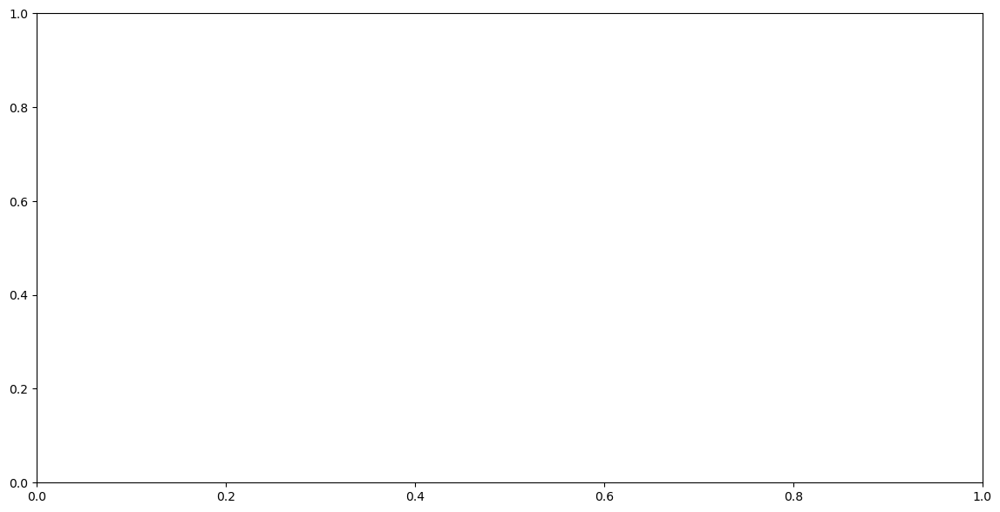

In [28]:
from sklearn.gaussian_process.kernels import Kernel, RBF, Matern, WhiteKernel, ConstantKernel as C

class CustomPolynomialKernel(Kernel):
    def __init__(self, degree=2, periods=[1, 1, 1], include_bias=False):
        self.degree = degree
        self.periods = periods
        self.include_bias = include_bias
        self.poly = PolynomialFeatures(degree=self.degree, include_bias=self.include_bias)
    
    def periodic_transform(self, X):
        return np.hstack([np.cos(2 * np.pi * X / p) for p in self.periods] +
                         [np.sin(2 * np.pi * X / p) for p in self.periods])
    
    def __call__(self, X, Y=None, eval_gradient=False):
        X_transformed = self.periodic_transform(X)
        if Y is None:
            Y_transformed = X_transformed
        else:
            Y_transformed = self.periodic_transform(Y)
        
        K = self.poly.fit_transform(X_transformed).dot(self.poly.fit_transform(Y_transformed).T)
        
        if eval_gradient:
            # Gradient is not implemented
            K_gradient = np.zeros((X_transformed.shape[0], Y_transformed.shape[0], 0))
            return K, K_gradient
        else:
            return K
    
    def diag(self, X):
        return np.diag(self.__call__(X))
    
    def is_stationary(self):
        return False

# Define the kernel function with initial parameters
def create_kernel(degree, periods, rbf_length, matern_length, noise_level, constant2, nu):
    custom_poly_kernel = CustomPolynomialKernel(degree=degree, periods=periods)
    original_kernel = (
        C(constant2, (1e-3, 1e3)) +
        RBF(length_scale=rbf_length, length_scale_bounds=(1e-2, 1e2)) +
        C(1.0, (1e-1, 1e1)) * Matern(length_scale=matern_length, length_scale_bounds=(1e0, 1e2), nu=nu) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return custom_poly_kernel + original_kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rbf_length, matern_length, noise_level, constant2, nu):
    periods = [period1, period2, period3]
    kernel = create_kernel(degree=2, periods=periods, rbf_length=rbf_length, matern_length=matern_length, noise_level=noise_level, constant2=constant2, nu=nu)
    
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    gp.fit(X, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rbf_length': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant2': (1e-3, 1e3),
    'nu': (0.5, 2.5)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 150

# Define a progress bar for the optimization process
with tqdm(total=total_iterations) as pbar:
    try:
        # Initial points for Bayesian optimization
        for _ in range(50):
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rbf_length": np.random.uniform(1e-2, 1e2),
                    "matern_length": np.random.uniform(1e0, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "nu": np.random.uniform(0.5, 2.5)
                },
                lazy=True
            )
            pbar.update(1)

        # Initial points in maximize, iterations
        optimizer.maximize(
            init_points=20,
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Fit the model
gp.fit(X, y)

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]), n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]), n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

def evaluate_model(gp, X, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    # Assuming crps_gaussian is defined elsewhere
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X, y)


In [33]:
best_params

{'constant2': 415.1565890273027,
 'matern_length': 58.296708403269555,
 'noise_level': 5.847359306056272,
 'nu': 1.4081846746231295,
 'period1': 3.5413559200587335,
 'period2': 5.082450636688346,
 'period3': 11.403661158642782,
 'rbf_length': 76.45561347035732}

In [ ]:
# Define the function to evaluate the model
def evaluate_model(gp, X, y, custom_poly_kernel):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    # Transform X using the same transformation as during fitting
    X_transformed = custom_poly_kernel.periodic_transform(X)
    
    y_pred, y_std = gp.predict(X_transformed, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    # Assuming crps_gaussian is defined elsewhere
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

# Plotting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

# Evaluate the model
mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X, y, custom_kernel)


Optimized kernel: CustomPolynomialKernel() + 0.0316**2 + RBF(length_scale=100) + 0.862**2 * Matern(length_scale=1, nu=1.41) + WhiteKernel(noise_level=0.0968)
Log-marginal-likelihood: -222.05365626704418
Best parameters: {'constant2': 415.1565890273027, 'matern_length': 58.296708403269555, 'noise_level': 5.847359306056272, 'nu': 1.4081846746231295, 'period1': 3.5413559200587335, 'period2': 5.082450636688346, 'period3': 11.403661158642782, 'rbf_length': 76.45561347035732}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel: CustomPolynomialKernel() + 0.0316**2 + RBF(length_scale=1.12) + 0.316**2 * Matern(length_scale=100, nu=1.41) + WhiteKernel(noise_level=0.623)
Log-marginal-likelihood: -300.19590595815316
X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


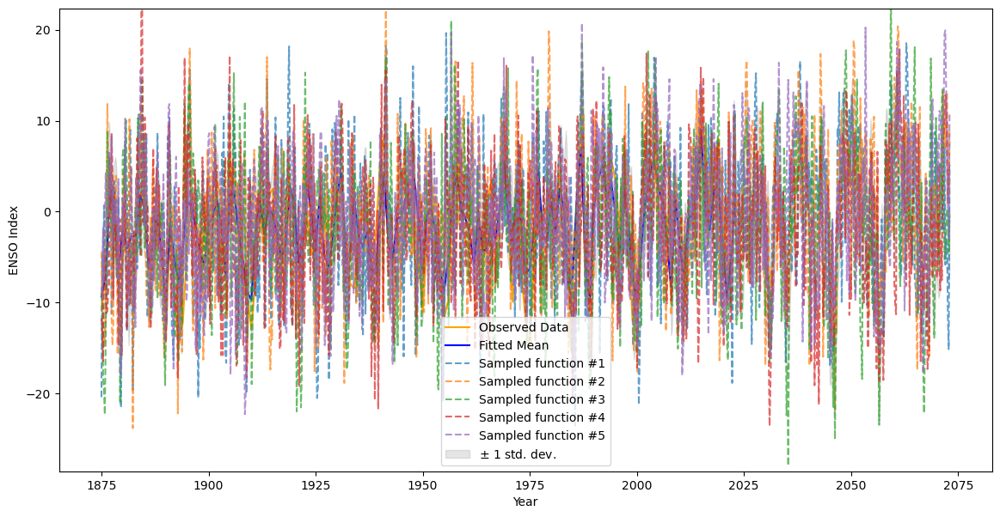

X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


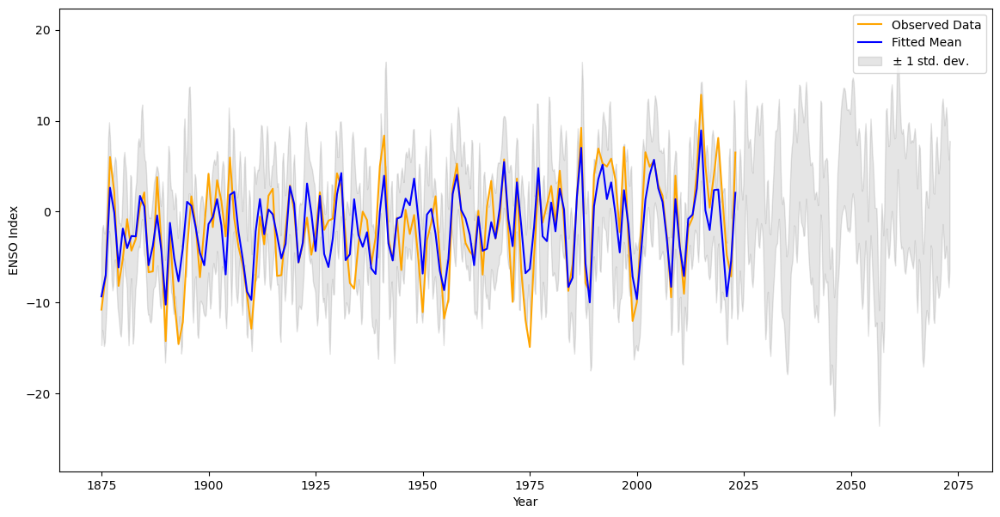

ValueError: X has 1 features, but GaussianProcessRegressor is expecting 6 features as input.

In [34]:
# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X before fitting
X_transformed = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]).periodic_transform(X)

# Fit the model
gp.fit(X_transformed, y)

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

# Plotting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()



def evaluate_model(gp, X, y):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    y_pred, y_std = gp.predict(X, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    # Assuming crps_gaussian is defined elsewhere
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X, y)

Best parameters: {'constant2': 415.1565890273027, 'matern_length': 58.296708403269555, 'noise_level': 5.847359306056272, 'nu': 1.4081846746231295, 'period1': 3.5413559200587335, 'period2': 5.082450636688346, 'period3': 11.403661158642782, 'rbf_length': 76.45561347035732}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


Optimized kernel: CustomPolynomialKernel() + 0.0316**2 + RBF(length_scale=1.12) + 0.316**2 * Matern(length_scale=38.5, nu=1.41) + WhiteKernel(noise_level=0.623)
Log-marginal-likelihood: -300.19592560589376
X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


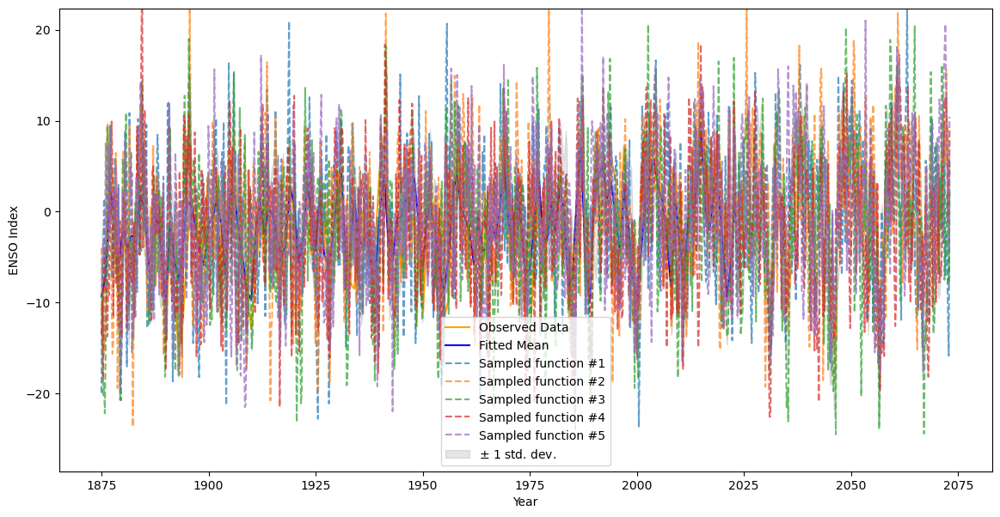

X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


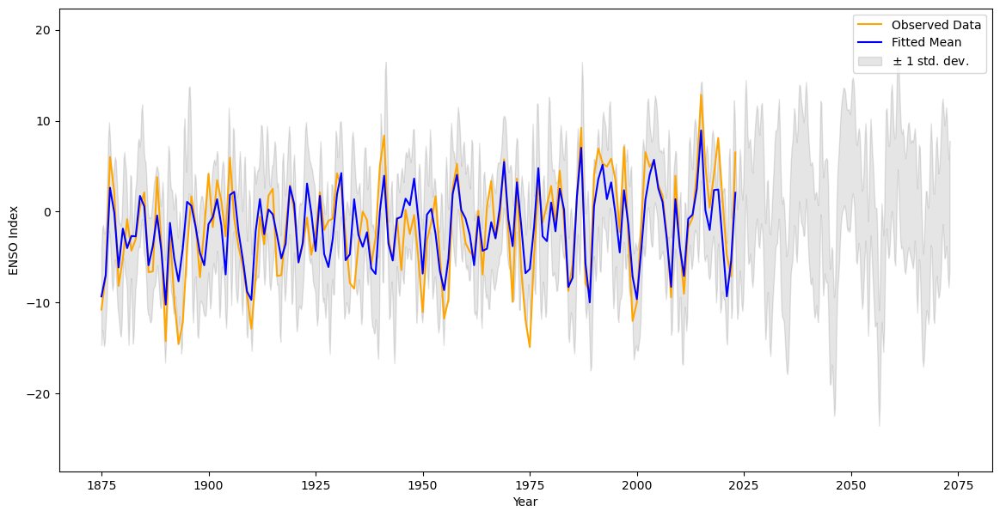

Mean Squared Error (MSE): 9.883967220249582
Root Mean Squared Error (RMSE): 3.1438777362120147
Mean Absolute Error (MAE): 2.5077981329284786
R² (R-squared): 0.6715201137254899
Mean CRPS: 1.9244101050967273


In [35]:
def evaluate_model(gp, X, y, custom_poly_kernel):
    """Evaluate the Gaussian Process model using various metrics including CRPS."""
    # Transform X using the same transformation as during fitting
    X_transformed = custom_poly_kernel.periodic_transform(X)
    
    y_pred, y_std = gp.predict(X_transformed, return_std=True)
    
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    # Assuming crps_gaussian is defined elsewhere
    crps_values = crps_gaussian(y, mu=y_pred, sig=y_std)
    crps_mean = np.mean(crps_values)
    
    print(f"Mean Squared Error (MSE): {mse}")
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    print(f"Mean Absolute Error (MAE): {mae}")
    print(f"R² (R-squared): {r2}")
    print(f"Mean CRPS: {crps_mean}")
    
    return mse, rmse, mae, r2, crps_mean

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X before fitting
X_transformed = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]).periodic_transform(X)

# Fit the model
gp.fit(X_transformed, y)

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood_value_)

# Plotting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

# Evaluate the model
mse, rmse, mae, r2, crps_mean = evaluate_model(gp, X, y, custom_kernel)

### bayesian for opt

X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


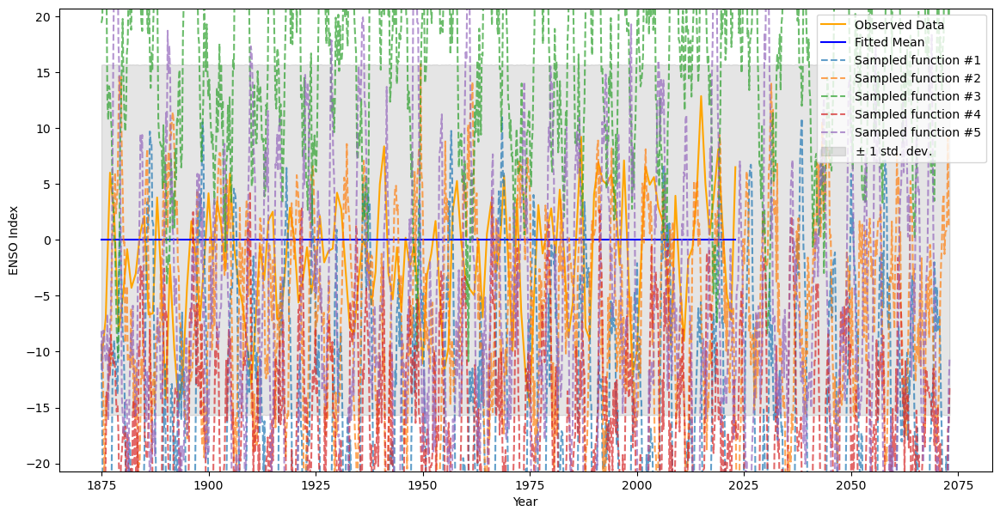

X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


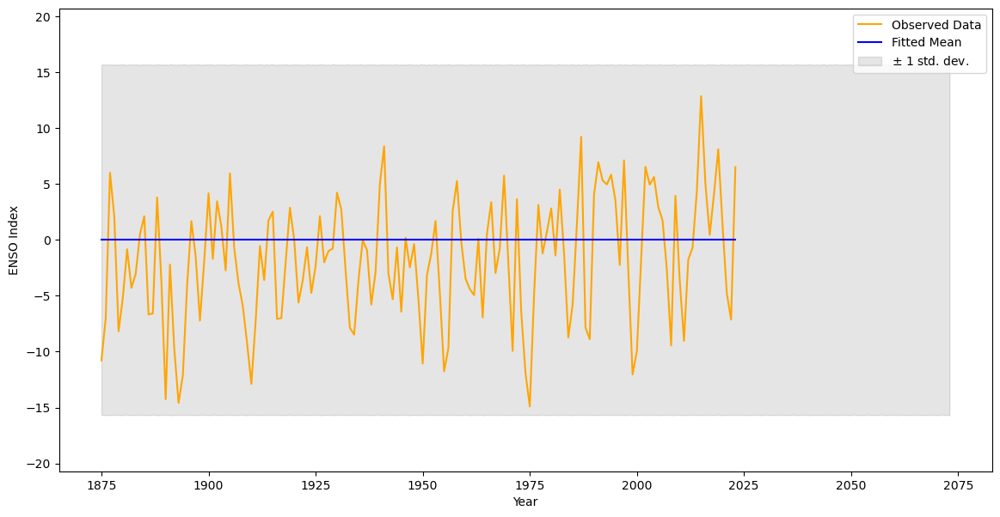

Mean Squared Error (MSE): 33.4403966442953
Root Mean Squared Error (RMSE): 5.782767213393195
Mean Absolute Error (MAE): 4.665436241610738
R² (R-squared): -0.11134501379045014


In [45]:
# print("Optimized kernel:", gp.kernel_)
# print("Log-marginal-likelihood:", gp.log_marginal_likelihood())
# Plotting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

# Evaluate the model
mse, rmse, mae, r2 = evaluate_model(gp, X, y, custom_kernel)

Best parameters: {'constant2': 49.95440899262821, 'matern_length': 54.053744185635644, 'noise_level': 6.64130850574569, 'nu': 1.5297782241166171, 'period1': 3.889189511981627, 'period2': 6.346220162007972, 'period3': 11.71020574586365, 'rbf_length': 13.75609566758229}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


Optimized kernel: CustomPolynomialKernel() + 7.07**2 + RBF(length_scale=13.8) + 1**2 * Matern(length_scale=54.1, nu=1.53) + WhiteKernel(noise_level=6.64)
X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


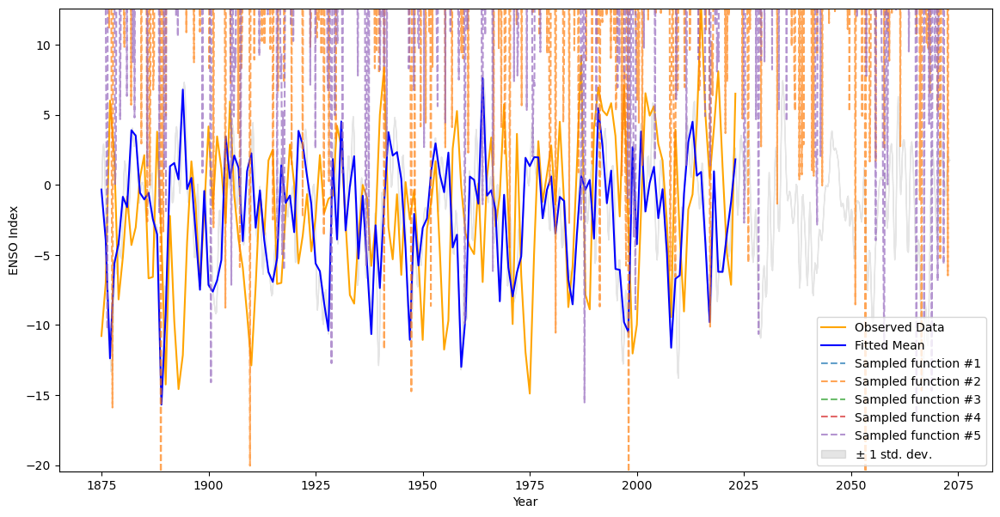

X shape: (149, 1)
X_transformed shape: (149, 6)
X_poly_pred shape: (1000, 6)


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


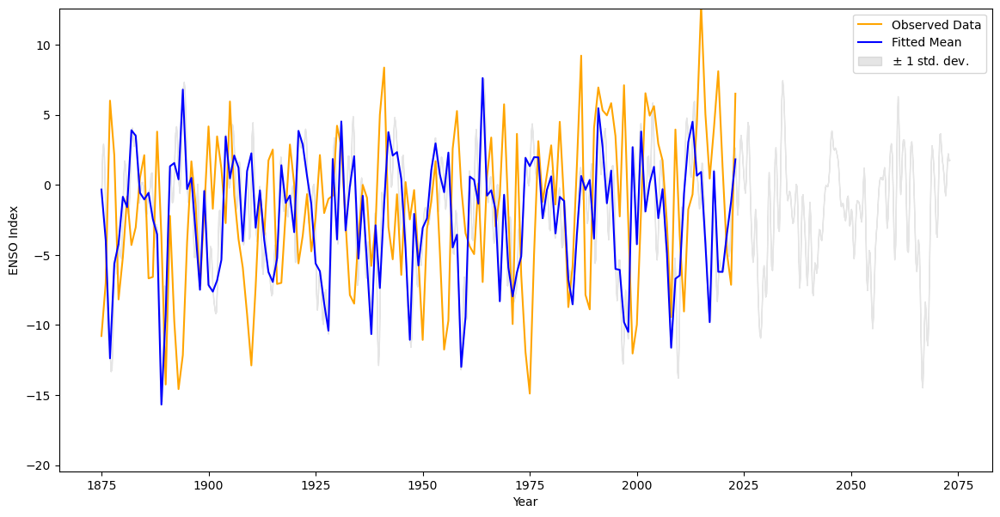

Mean Squared Error (MSE): 52.31880710359098
Root Mean Squared Error (RMSE): 7.233174068387334
Mean Absolute Error (MAE): 5.88969588233015
R² (R-squared): -0.7387426955642649


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:479: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


In [48]:
# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
gp.fit(X_transformed, y)
# Directly assign the kernel without fitting
gp.kernel_ = kernel

# Output optimized kernel parameters
print("Optimized kernel:", gp.kernel_)

custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

# Evaluate the model
mse, rmse, mae, r2 = evaluate_model(gp, X, y, custom_kernel)


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


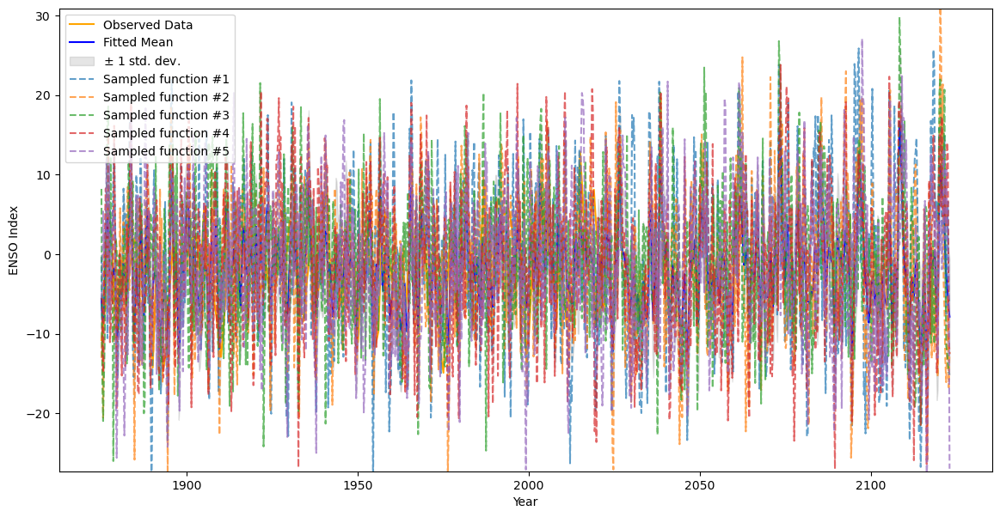

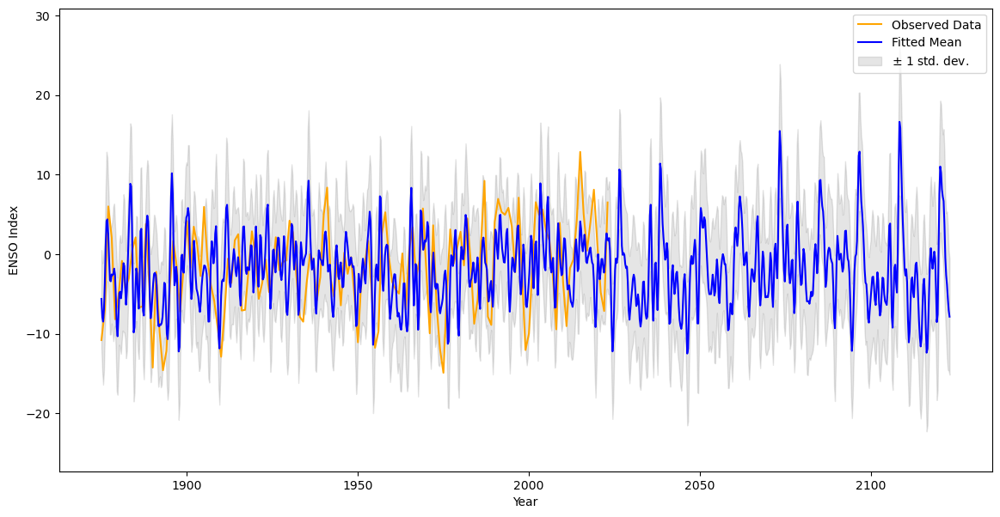

In [53]:
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X_transformed = custom_kernel.periodic_transform(X)
gp.fit(X_transformed, y)

X_range = (X.min(), X.max() + 100)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=X_range, ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()


In [9]:
best_params = {
    'constant2': 415.1565890273027,
    'matern_length': 58.296708403269555,
    'noise_level': 5.847359306056272,
    'nu': 1.4081846746231295,
    'period1': 3.5413559200587335,
    'period2': 5.082450636688346,
    'period3': 11.403661158642782,
    'rbf_length': 76.45561347035732
}

#### visualization for poster

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

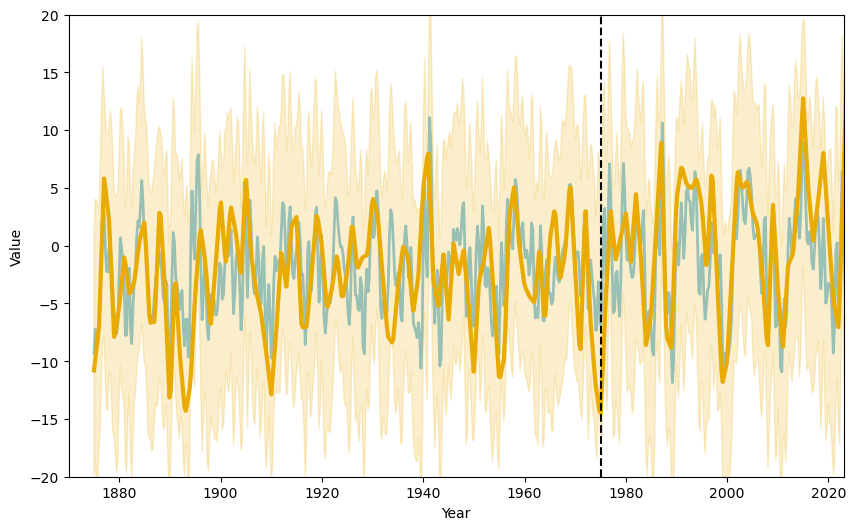

In [26]:
from scipy.interpolate import interp1d

def plot_gpr_samples(gp, path, X, y, custom_poly_kernel, periods, n_samples=0, X_range=(0,1), ax=None):
    """Plot samples drawn from the Gaussian process model and the fitted data."""
    X_pred = np.linspace(X_range[0], X_range[1], 1000).reshape(-1, 1)
    X_poly_pred = custom_poly_kernel.periodic_transform(X_pred)

    # Ensure that we transform X to the same feature space used during fitting
    X_transformed = custom_poly_kernel.periodic_transform(X)

    y_mean, y_std = gp.predict(X_poly_pred, return_std=True)
    y_samples = gp.sample_y(X_poly_pred, n_samples)
    interp_func = interp1d(X.flatten(), y, kind='linear', fill_value="extrapolate")
    y_interp = interp_func(X_pred.ravel())

    # Plot the original data points and the fitted curve
    if ax is None:
        ax = plt.gca()
    
    def rgb_to_normalized(rgb):
        return [x / 255.0 for x in rgb]


    ax.fill_between(
        X_pred.ravel(),
        y_mean - 1.96 * y_std,
        y_mean + 1.96 * y_std,
        alpha=0.2,
        color=rgb_to_normalized((234,171,0)),
        label=r"$\pm$ 1 std. dev.",
    )
    # Predicting using the transformed X
    y_mean_train, y_std_train = gp.predict(X_transformed, return_std=True)
    
    # Ensure we plot the entire prediction range including future 50 years
    ax.plot(X_pred.ravel(), y_mean, color=rgb_to_normalized((8,124,148)), lw=2, label="Fitted Mean", alpha=0.4)
    ax.plot(X_pred.ravel(), y_interp, color=rgb_to_normalized((234,171,0)), label='Observed Data', lw=3)


    for idx, single_prior in enumerate(y_samples.T):
        ax.plot(
            X_pred.ravel(),
            single_prior,
            linestyle="--",
            alpha=0.7,
            label=f"Sampled function #{idx + 1}",
        )

    ax.set_xlim(1870, 2023)
    ax.axvline(x=1975, color='black', linestyle='--', label='1975')

    ax.set_xlabel("Year")
    ax.set_ylabel("Value")
    ax.set_ylim(-20, 20)
    plt.savefig(path, format='svg', bbox_inches='tight') 

# best_params = {
#     'constant2': 415.1565890273027,
#     'matern_length': 58.296708403269555,
#     'noise_level': 5.847359306056272,
#     'nu': 1.4081846746231295,
#     'period1': 3.5413559200587335,
#     'period2': 5.082450636688346,
#     'period3': 11.403661158642782,
#     'rbf_length': 76.45561347035732
# }

kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rbf_length=best_params['rbf_length'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant2=best_params['constant2'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X = enso_data['Year'].values.reshape(-1, 1)
y = enso_data['Value'].values
X_transformed = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]).periodic_transform(X)
gp.fit(X_transformed, y)


gp.fit(X_transformed, y)

# print("Optimized kernel:", gp.kernel_)
# print("Log-marginal-likelihood:", gp.log_marginal_likelihood())

# Ensure X_range includes the entire prediction range
X_range = (X.min(), X.max() + 100)


fig, ax = plt.subplots(figsize=(10, 6))
plot_gpr_samples(gp, '../poster/plot/result/enso.svg',  X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()

### default optimizer

  0%|          | 0/2500 [00:00<?, ?it/s]d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
  0%|          | 1/2500 [00:01<59:31,  1.43s/it]d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
  0%|          | 2/2500 [00:03<1:02:59,  1.51s/it]d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORM

Best Period1: 5.6938775510204085, Best Period2: 10.204081632653061, Best LML: -1041.0041730224318


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


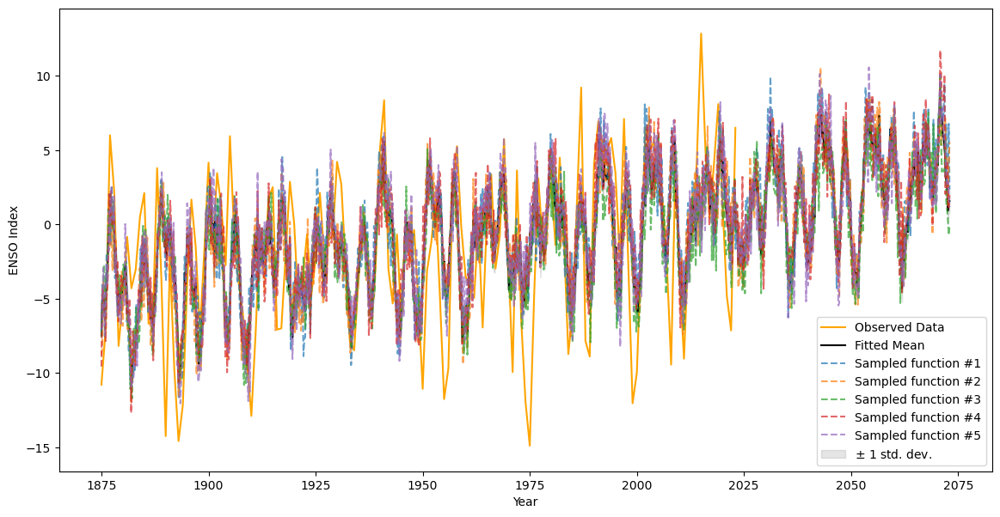

In [94]:
# Define the periods as parameters to be optimized
period1_bounds = (3.0, 7.0)
period2_bounds = (10.0, 12.0)

# Initial guesses for the periods
period1_initial = 5.0
period2_initial = 11.0

# Transform the input data to include periodic components
X_periodic = periodic_transform(X, [period1_initial, period2_initial])

# Combine original and periodic features
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))

# Define the kernel with a noise term and a coefficient for DotProduct
kernel = C(1.0, (1e-1, 1e1)) * DotProduct(sigma_0=1.0) + C(1.0, (1e-3, 1e3)) + RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))

# Initialize Gaussian Process model
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e0)

# Perform Maximum Likelihood Estimation for periods
log_marginal_likelihood = []
period1_range = np.linspace(period1_bounds[0], period1_bounds[1], 50)
period2_range = np.linspace(period2_bounds[0], period2_bounds[1], 50)

# Add progress bar
total_iterations = len(period1_range) * len(period2_range)
with tqdm(total=total_iterations) as pbar:
    for period1 in period1_range:
        for period2 in period2_range:
            X_periodic = periodic_transform(X, [period1, period2])
            X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
            try:
                gp.fit(X_poly, y)
                lml = gp.log_marginal_likelihood()
                log_marginal_likelihood.append((period1, period2, lml))
            except Exception as e:
                log_marginal_likelihood.append((period1, period2, -np.inf))
            pbar.update(1)

# Find the best periods
best_period1, best_period2, best_lml = max(log_marginal_likelihood, key=lambda x: x[2])
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}, Best LML: {best_lml}")

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_period1, best_period2])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()


In [7]:
best_params = optimizer.max['params']
best_period1 = best_params['period1']
best_period2 = best_params['period2']
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}")

Best Period1: 5.764786766859142, Best Period2: 11.374826065664918


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


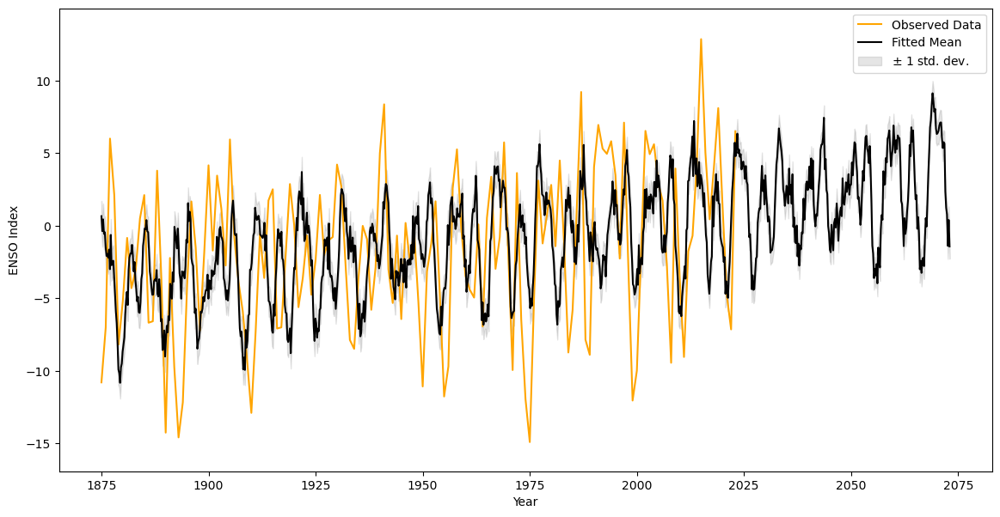

In [96]:
fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2], n_samples=0, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

Best Period1: 5.6938775510204085, Best Period2: 10.204081632653061, Best LML: -1041.0041730224318


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:663: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\_gpr.py:526: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  y_samples = rng.multivariate_normal(y_mean, y_cov, n_samples).T


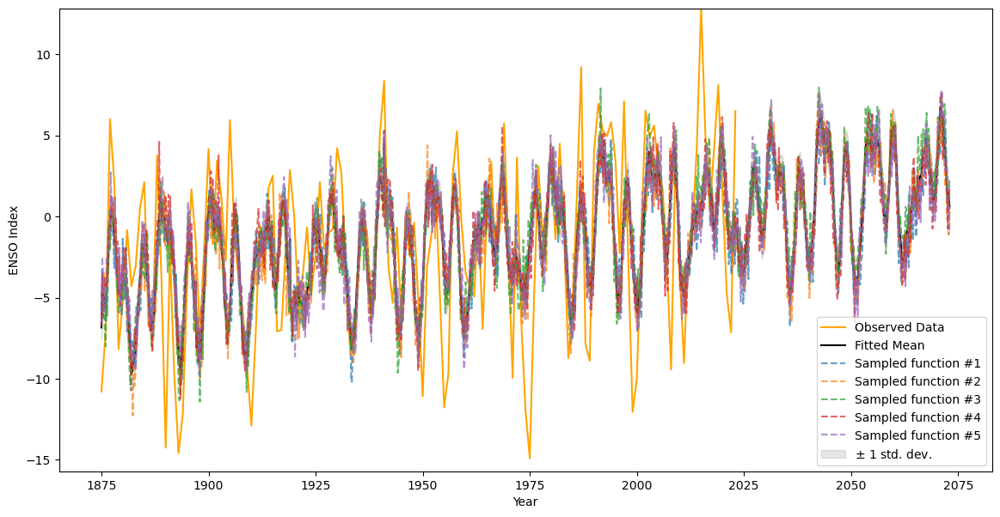

Mean Squared Error (MSE): 5.50607924228887
Root Mean Squared Error (RMSE): 2.346503620770458
Mean Absolute Error (MAE): 1.8937549031624137
R² (R-squared): 0.8170131240803712


In [97]:
best_period1, best_period2, best_lml = max(log_marginal_likelihood, key=lambda x: x[2])
print(f"Best Period1: {best_period1}, Best Period2: {best_period2}, Best LML: {best_lml}")

# Plot the prediction with the best periods
X_periodic = periodic_transform(X, [best_period1, best_period2])
X_poly = poly.fit_transform(np.hstack([X, X_periodic]))
gp.fit(X_poly, y)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, poly, [best_period1, best_period2], n_samples=5, X_range=(X.min(), X.max() + 50), ax=ax)
plt.show()

# Evaluate the model
y_pred, y_std = gp.predict(X_poly, return_std=True)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y, y_pred)
r2 = r2_score(y, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R² (R-squared): {r2}")

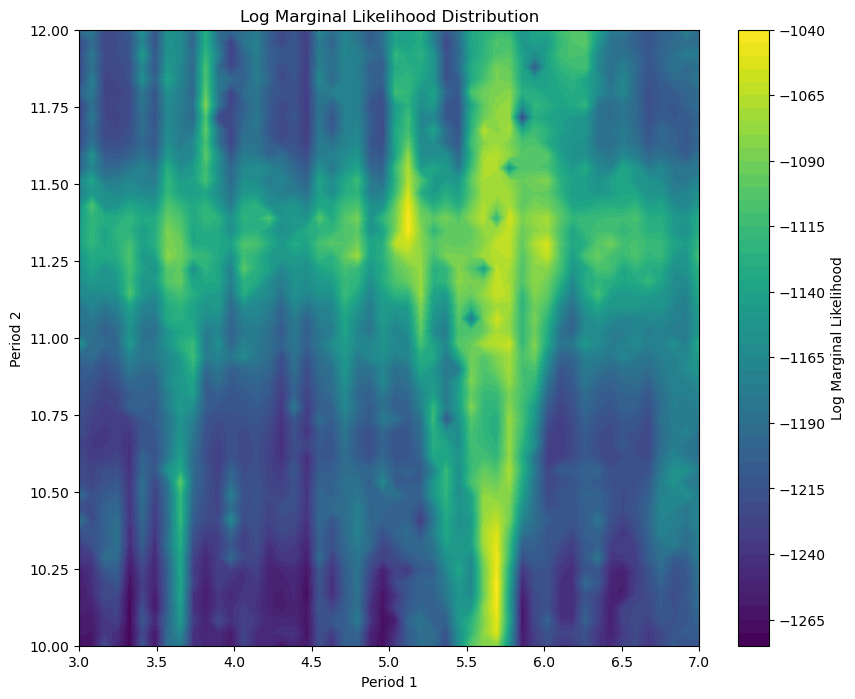

In [99]:
# Extract period1, period2, and LML values from log_marginal_likelihood
period1_values = [item[0] for item in log_marginal_likelihood]
period2_values = [item[1] for item in log_marginal_likelihood]
lml_values = [item[2] for item in log_marginal_likelihood]

# Reshape the LML values to a 2D array
period1_unique = np.unique(period1_values)
period2_unique = np.unique(period2_values)
lml_matrix = np.reshape(lml_values, (len(period1_unique), len(period2_unique)))

# Plot LML distribution
plt.figure(figsize=(10, 8))
plt.contourf(period1_unique, period2_unique, lml_matrix.T, levels=50, cmap='viridis')
plt.colorbar(label='Log Marginal Likelihood')
plt.xlabel('Period 1')
plt.ylabel('Period 2')
plt.title('Log Marginal Likelihood Distribution')
plt.show()


## other kernels

In [58]:
best_params

{'constant1': 585.7596856990164,
 'constant2': 969.5957787239262,
 'constant3': 561.0306582254907,
 'matern_length': 2.846081647921359,
 'noise_level': 8.008320400079358,
 'nu': 0.9659485476820409,
 'period1': 3.6142103912375583,
 'period2': 5.551442576256687,
 'period3': 11.590625563678286,
 'rq_alpha': 74.71469305729109}

d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.1. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklear

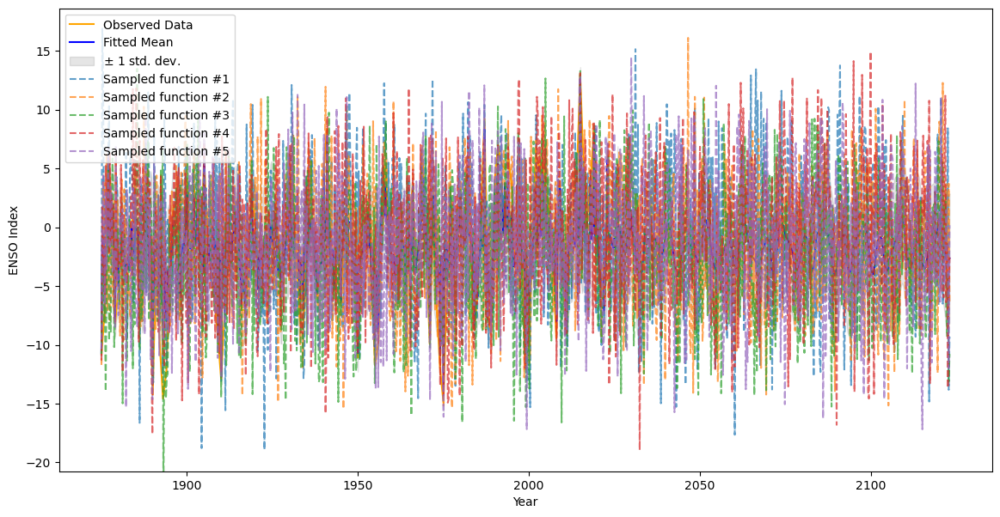

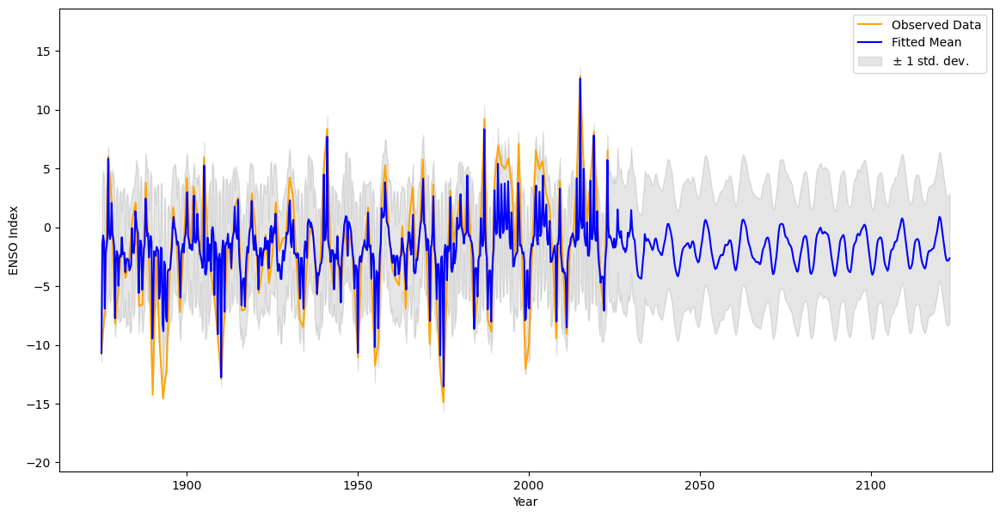

In [63]:
# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X_transformed = custom_kernel.periodic_transform(X)
gp.fit(X_transformed, y)
X_range = (X.min(), X.max() + 100)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=X_range, ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()

In [62]:
print("Optimized kernel:", gp.kernel_)
print("Log-marginal-likelihood:", gp.log_marginal_likelihood())

Optimized kernel: 0.0316**2 * CustomPolynomialKernel() + 0.958**2 * RationalQuadratic(alpha=100, length_scale=0.229) + 0.316**2 * Matern(length_scale=100, nu=0.966) + WhiteKernel(noise_level=0.01)
Log-marginal-likelihood: -209.26671894448054


  0%|          | 0/150 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  1        | -214.7    |  825.1    |  910.2    |  464.9    |  707.3    |  957.9    |  45.58    |  0.9218   |  0.5692   |  2.469    |  4.404    |  10.22    |  62.03    |  98.31    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  2        | -213.7    |  379.8    |  213.1    |  828.6    |  646.9    |  235.2    |  17.61    |  7.277    |  1.801    |  3.414    |  6.521    |  10.85    |  78.47    |  28.85    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  3        | -212.0    |  940.8    |  424.0    |  92.34    |  625.2    |  388.8    |  53.58    |  0.8472   |  1.368    |  3.054    |  5.577    |  10.48    |  71.88    |  27.66    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  4        | -214.8    |  5.501    |  491.2    |  350.8    |  919.1    |  500.1    |  78.62    |  1.853    |  2.15     |  3.918    |  4.792    |  10.06    |  94.41    |  94.32    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages

|  5        | -211.7    |  58.39    |  929.7    |  721.2    |  976.6    |  264.7    |  61.07    |  8.425    |  2.363    |  2.177    |  6.106    |  9.083    |  92.6     |  94.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  6        | -211.5    |  325.4    |  733.7    |  428.2    |  524.6    |  964.2    |  90.73    |  8.984    |  0.5515   |  2.427    |  4.085    |  10.58    |  25.78    |  21.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  7        | -211.0    |  663.9    |  339.7    |  601.3    |  408.7    |  315.3    |  42.99    |  4.263    |  0.8309   |  3.649    |  7.522    |  11.77    |  79.51    |  53.3     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  8        | -212.7    |  385.7    |  960.7    |  759.2    |  407.1    |  446.6    |  68.03    |  0.4509   |  1.96     |  3.265    |  7.837    |  10.72    |  27.27    |  95.53    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  9        | -214.8    |  161.8    |  165.9    |  159.1    |  11.72    |  140.3    |  67.91    |  9.338    |  0.5346   |  2.331    |  7.461    |  9.28     |  63.14    |  85.65    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  10       | -213.6    |  116.7    |  212.9    |  205.6    |  410.9    |  127.6    |  8.56     |  0.9264   |  1.24     |  2.893    |  7.195    |  9.458    |  6.823    |  29.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  11       | -212.4    |  11.0     |  724.0    |  854.8    |  3.563    |  158.9    |  97.03    |  3.179    |  1.541    |  3.009    |  5.606    |  9.591    |  45.79    |  67.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  12       | -214.7    |  812.6    |  216.7    |  594.1    |  518.1    |  877.6    |  97.76    |  8.176    |  0.8311   |  3.01     |  4.635    |  9.551    |  73.0     |  41.01    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  13       | -214.3    |  498.9    |  616.4    |  304.5    |  357.9    |  540.0    |  65.19    |  5.45     |  2.164    |  2.531    |  5.553    |  11.99    |  16.84    |  77.88    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  14       | -214.8    |  748.2    |  154.4    |  534.3    |  275.5    |  938.6    |  36.02    |  2.955    |  0.686    |  2.374    |  6.723    |  10.14    |  37.17    |  66.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  15       | -209.9    |  258.3    |  678.2    |  320.4    |  392.1    |  959.9    |  72.57    |  3.099    |  1.09     |  3.244    |  7.309    |  11.28    |  94.45    |  90.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  16       | -214.9    |  90.65    |  997.1    |  526.5    |  598.3    |  839.4    |  48.16    |  7.388    |  2.404    |  3.348    |  4.52     |  9.714    |  71.02    |  55.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  17       | -211.7    |  858.2    |  329.2    |  802.1    |  221.7    |  875.2    |  1.196    |  3.505    |  2.165    |  3.279    |  5.483    |  10.85    |  93.61    |  14.27    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\s

|  18       | -215.1    |  120.7    |  40.47    |  801.6    |  686.1    |  352.2    |  14.6     |  4.897    |  1.773    |  3.307    |  4.034    |  11.87    |  13.55    |  22.7     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  19       | -215.2    |  56.13    |  99.92    |  860.1    |  463.7    |  999.7    |  91.02    |  5.483    |  2.331    |  2.805    |  5.939    |  10.51    |  66.14    |  65.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  20       | -215.3    |  839.7    |  703.7    |  121.7    |  301.4    |  188.5    |  68.61    |  2.302    |  1.509    |  3.706    |  6.803    |  11.73    |  64.55    |  91.22    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  21       | -213.3    |  551.5    |  613.6    |  652.4    |  355.4    |  787.2    |  9.187    |  8.477    |  2.316    |  2.255    |  7.11     |  10.47    |  71.25    |  7.417    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  22       | -216.3    |  179.6    |  90.15    |  577.5    |  942.3    |  382.0    |  43.55    |  0.06315  |  2.129    |  3.442    |  6.691    |  9.628    |  27.11    |  56.69    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  23       | -215.9    |  696.6    |  366.0    |  370.4    |  337.7    |  591.7    |  49.55    |  5.58     |  1.742    |  2.213    |  5.856    |  10.18    |  13.7     |  28.62    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  24       | -213.7    |  525.9    |  757.6    |  102.7    |  993.4    |  857.4    |  15.29    |  7.853    |  1.225    |  3.788    |  4.805    |  10.69    |  87.91    |  95.69    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  25       | -215.4    |  477.7    |  100.7    |  823.3    |  222.9    |  508.3    |  13.36    |  8.014    |  1.365    |  2.982    |  4.161    |  9.646    |  69.82    |  90.23    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  26       | -213.2    |  696.6    |  859.2    |  189.5    |  835.8    |  904.7    |  13.96    |  6.21     |  1.348    |  3.337    |  5.365    |  9.403    |  90.04    |  5.424    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  27       | -213.2    |  882.5    |  298.8    |  270.4    |  722.5    |  586.1    |  24.97    |  5.992    |  0.5758   |  2.56     |  6.15     |  11.76    |  11.36    |  84.02    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  28       | -206.5    |  699.0    |  210.8    |  935.6    |  248.7    |  58.73    |  98.95    |  9.5      |  1.748    |  3.577    |  5.736    |  11.76    |  22.87    |  47.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  29       | -211.0    |  611.2    |  777.4    |  774.1    |  821.3    |  721.9    |  97.69    |  9.838    |  1.349    |  2.789    |  4.835    |  11.59    |  86.04    |  65.33    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  30       | -214.4    |  573.8    |  627.7    |  456.4    |  270.3    |  196.3    |  42.5     |  3.253    |  1.644    |  3.294    |  7.877    |  9.329    |  79.94    |  60.12    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  31       | -211.7    |  583.0    |  236.7    |  797.9    |  742.0    |  666.8    |  69.09    |  1.446    |  2.083    |  3.434    |  6.317    |  11.22    |  89.14    |  15.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  32       | -211.5    |  331.3    |  167.8    |  934.2    |  460.7    |  71.18    |  42.0     |  6.652    |  1.281    |  3.09     |  5.158    |  11.43    |  12.31    |  22.04    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  33       | -212.8    |  621.3    |  345.2    |  303.2    |  952.6    |  418.3    |  59.81    |  3.089    |  0.8468   |  3.155    |  5.985    |  11.42    |  8.135    |  61.95    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  34       | -215.5    |  187.4    |  245.3    |  222.4    |  981.6    |  358.3    |  41.76    |  1.285    |  1.005    |  3.269    |  6.826    |  9.985    |  1.716    |  6.933    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  35       | -215.8    |  272.3    |  902.2    |  622.7    |  290.0    |  981.7    |  10.94    |  4.654    |  0.8347   |  3.395    |  4.017    |  9.584    |  4.414    |  92.07    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  36       | -214.8    |  656.6    |  146.0    |  741.5    |  661.5    |  448.2    |  85.26    |  2.133    |  0.9056   |  3.832    |  4.33     |  9.042    |  15.78    |  54.94    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  37       | -210.6    |  869.3    |  378.1    |  801.8    |  719.7    |  490.9    |  7.928    |  9.617    |  1.963    |  3.715    |  5.832    |  11.31    |  71.88    |  48.77    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  38       | -213.7    |  830.5    |  657.5    |  216.5    |  164.9    |  797.0    |  48.78    |  9.974    |  1.914    |  2.644    |  4.128    |  10.63    |  11.04    |  37.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  39       | -212.9    |  983.2    |  18.49    |  265.0    |  532.5    |  752.5    |  16.47    |  2.514    |  1.667    |  3.081    |  6.163    |  11.88    |  97.93    |  30.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  40       | -213.0    |  407.4    |  538.5    |  119.2    |  474.7    |  801.3    |  33.75    |  4.377    |  2.245    |  3.406    |  5.032    |  9.438    |  60.01    |  63.14    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  41       | -213.7    |  184.7    |  836.2    |  319.2    |  286.8    |  200.0    |  75.07    |  9.244    |  1.209    |  2.729    |  6.783    |  11.58    |  14.6     |  34.51    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  42       | -212.4    |  524.6    |  137.8    |  396.5    |  42.64    |  16.23    |  18.82    |  1.621    |  1.257    |  3.356    |  5.739    |  9.988    |  58.92    |  60.7     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  43       | -212.8    |  314.7    |  317.9    |  611.1    |  131.3    |  242.6    |  2.625    |  1.767    |  1.84     |  2.248    |  7.021    |  10.28    |  21.29    |  91.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  44       | -210.9    |  662.3    |  907.9    |  872.8    |  511.2    |  499.9    |  93.77    |  1.418    |  2.131    |  3.355    |  6.013    |  11.24    |  73.94    |  73.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  45       | -214.8    |  550.2    |  898.4    |  678.2    |  313.8    |  479.7    |  48.85    |  5.43     |  2.341    |  2.179    |  7.333    |  9.772    |  85.33    |  0.6431   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  46       | -213.0    |  584.4    |  32.82    |  43.89    |  636.1    |  226.0    |  59.46    |  8.096    |  1.481    |  3.307    |  6.725    |  11.52    |  52.46    |  39.84    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  47       | -213.6    |  601.1    |  446.3    |  160.0    |  513.3    |  936.7    |  54.86    |  1.767    |  2.361    |  3.38     |  4.84     |  10.48    |  25.54    |  82.31    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  48       | -212.3    |  780.4    |  125.1    |  657.8    |  182.2    |  408.8    |  89.07    |  8.44     |  2.256    |  2.071    |  7.312    |  9.573    |  3.814    |  94.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  49       | -214.3    |  611.8    |  848.4    |  207.5    |  568.6    |  771.4    |  15.44    |  7.343    |  2.264    |  2.342    |  7.138    |  9.573    |  29.63    |  9.738    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\s

|  50       | -213.5    |  41.86    |  513.7    |  111.7    |  801.5    |  27.96    |  13.09    |  0.6917   |  2.47     |  2.19     |  5.028    |  9.042    |  97.02    |  18.86    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  51       | -215.4    |  417.0    |  720.3    |  0.1154   |  302.3    |  146.8    |  10.14    |  1.871    |  1.191    |  2.794    |  6.155    |  10.26    |  68.53    |  20.45    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  52       | -212.6    |  878.1    |  27.39    |  670.5    |  417.3    |  558.7    |  14.9     |  1.989    |  2.101    |  3.937    |  5.254    |  11.08    |  87.64    |  89.46    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  53       | -212.3    |  85.05    |  39.06    |  169.8    |  878.1    |  98.35    |  42.69    |  9.579    |  1.566    |  3.384    |  5.262    |  11.06    |  83.46    |  1.839    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  54       | -211.9    |  750.1    |  988.9    |  748.2    |  280.4    |  789.3    |  11.22    |  4.484    |  2.317    |  2.587    |  5.151    |  9.39     |  1.947    |  67.89    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  55       | -207.5    |  211.6    |  265.5    |  491.6    |  53.36    |  574.1    |  15.53    |  5.897    |  1.9      |  2.205    |  5.656    |  11.08    |  41.42    |  5.005    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  56       | -210.7    |  535.9    |  663.8    |  514.9    |  944.6    |  586.6    |  90.44    |  1.383    |  0.7786   |  3.615    |  5.591    |  9.496    |  92.75    |  34.78    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  57       | -212.5    |  750.8    |  726.0    |  883.3    |  623.7    |  750.9    |  35.54    |  2.707    |  2.292    |  2.856    |  7.859    |  10.99    |  62.17    |  11.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  58       | -214.4    |  949.5    |  449.9    |  578.4    |  408.1    |  237.0    |  90.43    |  5.741    |  0.5057   |  3.234    |  5.307    |  10.58    |  88.6     |  35.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  59       | -213.9    |  908.5    |  623.4    |  15.82    |  929.4    |  690.9    |  99.73    |  1.732    |  0.7743   |  3.865    |  6.787    |  9.198    |  75.55    |  75.39    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packag

|  60       | -213.1    |  923.0    |  711.5    |  124.3    |  19.88    |  26.21    |  3.802    |  2.47     |  2.22     |  3.078    |  6.211    |  11.53    |  12.43    |  27.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  61       | -213.2    |  585.8    |  969.6    |  561.0    |  18.65    |  800.6    |  24.06    |  8.073    |  1.276    |  3.727    |  6.988    |  10.67    |  13.65    |  6.001    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -214.5    |  121.3    |  44.55    |  107.5    |  225.7    |  713.0    |  56.41    |  0.1354   |  0.6439   |  3.935    |  6.272    |  9.61     |  25.24    |  74.39    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  63       | -212.9    |  195.4    |  581.4    |  970.0    |  846.8    |  239.8    |  49.88    |  6.203    |  2.158    |  2.314    |  4.074    |  9.21     |  48.64    |  60.64    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  64       | -215.0    |  568.9    |  317.4    |  988.6    |  579.7    |  380.1    |  55.54    |  7.456    |  1.838    |  2.53     |  4.265    |  10.11    |  62.98    |  21.03    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  65       | -212.3    |  752.8    |  66.54    |  260.3    |  804.8    |  193.4    |  64.31    |  5.251    |  2.35     |  2.527    |  4.264    |  11.21    |  77.22    |  90.78    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  66       | -212.7    |  932.0    |  13.95    |  234.4    |  616.8    |  949.0    |  95.07    |  5.571    |  2.331    |  3.283    |  5.56     |  10.46    |  60.44    |  54.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  67       | -214.2    |  926.2    |  918.7    |  394.9    |  963.3    |  174.0    |  13.51    |  1.359    |  1.511    |  2.043    |  7.792    |  11.48    |  1.512    |  17.63    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\

|  68       | -211.8    |  332.1    |  131.0    |  809.5    |  344.7    |  940.1    |  58.62    |  8.79     |  2.189    |  3.811    |  5.84     |  10.64    |  79.86    |  28.58    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  69       | -210.7    |  490.3    |  599.1    |  15.53    |  593.5    |  433.7    |  80.93    |  3.159    |  2.286    |  3.156    |  4.736    |  11.36    |  61.21    |  5.4      |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  70       | -210.7    |  420.2    |  679.1    |  918.6    |  0.403    |  976.8    |  38.28    |  9.738    |  1.709    |  3.658    |  6.299    |  10.88    |  28.56    |  58.69    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant1': 698.9976701999824, 'constant2': 210.83628596358784, 'constant3': 935.648623806612, 'constant4': 248.69058593185576, 'constant5': 58.72500650133108, 'matern_length': 98.94818131693684, 'noise_level': 9.500192207474994, 'nu': 1.7482416361812048, 'period1': 3.5773055872502826, 'period2': 5.736360284919916, 'period3': 11.755370343704065, 'rbf_length': 22.869800048184143, 'rq_alpha': 47.91234156538303}


 33%|███▎      | 50/150 [32:46<1:05:32, 39.32s/it]


Best parameters: {'constant1': 698.9976701999824, 'constant2': 210.83628596358784, 'constant3': 935.648623806612, 'constant4': 248.69058593185576, 'constant5': 58.72500650133108, 'matern_length': 98.94818131693684, 'noise_level': 9.500192207474994, 'nu': 1.7482416361812048, 'period1': 3.5773055872502826, 'period2': 5.736360284919916, 'period3': 11.755370343704065, 'rbf_length': 22.869800048184143, 'rq_alpha': 47.91234156538303}


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

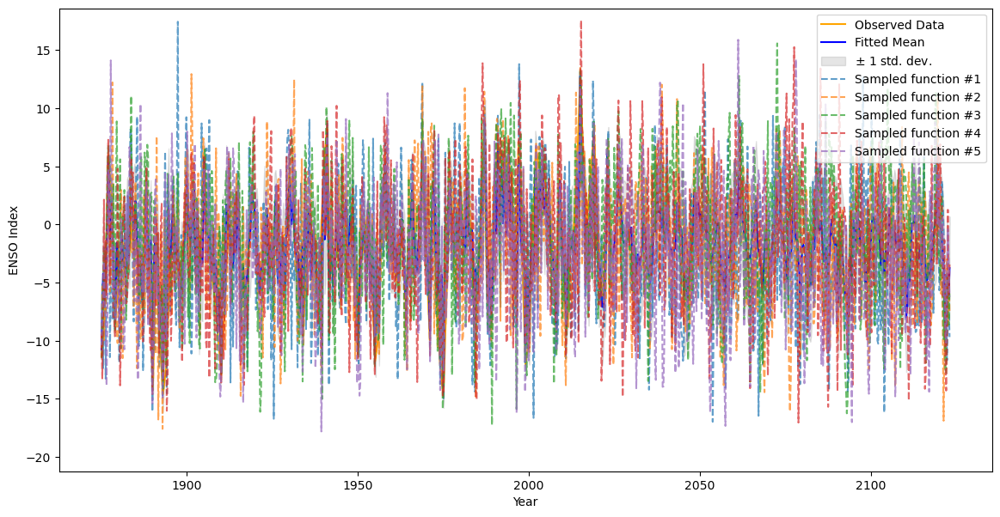

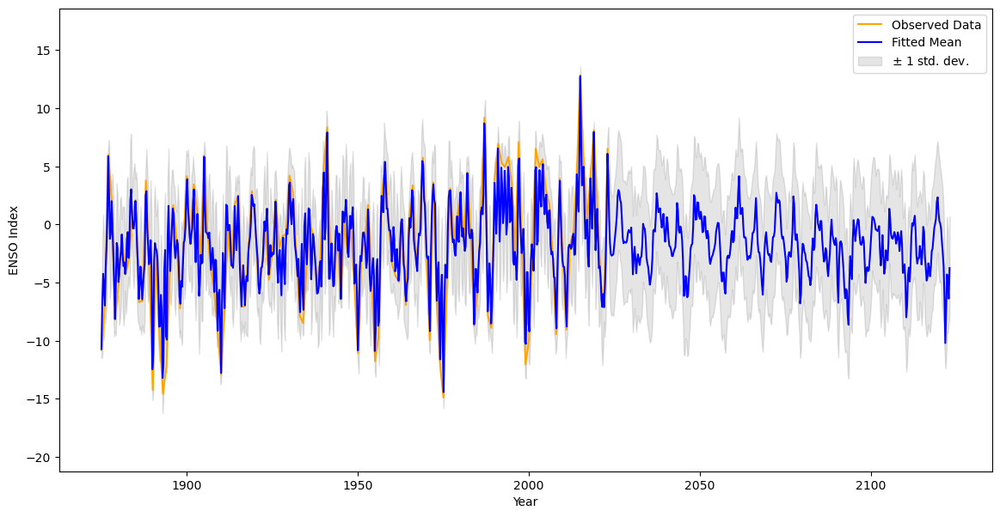

Mean Squared Error (MSE): 0.003420045398133881
Root Mean Squared Error (RMSE): 0.058481154213420594
Mean Absolute Error (MAE): 0.047241828162120234
R² (R-squared): 0.9998863395539059


In [64]:
# Define the kernel function with initial parameters
def create_kernel(degree, periods, rq_alpha, matern_length, noise_level, constant1, constant2, constant3, constant4, constant5, rbf_length, nu):
    custom_poly_kernel = C(constant1, (1e-3, 1e3)) * CustomPolynomialKernel(degree=degree, periods=periods)
    original_kernel = (
        C(constant2, (1e-3, 1e3)) * RQ(length_scale=1.0, alpha=rq_alpha, length_scale_bounds=(1e-2, 1e2), alpha_bounds=(1e-2, 1e2)) +
        C(constant3, (1e-3, 1e3)) * RBF(length_scale=rbf_length, length_scale_bounds=(1e-2, 1e2)) +
        C(constant4, (1e-3, 1e3)) * Matern(length_scale=matern_length, length_scale_bounds=(1e0, 1e2), nu=nu) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return custom_poly_kernel + original_kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rq_alpha, matern_length, noise_level, constant1, constant2, constant3, constant4, constant5, rbf_length, nu):
    kernel = create_kernel(2, [period1, period2, period3], rq_alpha, matern_length, noise_level, constant1, constant2, constant3, constant4, constant5, rbf_length, nu)
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    
    # Transform X using the same transformation as during fitting
    custom_kernel = CustomPolynomialKernel(degree=2, periods=[period1, period2, period3])
    X_transformed = custom_kernel.periodic_transform(X)
    
    gp.fit(X_transformed, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rq_alpha': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'constant4': (1e-3, 1e3),
    'constant5': (1e-3, 1e3),
    'rbf_length': (1e-2, 1e2),
    'nu': (0.5, 2.5)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 150

with tqdm(total=total_iterations) as pbar:
    try:
        # Initial points for Bayesian optimization
        for _ in range(50):
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rq_alpha": np.random.uniform(1e-2, 1e2),
                    "matern_length": np.random.uniform(1e0, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant1": np.random.uniform(1e-3, 1e3),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "constant3": np.random.uniform(1e-3, 1e3),
                    "constant4": np.random.uniform(1e-3, 1e3),
                    "constant5": np.random.uniform(1e-3, 1e3),
                    "rbf_length": np.random.uniform(1e-2, 1e2),
                    "nu": np.random.uniform(0.5, 2.5)
                },
                lazy=True
            )
            pbar.update(1)

        # Initial points in maximize, iterations
        optimizer.maximize(
            init_points=20,
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rq_alpha=best_params['rq_alpha'], matern_length=best_params['matern_length'], noise_level=best_params['noise_level'],
    constant1=best_params['constant1'], constant2=best_params['constant2'], constant3=best_params['constant3'], constant4=best_params['constant4'], constant5=best_params['constant5'], rbf_length=best_params['rbf_length'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Assume the model has been previously fitted and store the gp with best_params
gp.kernel_ = kernel  # Directly assign the optimized kernel

# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X_transformed = custom_kernel.periodic_transform(X)

gp.fit(X_transformed, y)
X_range = (X.min(), X.max() + 100)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=X_range, ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()

# Evaluate the model
mse, rmse, mae, r2 = evaluate_model(gp, X, y, custom_kernel)

# print("Optimized kernel:", gp.kernel_)
# print("Log-marginal-likelihood:", gp.log_marginal_likelihood())

  0%|          | 0/150 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages

|  1        | -214.6    |  181.7    |  504.7    |  746.2    |  68.93    |  8.524    |  2.089    |  3.938    |  6.707    |  9.193    |  59.47    |  95.13    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  2        | -214.9    |  0.8651   |  839.5    |  786.9    |  272.9    |  5.096    |  2.175    |  2.896    |  4.611    |  9.999    |  36.32    |  79.46    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  3        | -213.0    |  114.1    |  805.2    |  460.0    |  34.96    |  8.576    |  2.187    |  2.492    |  4.705    |  11.76    |  64.99    |  66.77    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  4        | -211.8    |  629.4    |  768.9    |  322.2    |  306.5    |  3.148    |  1.281    |  3.641    |  7.321    |  9.181    |  48.52    |  36.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pa

|  5        | -214.7    |  636.2    |  689.7    |  372.9    |  906.2    |  7.262    |  1.808    |  3.321    |  4.4      |  9.397    |  56.29    |  72.9     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  6        | -215.6    |  169.3    |  49.62    |  190.2    |  222.1    |  6.18     |  2.054    |  2.325    |  7.418    |  9.905    |  82.67    |  47.65    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  7        | -214.8    |  337.6    |  853.9    |  401.3    |  593.4    |  4.08     |  2.023    |  2.384    |  7.142    |  9.546    |  72.12    |  36.18    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  8        | -212.7    |  326.5    |  544.1    |  808.2    |  523.3    |  3.216    |  2.111    |  3.827    |  5.271    |  11.58    |  18.23    |  72.59    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  9        | -212.8    |  432.2    |  657.7    |  410.3    |  547.1    |  8.116    |  2.148    |  2.174    |  5.978    |  9.454    |  64.39    |  68.66    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  10       | -211.3    |  805.9    |  963.1    |  116.1    |  591.5    |  5.459    |  1.351    |  2.832    |  4.804    |  11.27    |  37.52    |  88.2     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  11       | -212.9    |  893.9    |  392.9    |  920.2    |  427.8    |  2.652    |  1.709    |  3.064    |  4.952    |  11.38    |  82.87    |  79.31    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  12       | -214.4    |  482.4    |  593.1    |  27.93    |  920.1    |  4.814    |  1.359    |  3.374    |  4.151    |  10.51    |  54.71    |  36.27    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  13       | -215.4    |  433.5    |  748.8    |  96.36    |  538.1    |  0.8111   |  1.605    |  2.092    |  5.215    |  10.45    |  6.334    |  47.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  14       | -212.7    |  364.8    |  679.6    |  824.2    |  148.1    |  4.425    |  1.609    |  3.941    |  4.563    |  11.92    |  18.28    |  65.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages

|  15       | -211.9    |  710.0    |  916.9    |  623.0    |  56.6     |  1.689    |  2.48     |  3.071    |  5.817    |  10.97    |  27.08    |  10.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  16       | -215.8    |  814.7    |  702.5    |  560.7    |  296.7    |  2.29     |  1.252    |  3.718    |  6.956    |  10.28    |  87.07    |  5.602    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  17       | -214.2    |  585.6    |  390.1    |  965.7    |  205.3    |  1.329    |  1.827    |  3.152    |  4.867    |  10.94    |  57.46    |  51.32    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  18       | -214.7    |  378.6    |  644.5    |  812.8    |  60.82    |  1.04     |  2.1      |  3.481    |  7.594    |  10.85    |  4.534    |  33.07    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  19       | -213.9    |  6.816    |  271.5    |  258.0    |  970.7    |  4.835    |  0.5186   |  2.344    |  6.349    |  11.95    |  45.77    |  25.56    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  20       | -213.3    |  977.9    |  780.5    |  958.2    |  911.2    |  7.006    |  1.517    |  3.608    |  6.482    |  11.73    |  11.96    |  40.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  21       | -213.9    |  598.1    |  889.7    |  338.9    |  210.5    |  7.041    |  1.22     |  3.157    |  6.574    |  11.33    |  4.562    |  11.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\s

|  22       | -212.4    |  486.4    |  846.9    |  992.6    |  847.0    |  6.671    |  0.8901   |  2.185    |  5.483    |  9.408    |  58.78    |  79.54    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  23       | -216.3    |  593.9    |  29.05    |  157.2    |  813.4    |  1.332    |  1.403    |  2.8      |  4.976    |  10.12    |  56.2     |  35.56    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-pac

|  24       | -216.1    |  381.3    |  667.4    |  376.5    |  779.6    |  5.478    |  0.5449   |  2.32     |  7.83     |  10.28    |  57.99    |  86.15    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  25       | -212.6    |  114.9    |  429.2    |  982.4    |  135.2    |  3.893    |  1.802    |  3.781    |  7.098    |  10.64    |  1.857    |  57.12    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  26       | -213.4    |  662.8    |  83.06    |  945.1    |  929.3    |  7.787    |  0.8182   |  3.76     |  4.878    |  10.73    |  40.0     |  24.75    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  27       | -214.5    |  405.9    |  319.9    |  85.24    |  962.1    |  6.271    |  2.32     |  2.553    |  4.836    |  10.68    |  72.88    |  50.19    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packag

|  28       | -214.4    |  191.2    |  969.1    |  502.7    |  395.6    |  7.898    |  1.928    |  3.651    |  6.813    |  9.787    |  82.06    |  71.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sk

|  29       | -208.0    |  152.1    |  829.8    |  674.5    |  439.8    |  4.203    |  1.974    |  3.673    |  5.524    |  10.44    |  53.15    |  88.04    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  30       | -211.9    |  286.6    |  363.8    |  894.6    |  620.4    |  0.771    |  2.47     |  3.511    |  6.386    |  11.13    |  6.511    |  46.55    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  31       | -213.7    |  407.9    |  287.4    |  712.6    |  540.5    |  9.366    |  1.072    |  2.389    |  5.167    |  9.229    |  88.74    |  63.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  32       | -214.7    |  429.0    |  284.9    |  744.3    |  571.8    |  1.091    |  0.5148   |  2.976    |  7.557    |  9.056    |  87.64    |  94.21    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  33       | -212.2    |  801.6    |  575.6    |  975.5    |  557.4    |  4.48     |  2.417    |  2.432    |  6.461    |  10.52    |  8.878    |  78.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  34       | -214.5    |  459.9    |  948.6    |  467.2    |  986.9    |  4.209    |  1.571    |  2.529    |  7.413    |  11.92    |  68.38    |  54.74    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-

|  35       | -212.7    |  723.0    |  340.2    |  114.6    |  940.3    |  6.563    |  0.846    |  3.618    |  7.918    |  10.91    |  85.66    |  99.51    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-package

|  36       | -213.7    |  714.6    |  365.4    |  18.87    |  304.2    |  3.951    |  2.076    |  2.66     |  5.101    |  9.277    |  42.48    |  21.43    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  37       | -215.3    |  890.6    |  959.7    |  259.5    |  872.2    |  9.474    |  0.6366   |  2.117    |  4.55     |  9.795    |  19.58    |  68.14    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  38       | -216.2    |  225.6    |  531.0    |  312.9    |  57.03    |  0.6833   |  0.7761   |  2.183    |  4.295    |  9.833    |  19.07    |  41.81    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  39       | -216.5    |  956.8    |  102.1    |  305.2    |  877.1    |  3.441    |  1.264    |  2.662    |  6.573    |  9.93     |  33.57    |  66.66    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  40       | -208.0    |  534.3    |  69.32    |  416.6    |  450.4    |  0.3511   |  0.5725   |  3.706    |  5.592    |  10.81    |  26.02    |  40.01    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  41       | -214.0    |  798.8    |  437.6    |  195.6    |  961.4    |  9.368    |  2.211    |  3.394    |  4.303    |  11.36    |  64.85    |  12.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  42       | -213.8    |  429.0    |  838.2    |  40.53    |  334.0    |  7.613    |  0.8257   |  2.255    |  5.291    |  10.98    |  29.48    |  80.33    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packag

|  43       | -213.6    |  596.2    |  525.8    |  212.2    |  750.9    |  3.077    |  1.175    |  2.499    |  4.912    |  11.18    |  41.89    |  65.14    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  44       | -213.3    |  596.9    |  226.3    |  372.4    |  46.9     |  5.599    |  2.045    |  2.561    |  6.148    |  11.66    |  55.07    |  32.09    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  45       | -214.4    |  306.6    |  850.6    |  758.7    |  290.5    |  0.3628   |  1.166    |  3.479    |  6.391    |  11.93    |  35.11    |  49.82    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-package

|  46       | -211.3    |  571.5    |  676.0    |  802.8    |  486.0    |  9.121    |  1.478    |  2.581    |  4.746    |  11.53    |  55.8     |  63.85    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  47       | -213.3    |  698.6    |  752.9    |  944.3    |  172.2    |  2.643    |  1.093    |  3.798    |  4.067    |  10.58    |  73.02    |  6.761    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-package

|  48       | -214.5    |  264.8    |  223.6    |  590.0    |  33.33    |  8.826    |  1.703    |  3.316    |  6.376    |  11.92    |  45.85    |  70.08    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  49       | -213.8    |  393.5    |  356.8    |  715.7    |  903.7    |  4.092    |  1.849    |  3.761    |  4.697    |  10.03    |  39.98    |  28.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  50       | -215.4    |  69.47    |  682.0    |  491.6    |  26.18    |  1.907    |  2.22     |  3.922    |  5.915    |  9.84     |  67.93    |  48.26    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  51       | -214.9    |  417.0    |  720.3    |  0.1154   |  302.3    |  1.476    |  0.6847   |  2.373    |  5.382    |  10.19    |  53.89    |  41.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  52       | -215.1    |  685.2    |  204.5    |  878.1    |  27.39    |  6.708    |  1.335    |  3.117    |  4.562    |  9.594    |  80.08    |  96.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages

|  53       | -212.9    |  313.4    |  692.3    |  876.4    |  894.6    |  0.8596   |  0.5781   |  2.34     |  7.513    |  9.295    |  42.12    |  95.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\

|  54       | -213.3    |  533.2    |  691.9    |  315.5    |  686.5    |  8.348    |  0.5366   |  3.5      |  7.955    |  11.24    |  28.05    |  78.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  55       | -215.4    |  103.2    |  447.9    |  908.6    |  293.6    |  2.885    |  0.7601   |  2.039    |  6.715    |  9.635    |  26.56    |  49.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  56       | -215.6    |  53.36    |  574.1    |  146.7    |  589.3    |  7.001    |  0.7047   |  2.828    |  6.778    |  10.24    |  5.005    |  53.59    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  57       | -214.6    |  663.8    |  514.9    |  944.6    |  586.6    |  9.035    |  0.7749   |  2.279    |  7.23     |  10.19    |  16.54    |  92.75    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\

|  58       | -212.5    |  347.8    |  750.8    |  726.0    |  883.3    |  6.24     |  2.002    |  2.698    |  5.08     |  11.69    |  42.81    |  96.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  59       | -216.0    |  663.4    |  621.7    |  114.7    |  949.5    |  4.505    |  1.657    |  2.816    |  4.948    |  11.71    |  57.37    |  0.297    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  60       | -213.8    |  617.1    |  326.6    |  527.1    |  885.9    |  3.579    |  2.317    |  3.247    |  4.063    |  11.79    |  69.09    |  99.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  61       | -212.4    |  172.3    |  137.1    |  932.6    |  696.8    |  0.6693   |  2.011    |  3.508    |  7.692    |  11.13    |  12.44    |  1.998    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -216.1    |  26.21    |  28.31    |  246.2    |  860.0    |  5.393    |  1.606    |  3.684    |  4.497    |  9.838    |  58.58    |  96.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  63       | -213.2    |  561.0    |  18.65    |  800.6    |  233.0    |  8.073    |  1.276    |  3.727    |  6.988    |  10.67    |  13.65    |  6.001    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  64       | -214.1    |  121.3    |  44.55    |  107.5    |  225.7    |  7.133    |  1.619    |  2.025    |  4.288    |  11.9     |  56.81    |  20.34    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  65       | -212.4    |  252.3    |  743.8    |  195.4    |  581.4    |  9.7      |  2.194    |  2.48     |  5.975    |  10.86    |  82.9     |  15.69    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  66       | -214.8    |  18.58    |  70.02    |  486.3    |  606.3    |  5.693    |  1.135    |  3.977    |  6.319    |  10.14    |  55.1     |  74.54    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-package

|  67       | -215.1    |  669.2    |  264.9    |  66.34    |  370.1    |  6.301    |  0.9203   |  3.506    |  4.266    |  9.781    |  80.48    |  19.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  68       | -210.6    |  639.5    |  524.7    |  924.8    |  263.3    |  0.669    |  1.97     |  3.544    |  7.631    |  11.8     |  1.405    |  23.44    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packag

|  69       | -210.9    |  616.8    |  949.0    |  950.2    |  556.7    |  9.157    |  1.783    |  2.78     |  5.944    |  10.81    |  54.96    |  92.62    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
 33%|███▎      | 50/150 [34:04<1:08:09, 40.90s

|  70       | -211.8    |  918.7    |  394.9    |  963.3    |  174.0    |  1.272    |  0.7702   |  3.011    |  4.086    |  11.84    |  82.71    |  1.512    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant1': 152.08060479498698, 'constant2': 829.8498632601163, 'constant3': 674.547278521277, 'constant4': 439.8239057027445, 'noise_level': 4.2027008076297045, 'nu': 1.97403499016179, 'period1': 3.6728163529361617, 'period2': 5.524067970577674, 'period3': 10.436778651268474, 'rbf_length': 53.14590650966569, 'rq_alpha': 88.03946672234537}
Best parameters: {'constant1': 152.08060479498698, 'constant2': 829.8498632601163, 'constant3': 674.547278521277, 'constant4': 439.8239057027445, 'noise_level': 4.2027008076297045, 'nu': 1.97403499016179, 'period1': 3.6728163529361617, 'period2': 5.524067970577674, 'period3': 10.436778651268474, 'rbf_length': 53.14590650966569, 'rq_alpha': 88.03946672234537}



d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified lower bound 1.0. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


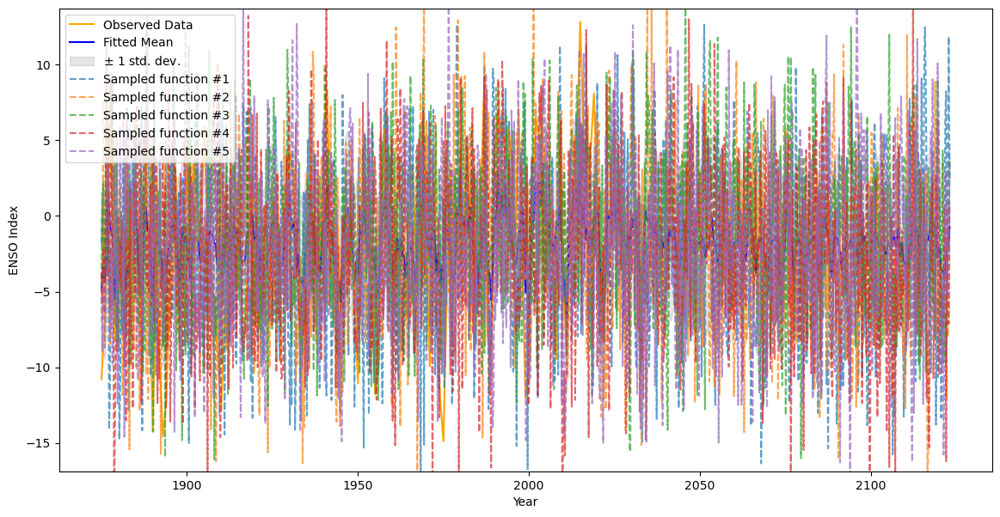

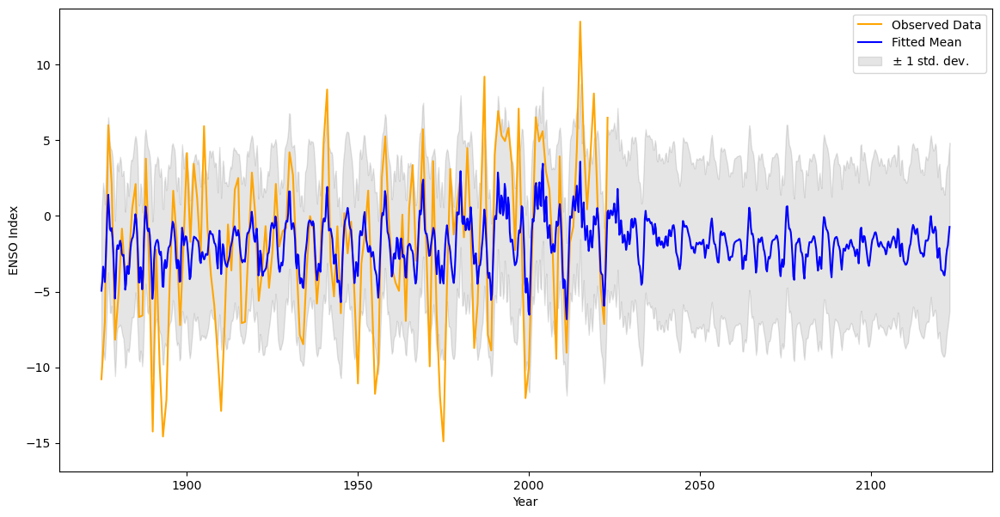

MSE: 15.740463016784934, RMSE: 3.9674252377058012, MAE: 3.2032429066491415, R2: 0.47688763161123804


In [65]:
# Define the kernel function with initial parameters
def create_kernel(degree, periods, rq_alpha, rbf_length, noise_level, constant1, constant2, constant3, constant4, nu):
    custom_poly_kernel = C(constant1, (1e-3, 1e3)) * CustomPolynomialKernel(degree=degree, periods=periods)
    combined_kernel = (
        C(constant2, (1e-3, 1e3)) * RQ(length_scale=1.0, alpha=rq_alpha, length_scale_bounds=(1e-2, 1e2), alpha_bounds=(1e-2, 1e2)) *
        RBF(length_scale=rbf_length, length_scale_bounds=(1e-2, 1e2)) +
        C(constant3, (1e-3, 1e3)) * Matern(length_scale=constant4, length_scale_bounds=(1e0, 1e2), nu=nu) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return custom_poly_kernel + combined_kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rq_alpha, rbf_length, noise_level, constant1, constant2, constant3, constant4, nu):
    kernel = create_kernel(2, [period1, period2, period3], rq_alpha, rbf_length, noise_level, constant1, constant2, constant3, constant4, nu)
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    
    # Transform X using the same transformation as during fitting
    custom_kernel = CustomPolynomialKernel(degree=2, periods=[period1, period2, period3])
    X_transformed = custom_kernel.periodic_transform(X)
    
    gp.fit(X_transformed, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rq_alpha': (1e-2, 1e2),
    'rbf_length': (1e-2, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'constant4': (1e-3, 1e3),
    'nu': (0.5, 2.5)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 150

with tqdm(total=total_iterations) as pbar:
    try:
        # Initial points for Bayesian optimization
        for _ in range(50):
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rq_alpha": np.random.uniform(1e-2, 1e2),
                    "rbf_length": np.random.uniform(1e-2, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant1": np.random.uniform(1e-3, 1e3),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "constant3": np.random.uniform(1e-3, 1e3),
                    "constant4": np.random.uniform(1e-3, 1e3),
                    "nu": np.random.uniform(0.5, 2.5)
                },
                lazy=True
            )
            pbar.update(1)

        # Initial points in maximize, iterations
        optimizer.maximize(
            init_points=20,
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rq_alpha=best_params['rq_alpha'], rbf_length=best_params['rbf_length'], noise_level=best_params['noise_level'],
    constant1=best_params['constant1'], constant2=best_params['constant2'], constant3=best_params['constant3'], constant4=best_params['constant4'], nu=best_params['nu']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X_transformed = custom_kernel.periodic_transform(X)

# Fit with optimized parameters
gp.fit(X_transformed, y)

# Ensure X_range includes the entire prediction range
X_range = (X.min(), X.max() + 100)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=X_range, ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()

# Evaluate the model
def evaluate_model(gp, X, y, custom_kernel):
    X_transformed = custom_kernel.periodic_transform(X)
    y_pred = gp.predict(X_transformed)
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, rmse, mae, r2

mse, rmse, mae, r2 = evaluate_model(gp, X, y, custom_kernel)

print(f"MSE: {mse}, RMSE: {rmse}, MAE: {mae}, R2: {r2}")


  0%|          | 0/150 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  |  period3  | rbf_le... | rbf_le... | rq_alpha  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  1        | -211.8    |  653.8    |  380.8    |  698.8    |  889.2    |  2.385    |  2.829    |  5.653    |  11.71    |  15.34    |  60.38    |  98.5     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  2        | -213.5    |  536.4    |  147.7    |  474.0    |  5.172    |  6.402    |  2.969    |  4.6      |  11.54    |  49.64    |  91.91    |  81.07    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  3        | -211.5    |  318.6    |  30.95    |  733.0    |  804.5    |  6.106    |  2.718    |  5.785    |  10.83    |  88.65    |  76.57    |  74.22    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  4        | -209.5    |  906.2    |  463.9    |  806.6    |  421.1    |  0.5918   |  3.525    |  6.262    |  9.259    |  87.58    |  44.38    |  19.57    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  5        | -211.5    |  95.45    |  28.3     |  26.19    |  447.1    |  6.322    |  3.783    |  4.417    |  11.3     |  65.35    |  60.75    |  97.34    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  6        | -207.2    |  436.3    |  668.3    |  691.4    |  630.7    |  3.605    |  3.572    |  5.73     |  11.29    |  37.05    |  99.05    |  46.39    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  7        | -212.8    |  746.6    |  404.0    |  848.3    |  432.7    |  0.3011   |  2.507    |  5.108    |  11.85    |  9.552    |  55.83    |  52.39    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  8        | -213.1    |  764.6    |  593.3    |  997.6    |  387.1    |  8.493    |  3.565    |  4.992    |  10.05    |  28.75    |  79.17    |  20.27    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  9        | -215.4    |  20.92    |  35.08    |  720.6    |  419.3    |  4.177    |  3.073    |  6.381    |  10.3     |  12.64    |  49.03    |  1.965    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  10       | -216.2    |  667.6    |  577.0    |  396.0    |  737.9    |  9.467    |  3.182    |  5.309    |  9.908    |  87.12    |  25.36    |  93.41    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  11       | -215.3    |  446.5    |  597.8    |  492.3    |  427.7    |  5.238    |  2.406    |  7.827    |  9.968    |  36.34    |  78.97    |  51.49    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


|  12       | -214.7    |  254.8    |  889.9    |  441.1    |  675.4    |  4.016    |  2.94     |  5.177    |  11.76    |  83.68    |  38.89    |  87.42    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  13       | -212.5    |  685.5    |  558.4    |  599.1    |  892.2    |  5.262    |  2.903    |  7.839    |  11.17    |  87.45    |  26.52    |  2.795    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  14       | -216.1    |  234.4    |  996.1    |  108.2    |  149.8    |  3.672    |  3.195    |  6.889    |  10.34    |  36.17    |  39.37    |  0.2823   |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packa

|  15       | -213.5    |  389.6    |  713.4    |  265.5    |  94.28    |  2.426    |  2.202    |  4.243    |  11.94    |  92.09    |  44.08    |  78.41    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  16       | -216.3    |  312.4    |  304.3    |  632.4    |  591.9    |  5.348    |  3.315    |  7.184    |  9.957    |  0.2759   |  98.3     |  33.54    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  17       | -214.9    |  828.3    |  336.6    |  34.72    |  409.2    |  1.787    |  3.472    |  6.422    |  10.8     |  59.73    |  41.72    |  16.59    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  18       | -215.1    |  555.4    |  442.6    |  471.1    |  384.4    |  9.127    |  2.709    |  4.831    |  9.346    |  13.2     |  2.689    |  29.29    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  19       | -213.1    |  34.59    |  300.1    |  121.5    |  767.7    |  2.124    |  3.076    |  6.775    |  11.65    |  28.56    |  86.56    |  76.91    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  20       | -214.2    |  956.4    |  547.6    |  47.68    |  914.2    |  1.086    |  2.062    |  4.442    |  9.199    |  73.15    |  1.579    |  43.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  21       | -212.8    |  85.26    |  140.5    |  653.7    |  528.8    |  1.327    |  2.429    |  5.022    |  9.873    |  0.108    |  76.18    |  80.36    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  22       | -215.3    |  878.1    |  787.5    |  952.9    |  365.8    |  8.877    |  3.48     |  6.84     |  10.27    |  97.23    |  83.14    |  82.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  23       | -210.5    |  751.4    |  102.9    |  475.9    |  942.8    |  8.279    |  2.689    |  5.13     |  10.53    |  48.26    |  84.85    |  10.82    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  24       | -213.7    |  639.5    |  125.1    |  119.0    |  288.9    |  7.896    |  2.616    |  4.747    |  9.339    |  60.17    |  31.45    |  49.6     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  25       | -215.5    |  990.0    |  202.1    |  668.2    |  197.8    |  0.1781   |  2.461    |  6.826    |  10.07    |  41.55    |  78.0     |  93.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  26       | -215.8    |  483.7    |  583.5    |  847.2    |  319.6    |  5.436    |  2.675    |  6.861    |  9.951    |  86.75    |  37.59    |  2.819    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  27       | -214.2    |  871.4    |  379.7    |  562.7    |  126.6    |  6.708    |  2.869    |  4.459    |  11.81    |  18.59    |  48.48    |  19.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  28       | -214.3    |  346.7    |  323.1    |  195.4    |  35.74    |  4.651    |  2.11     |  6.002    |  10.72    |  13.54    |  64.07    |  72.57    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  29       | -215.6    |  935.8    |  351.6    |  847.5    |  7.555    |  6.306    |  3.305    |  4.306    |  10.62    |  24.95    |  15.91    |  44.42    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  30       | -215.4    |  210.9    |  662.3    |  999.4    |  477.4    |  3.557    |  2.243    |  6.709    |  10.15    |  54.35    |  60.34    |  95.46    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  31       | -213.2    |  291.9    |  736.9    |  343.3    |  748.8    |  8.966    |  3.914    |  4.131    |  10.78    |  5.644    |  97.85    |  65.71    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  32       | -210.4    |  998.9    |  670.9    |  503.0    |  673.7    |  9.4      |  3.01     |  5.732    |  10.39    |  59.41    |  41.89    |  86.81    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  33       | -214.5    |  4.372    |  3.072    |  665.3    |  756.5    |  6.449    |  3.988    |  7.574    |  10.71    |  4.46     |  81.26    |  24.21    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  34       | -212.5    |  774.3    |  609.6    |  7.709    |  119.3    |  2.416    |  3.763    |  5.101    |  10.82    |  2.278    |  80.17    |  4.177    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  35       | -211.2    |  950.1    |  758.3    |  489.0    |  193.8    |  3.426    |  2.355    |  5.644    |  10.61    |  31.43    |  28.15    |  12.99    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  36       | -207.6    |  804.1    |  465.9    |  359.5    |  962.2    |  8.738    |  3.708    |  5.676    |  10.3     |  51.31    |  58.8     |  97.21    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  37       | -212.2    |  95.06    |  775.9    |  639.2    |  157.6    |  6.884    |  2.765    |  4.797    |  10.59    |  65.45    |  9.19     |  61.12    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  38       | -214.9    |  5.043    |  865.1    |  477.1    |  55.93    |  8.594    |  2.197    |  5.169    |  10.09    |  41.11    |  88.6     |  56.98    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  39       | -214.9    |  26.52    |  906.5    |  127.9    |  882.0    |  6.484    |  2.552    |  6.661    |  9.983    |  49.69    |  12.38    |  65.65    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  40       | -214.2    |  516.4    |  956.3    |  706.4    |  554.3    |  6.673    |  2.754    |  4.319    |  10.37    |  58.5     |  7.447    |  55.11    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  41       | -217.2    |  789.0    |  263.1    |  73.43    |  994.4    |  6.115    |  2.823    |  4.493    |  9.665    |  96.96    |  82.79    |  71.72    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  42       | -215.8    |  358.3    |  291.4    |  558.4    |  563.8    |  8.161    |  2.464    |  7.227    |  9.716    |  41.32    |  22.92    |  11.24    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  43       | -213.6    |  762.6    |  728.9    |  360.8    |  312.7    |  7.143    |  2.698    |  4.696    |  9.34     |  32.91    |  98.54    |  72.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__noise_level is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  44       | -213.8    |  87.53    |  292.3    |  136.8    |  918.6    |  7.146    |  2.006    |  6.374    |  11.89    |  54.36    |  59.33    |  33.8     |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  45       | -213.3    |  310.3    |  889.8    |  637.7    |  509.3    |  0.7323   |  3.585    |  5.146    |  9.964    |  17.37    |  58.42    |  72.68    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  46       | -213.2    |  406.0    |  549.2    |  275.6    |  281.1    |  7.28     |  3.779    |  6.831    |  11.67    |  27.86    |  76.3     |  5.059    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site

|  47       | -211.2    |  471.6    |  989.7    |  394.1    |  520.1    |  5.975    |  3.214    |  4.578    |  11.24    |  60.06    |  99.95    |  50.78    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  48       | -214.0    |  63.61    |  177.8    |  141.3    |  847.1    |  4.612    |  3.941    |  6.784    |  10.41    |  58.69    |  55.5     |  5.538    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  49       | -215.7    |  324.7    |  164.3    |  647.6    |  306.0    |  1.15     |  2.696    |  6.452    |  9.92     |  25.5     |  56.6     |  37.11    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\

|  50       | -208.9    |  655.9    |  587.5    |  958.1    |  785.9    |  1.619    |  2.748    |  5.234    |  11.35    |  87.56    |  73.09    |  55.55    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k2__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  51       | -213.2    |  417.0    |  720.3    |  0.1154   |  302.3    |  1.476    |  2.185    |  4.745    |  10.04    |  39.68    |  53.89    |  41.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  52       | -214.6    |  685.2    |  204.5    |  878.1    |  27.39    |  6.708    |  2.835    |  6.235    |  9.421    |  19.82    |  80.08    |  96.83    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  53       | -214.0    |  313.4    |  692.3    |  876.4    |  894.6    |  0.8596   |  2.078    |  4.679    |  11.63    |  9.844    |  42.12    |  95.79    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  54       | -214.7    |  533.2    |  691.9    |  315.5    |  686.5    |  8.348    |  2.037    |  7.001    |  11.97    |  74.82    |  28.05    |  78.93    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  55       | -214.6    |  103.2    |  447.9    |  908.6    |  293.6    |  2.885    |  2.26     |  4.077    |  11.04    |  21.17    |  26.56    |  49.16    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  56       | -207.5    |  53.36    |  574.1    |  146.7    |  589.3    |  7.001    |  2.205    |  5.656    |  11.08    |  41.42    |  5.005    |  53.59    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  57       | -211.6    |  663.8    |  514.9    |  944.6    |  586.6    |  9.035    |  2.275    |  4.557    |  11.42    |  39.77    |  16.54    |  92.75    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  58       | -215.5    |  347.8    |  750.8    |  726.0    |  883.3    |  6.24     |  3.502    |  5.396    |  9.81     |  89.59    |  42.81    |  96.48    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  59       | -212.0    |  663.4    |  621.7    |  114.7    |  949.5    |  4.505    |  3.157    |  5.633    |  9.711    |  90.34    |  57.37    |  0.297    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  60       | -213.0    |  617.1    |  326.6    |  527.1    |  885.9    |  3.579    |  3.817    |  6.493    |  9.047    |  92.94    |  69.09    |  99.73    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  61       | -213.2    |  172.3    |  137.1    |  932.6    |  696.8    |  0.6693   |  3.511    |  7.016    |  11.77    |  71.16    |  12.44    |  1.998    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  62       | -213.9    |  26.21    |  28.31    |  246.2    |  860.0    |  5.393    |  3.106    |  7.368    |  9.373    |  27.93    |  58.58    |  96.96    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  63       | -211.2    |  561.0    |  18.65    |  800.6    |  233.0    |  8.073    |  2.776    |  7.454    |  11.24    |  55.63    |  13.65    |  6.001    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  64       | -212.5    |  121.3    |  44.55    |  107.5    |  225.7    |  7.133    |  3.119    |  4.05     |  9.216    |  96.73    |  56.81    |  20.34    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\sit

|  65       | -214.1    |  252.3    |  743.8    |  195.4    |  581.4    |  9.7      |  3.694    |  4.959    |  10.48    |  62.0     |  82.9     |  15.69    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  66       | -214.6    |  18.58    |  70.02    |  486.3    |  606.3    |  5.693    |  2.635    |  7.954    |  10.74    |  38.02    |  55.1     |  74.54    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  67       | -212.0    |  669.2    |  264.9    |  66.34    |  370.1    |  6.301    |  2.42     |  7.011    |  9.2      |  26.04    |  80.48    |  19.35    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


|  68       | -214.1    |  639.5    |  524.7    |  924.8    |  263.3    |  0.669    |  3.47     |  7.089    |  11.72    |  93.2     |  1.405    |  23.44    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k2__alpha is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packag

|  69       | -212.7    |  616.8    |  949.0    |  950.2    |  556.7    |  9.157    |  3.283    |  5.56     |  10.46    |  60.44    |  54.96    |  92.62    |


d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__k1__k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
 33%|███▎      | 50/150 [19:36<39:12, 23.52s/it]

|  70       | -214.2    |  918.7    |  394.9    |  963.3    |  174.0    |  1.272    |  2.27     |  6.023    |  9.065    |  94.8     |  82.71    |  1.512    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters: {'constant1': 436.25839628887746, 'constant2': 668.2821243992203, 'constant3': 691.4353442098989, 'constant4': 630.6810382183246, 'noise_level': 3.6047262012988273, 'period1': 3.5718329224501564, 'period2': 5.730277322633452, 'period3': 11.285839470950211, 'rbf_length1': 37.054266955042145, 'rbf_length2': 99.0541398259521, 'rq_alpha': 46.39221207550558}
Best parameters: {'constant1': 436.25839628887746, 'constant2': 668.2821243992203, 'constant3': 691.4353442098989, 'constant4': 630.6810382183246, 'noise_level': 3.6047262012988273, 'period1': 3.5718329224501564, 'period2': 5.730277322633452, 'period3': 11.285839470950211, 'rbf_length1': 37.054266955042145, 'rbf_length2': 99.0541398259521, 'rq_alpha': 46.39221207550558}



d:\APPsetup\anaconda\envs\rd\lib\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


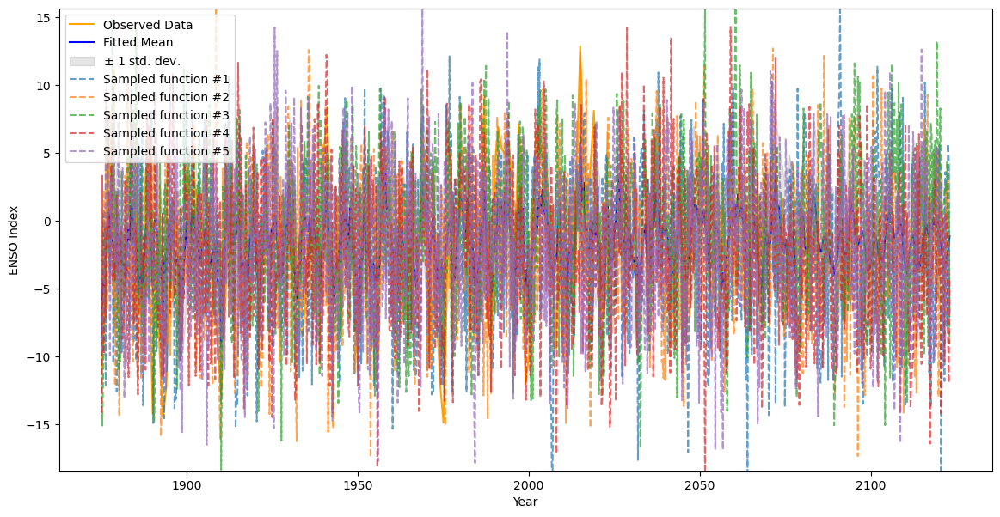

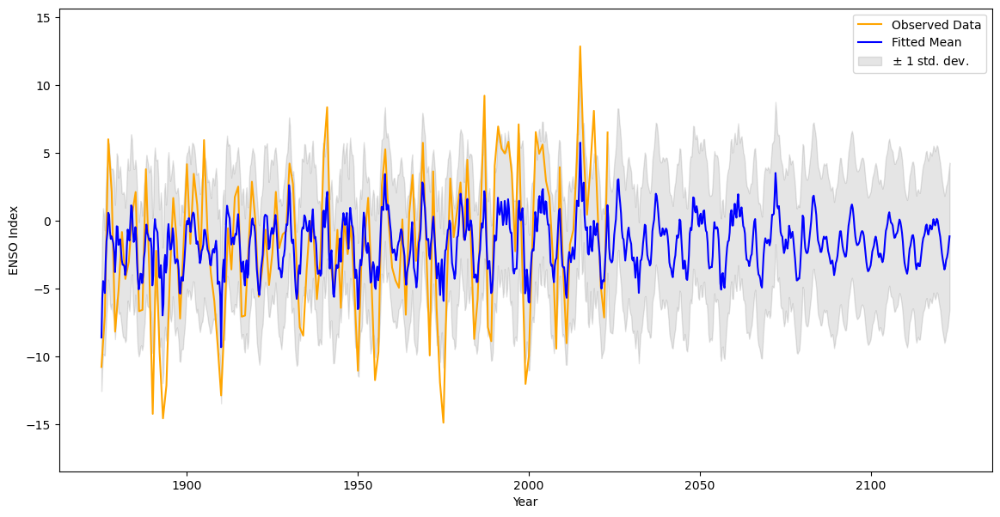

MSE: 3.3191865088720354, RMSE: 1.8218634715236033, MAE: 1.493114609891264, R2: 0.8896914586357113


In [66]:
# Define the kernel function with initial parameters
def create_kernel(degree, periods, rq_alpha, rbf_length1, rbf_length2, noise_level, constant1, constant2, constant3, constant4):
    custom_poly_kernel = C(constant1, (1e-3, 1e3)) * CustomPolynomialKernel(degree=degree, periods=periods)
    combined_kernel = (
        C(constant2, (1e-3, 1e3)) * RQ(length_scale=1.0, alpha=rq_alpha, length_scale_bounds=(1e-2, 1e2), alpha_bounds=(1e-2, 1e2)) * 
        RBF(length_scale=rbf_length1, length_scale_bounds=(1e-2, 1e2)) +
        C(constant3, (1e-3, 1e3)) * RBF(length_scale=rbf_length2, length_scale_bounds=(1e-2, 1e2)) +
        WhiteKernel(noise_level=noise_level, noise_level_bounds=(1e-2, 1e1))
    )
    return custom_poly_kernel + combined_kernel

# Define the objective function for Bayesian optimization
def objective(period1, period2, period3, rq_alpha, rbf_length1, rbf_length2, noise_level, constant1, constant2, constant3, constant4):
    kernel = create_kernel(2, [period1, period2, period3], rq_alpha, rbf_length1, rbf_length2, noise_level, constant1, constant2, constant3, constant4)
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)
    
    # Transform X using the same transformation as during fitting
    custom_kernel = CustomPolynomialKernel(degree=2, periods=[period1, period2, period3])
    X_transformed = custom_kernel.periodic_transform(X)
    
    gp.fit(X_transformed, y)
    return gp.log_marginal_likelihood()

# Define the parameter bounds for Bayesian optimization
pbounds = {
    'period1': (2.0, 4.0),
    'period2': (4.0, 8.0),
    'period3': (9.0, 12.0),
    'rq_alpha': (1e-2, 1e2),
    'rbf_length1': (1e-2, 1e2),
    'rbf_length2': (1e-2, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'constant4': (1e-3, 1e3)
}

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=objective,
    pbounds=pbounds,
    random_state=1
)

# Set the utility function
utility = UtilityFunction(kind="ei", kappa=2.5, xi=0.01)

# Define a progress bar for the optimization process
total_iterations = 150

with tqdm(total=total_iterations) as pbar:
    try:
        # Initial points for Bayesian optimization
        for _ in range(50):
            optimizer.probe(
                params={
                    "period1": np.random.uniform(2.0, 4.0),
                    "period2": np.random.uniform(4.0, 8.0),
                    "period3": np.random.uniform(9.0, 12.0),
                    "rq_alpha": np.random.uniform(1e-2, 1e2),
                    "rbf_length1": np.random.uniform(1e-2, 1e2),
                    "rbf_length2": np.random.uniform(1e-2, 1e2),
                    "noise_level": np.random.uniform(1e-2, 1e1),
                    "constant1": np.random.uniform(1e-3, 1e3),
                    "constant2": np.random.uniform(1e-3, 1e3),
                    "constant3": np.random.uniform(1e-3, 1e3),
                    "constant4": np.random.uniform(1e-3, 1e3)
                },
                lazy=True
            )
            pbar.update(1)

        # Initial points in maximize, iterations
        optimizer.maximize(
            init_points=20,
            n_iter=total_iterations - 50,
            acq="ei",
            xi=0.01
        )

    except Exception as e:
        print("An error occurred during optimization:", e)
        best_params = optimizer.max['params']
        print(f"Best parameters: {best_params}")

# Get the best parameters
best_params = optimizer.max['params']
print(f"Best parameters: {best_params}")

# Create the best kernel with optimized parameters
kernel = create_kernel(
    degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']],
    rq_alpha=best_params['rq_alpha'], rbf_length1=best_params['rbf_length1'], rbf_length2=best_params['rbf_length2'], noise_level=best_params['noise_level'],
    constant1=best_params['constant1'], constant2=best_params['constant2'], constant3=best_params['constant3'], constant4=best_params['constant4']
)
gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, normalize_y=True)

# Transform X using the same transformation as during fitting
custom_kernel = CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
X_transformed = custom_kernel.periodic_transform(X)

# Fit with optimized parameters
gp.fit(X_transformed, y)


# Ensure X_range includes the entire prediction range
X_range = (X.min(), X.max() + 100)

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=5, X_range=X_range, ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(14, 7))
plot_gpr_samples(gp, X, y, custom_kernel, periods=[best_params['period1'], best_params['period2'], best_params['period3']], n_samples=0, X_range=X_range, ax=ax)
plt.show()

# Evaluate the model
def evaluate_model(gp, X, y, custom_kernel):
    X_transformed = custom_kernel.periodic_transform(X)
    y_pred = gp.predict(X_transformed)
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, rmse, mae, r2

mse, rmse, mae, r2 = evaluate_model(gp, X, y, custom_kernel)

print(f"MSE: {mse}, RMSE: {rmse}, MAE: {mae}, R2: {r2}")


In [67]:
lml = gp.log_marginal_likelihood()
print("Log Marginal Likelihood: ", lml)

Log Marginal Likelihood:  -207.151915557194
